In [1]:
#!pip install bayesian-optimization  # for google collab
#!pip install git+https://github.com/slremy/netsapi --user --upgrade


In [2]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import mlab
from matplotlib import gridspec
%matplotlib inline

In [3]:
#challenge import
from netsapi.challenge import *
 
from sys import exit, exc_info, argv
from multiprocessing import Pool, current_process
import random as rand
import json
import requests
import numpy as np
import pandas as pd


import statistics
from IPython.display import clear_output

from contextlib import contextmanager
import sys, os
@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
print("done")

done


In [4]:
envSeqDec = ChallengeProveEnvironment()
x_start = 0.0
x_end = 1.0

VAL_Max = 1.2 # fel heat map

def target1(x, y):
    x = np.asscalar(x)
    y = np.asscalar(y)
    envSeqDec.reset()
    action = [x , y]
    print("action",action)
    s,r,d,_ = envSeqDec.evaluateAction(action)
    return r/90.0    

def target(x,y):
    if type(x) is np.ndarray:
        result = []
        for a,b in zip(x,y):
            reward = target1(a,b)
            result.append( reward )
            #print((len(result) % 30 ) )
            #if ((len(result) % 30 ) > 25) : 
            #    global envSeqDec
            #    envSeqDec = ChallengeSeqDecEnvironment()
        return result
    else:
        return target1(x,y)


In [5]:
# for the training
n = 1e5
x = y = np.linspace(x_start, x_end, 300)# was 300
X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]

In [6]:
def posterior(bo, X):
    #ur = unique_rows(bo.X)
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    y_obs = np.array([res["target"] for res in bo.res])
    
    bo._gp.fit(x_obs, y_obs)
    
    mu, sigma = bo._gp.predict(X, return_std=True)
    return mu, sigma

def plot_2d(name=None):

    #mu, s, ut = posterior(bo, X)
    mu, s = posterior(bo, X)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10))
    gridsize=150

    # fig.suptitle('Bayesian Optimization in Action', fontdict={'size':30})
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    # GP regression output
    ax[0][0].set_title('Gausian Process Predicted Mean; max='+str(round(np.amax(mu)*90,0))+" min="+str(round(np.amin(mu)*90,0)), fontdict={'size':15})
    im00 = ax[0][0].hexbin(x, y, C=mu, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][0].axis([x.min(), x.max(), y.min(), y.max()])
    ax[0][0].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k', label='Observations')

    ax[0][1].set_title('Target Function', fontdict={'size':15})
    """
    im10 = ax[0][1].hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][1].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][1].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k')
    ax[0][1].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k')
    """

    ax[1][0].set_title('Gausian Process Variance', fontdict={'size':15})
    im01 = ax[1][0].hexbin(x, y, C=s, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=1)
    ax[1][0].axis([x.min(), x.max(), y.min(), y.max()])

    ax[1][1].set_title('Acquisition Function', fontdict={'size':15})
    # acquisition func
    """
    im11 = ax[1][1].hexbin(x, y, C=ut, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=8)

    np.where(ut.reshape((300, 300)) == ut.max())[0]
    np.where(ut.reshape((300, 300)) == ut.max())[1]

    ax[1][1].plot([np.where(ut.reshape((300, 300)) == ut.max())[1]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[1]/50.], 
                  [0, 6], 
                  'k-', lw=2, color='k')

    ax[1][1].plot([0, 6],
                  [np.where(ut.reshape((300, 300)) == ut.max())[0]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[0]/50.], 
                  'k-', lw=2, color='k')

    ax[1][1].axis([x.min(), x.max(), y.min(), y.max()])
    """
    for im, axis in zip([im00, im01], ax.flatten()):#, im10, im11
        cb = fig.colorbar(im, ax=axis)
        # cb.set_label('Value')

    if name is None:
        name = '_'

    plt.tight_layout()

    # Save or show figure?
    # fig.savefig('bo_eg_' + name + '.png')
    plt.show()
    plt.close(fig)


|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4504818798068265, 0.037285927666941165]
105  Evaluations Remaining
|  1        | -0.1986   |  0.4505   |  0.03729  |
action [0.7934952888365112, 0.7721216412935505]
104  Evaluations Remaining
|  2        |  0.2013   |  0.7935   |  0.7721   |
action [0.17515555048101095, 0.8052587774953637]
103  Evaluations Remaining
|  3        |  0.3009   |  0.1752   |  0.8053   |
action [0.11233416714405864, 0.6779850411135503]
102  Evaluations Remaining
|  4        | -0.7838   |  0.1123   |  0.678    |
action [0.37442990908533447, 0.6945527579107048]
101  Evaluations Remaining
|  5        | -0.3064   |  0.3744   |  0.6946   |


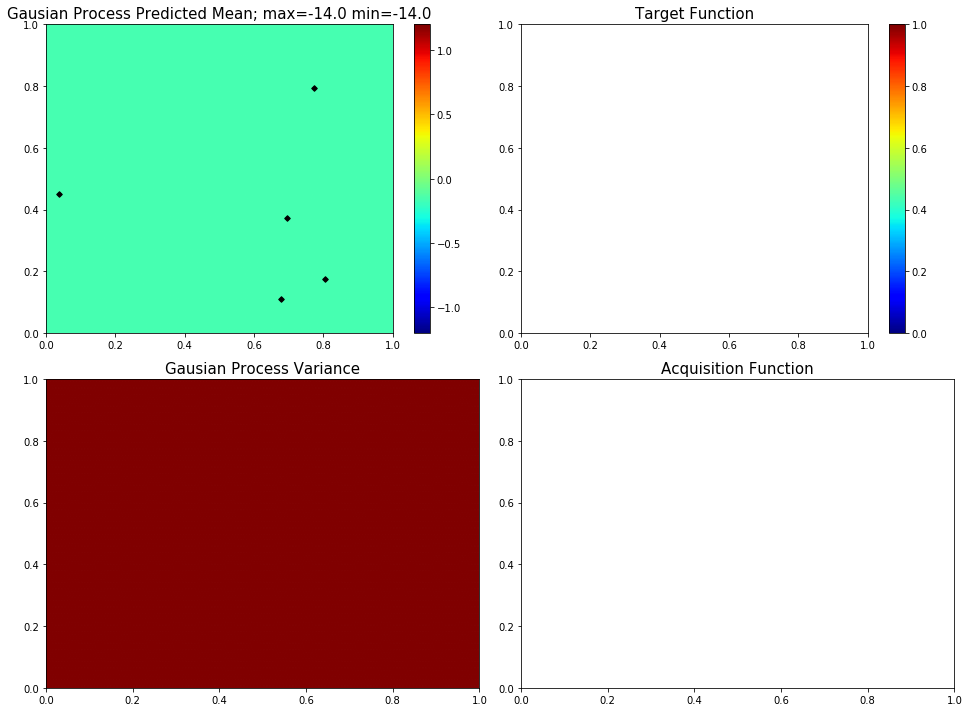

In [7]:
bo = BayesianOptimization(target, {'x': (x_start, x_end), 'y': (x_start, x_end)})

used_kappa = 10

bo.maximize(init_points=5, n_iter=0, acq='ucb', kappa=used_kappa)

plot_2d()

In [8]:
from math import sqrt
def invRL(policy):
    old_policy = [0.0, 0.0]
    seq = [] # 0.0
    for year in range(5):
        trans_policy = policy[year]
        trans_policy[0] *= (1.0 - old_policy[0])
        trans_policy[1] *= (1.0 - old_policy[1])

        r_mu, r_sigma = bo._gp.predict([trans_policy], return_std=True)
        print("invRL y", year+1 , ": ",round(r_mu[0]*90.0)," +- ", round(sqrt(r_sigma[0]*90.0) ) ) # ben lezem +- el racine bte3ha
        old_policy = policy[year]
        seq.append(r_mu*90) 
    return seq, np.sum(seq)


def testHolePolicy(policy):
    global envSeqDec
    envSeqDec.reset()
    year=0
    tot=0.0
    seq=[]
    while True:
        action =  policy[year]
        nextstate, reward, done, _ = envSeqDec.evaluateAction(list(action))
        print("test y", year+1 , ": ",round(reward))
        seq.append(reward)
        tot += reward
        if done:
            break
        year+=1
    return seq,tot

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8583646441533073, 0.37349305718348835]
100  Evaluations Remaining
|  6        | -0.01063  |  0.8584   |  0.3735   |
myplot:  006


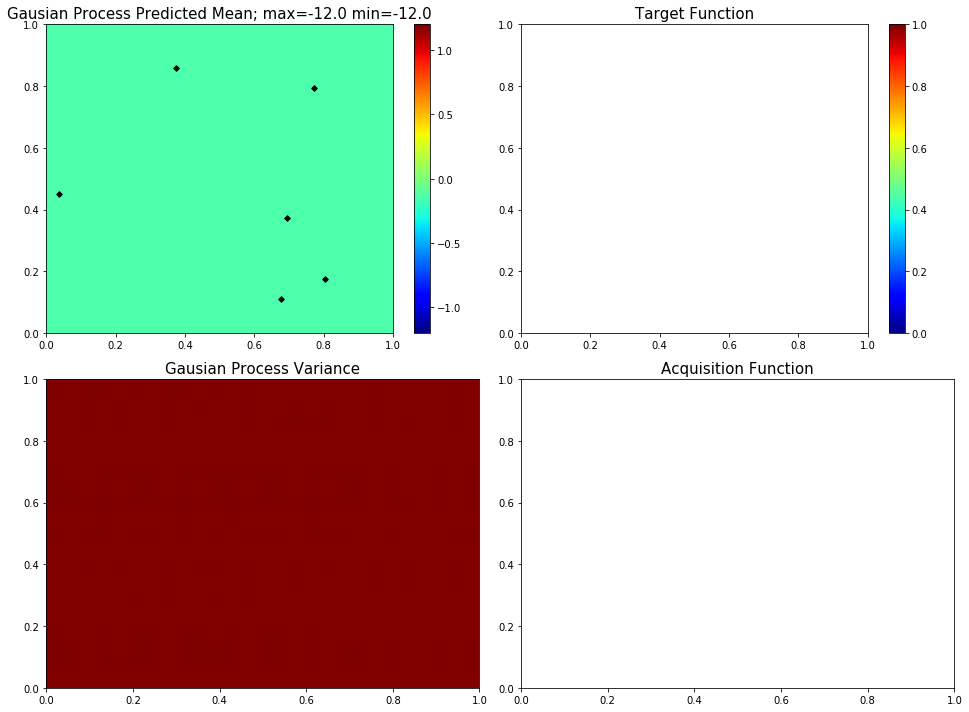

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.03424699537497922, 0.6901728311294483]
99  Evaluations Remaining
|  7        | -0.7216   |  0.03425  |  0.6902   |
myplot:  007


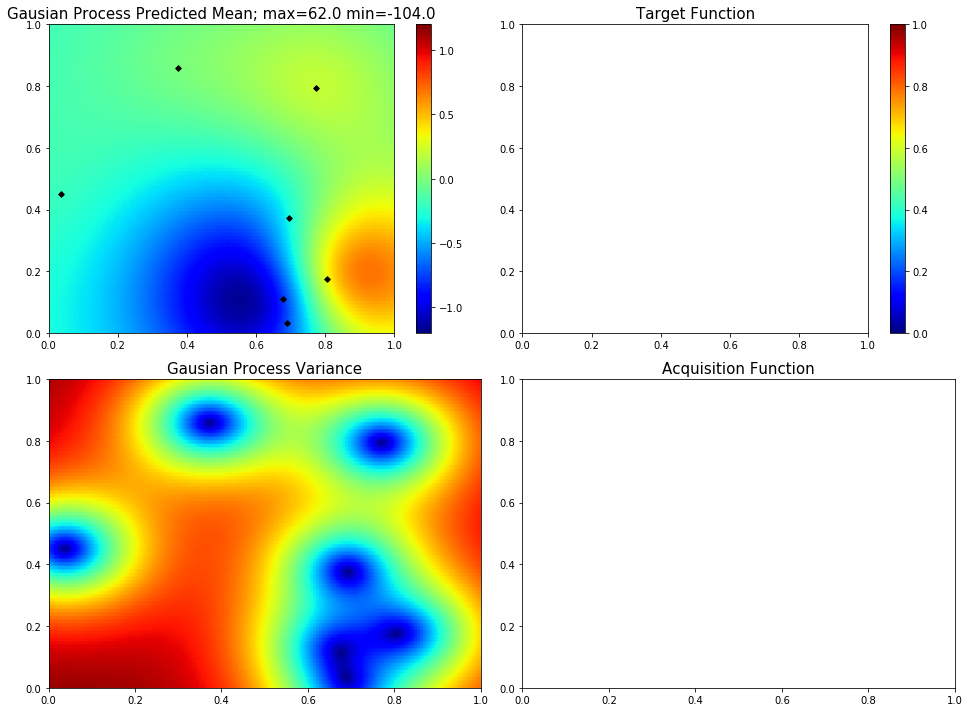

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.0]
98  Evaluations Remaining
|  8        |  0.5393   |  0.0      |  0.0      |
myplot:  008


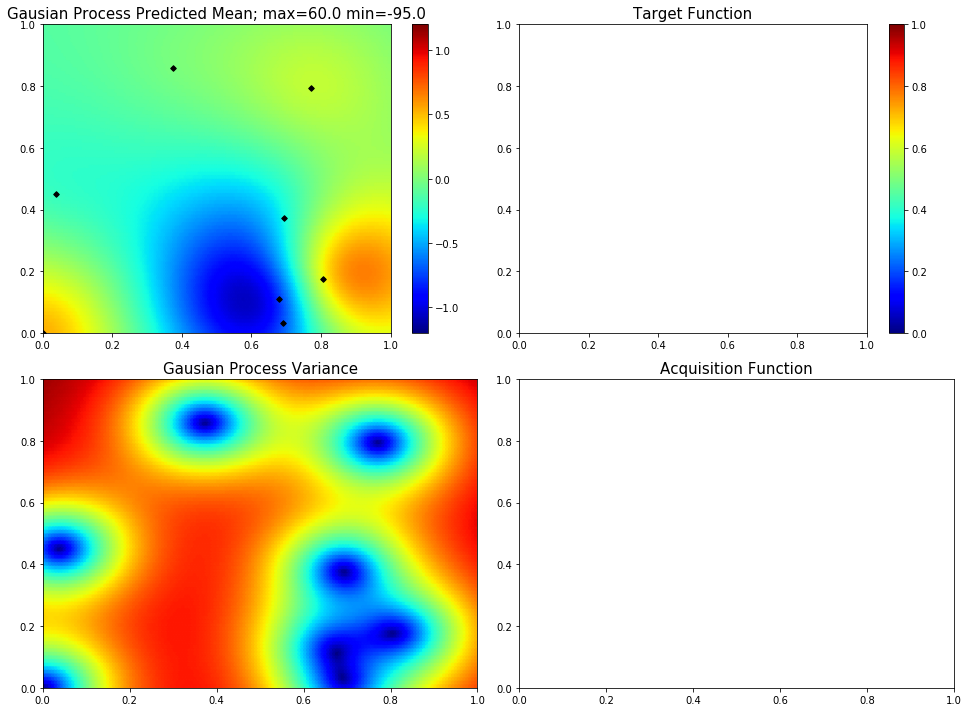

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.0]
97  Evaluations Remaining
|  9        |  0.2484   |  1.0      |  0.0      |
myplot:  009


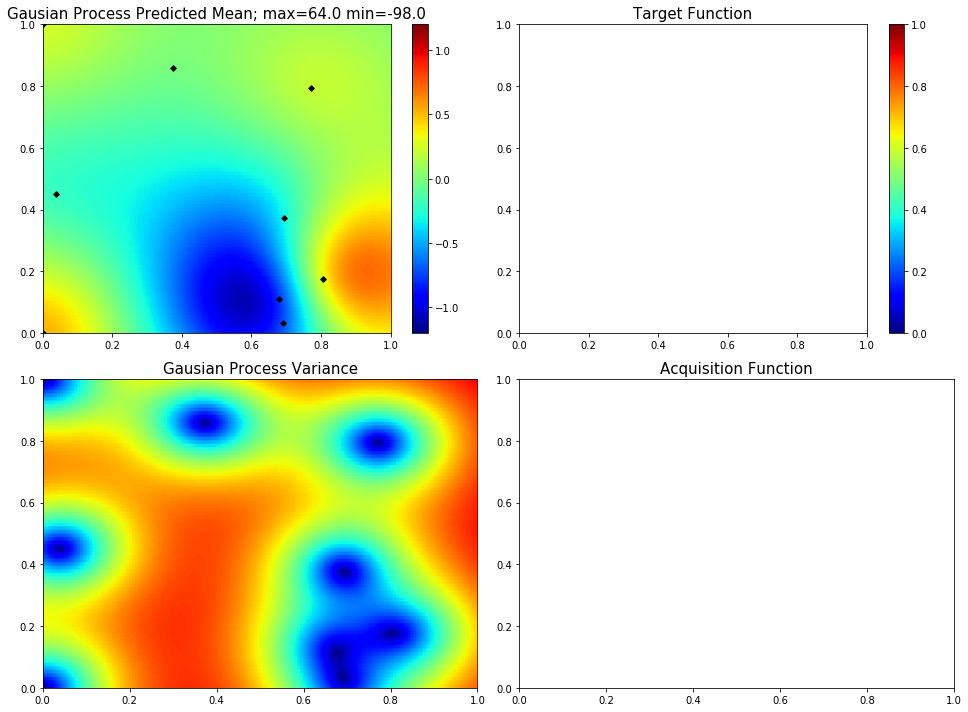

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 1.0]
96  Evaluations Remaining
|  10       | -0.0369   |  1.0      |  1.0      |
myplot:  010


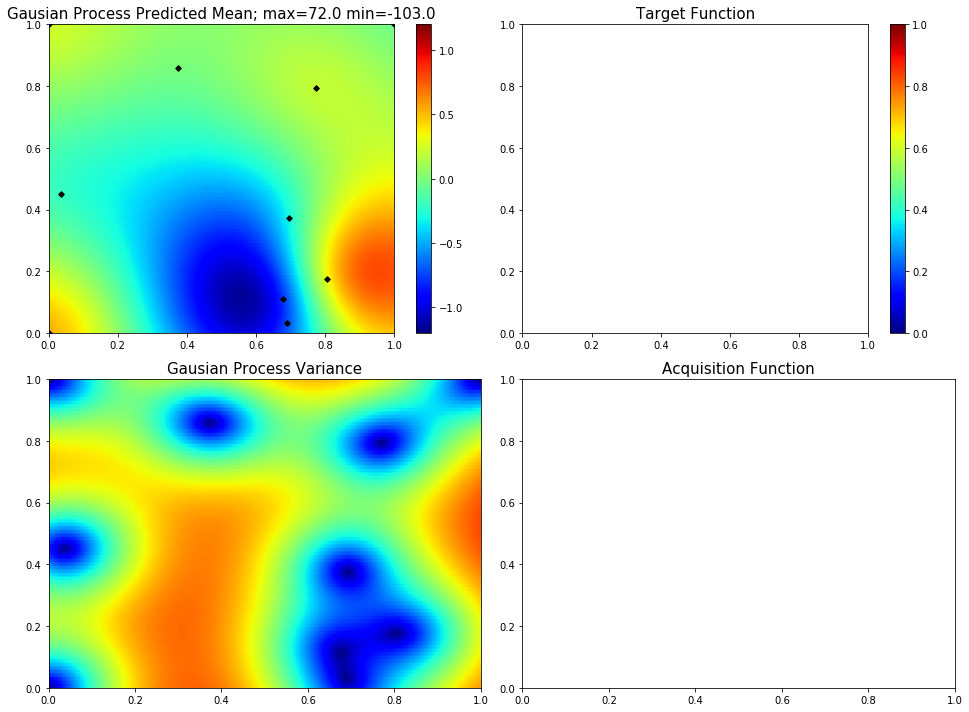

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5072621495531504, 1.0]
95  Evaluations Remaining
|  11       |  0.3604   |  0.5073   |  1.0      |
myplot:  011


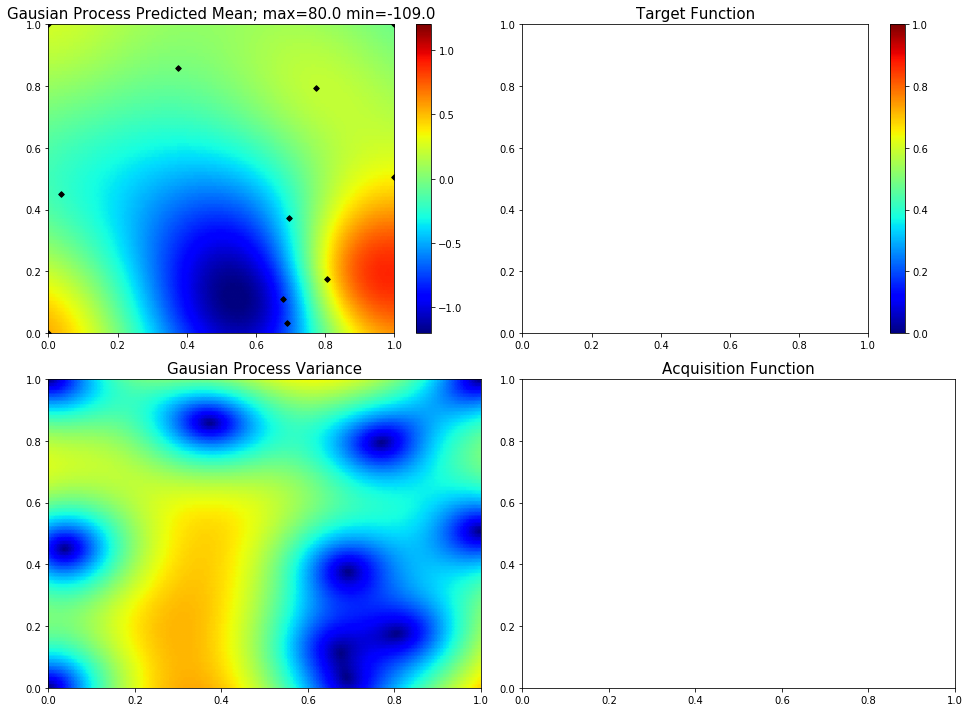

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 1.0]
94  Evaluations Remaining
|  12       |  1.043    |  0.0      |  1.0      |
myplot:  012


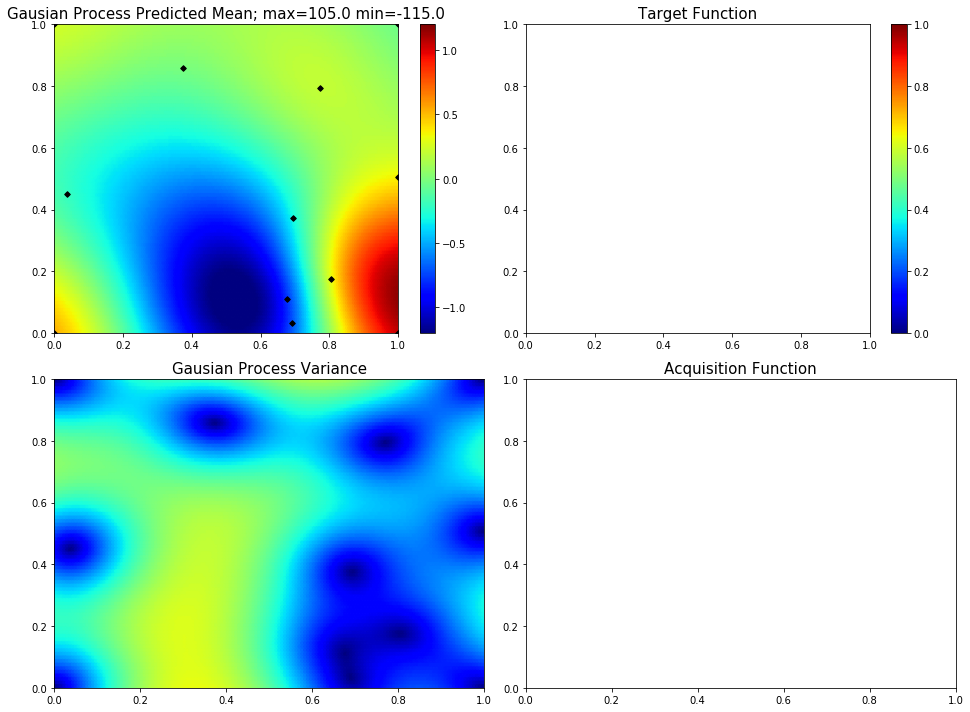

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.2918724848074757]
93  Evaluations Remaining
|  13       | -0.01432  |  0.0      |  0.2919   |
myplot:  013


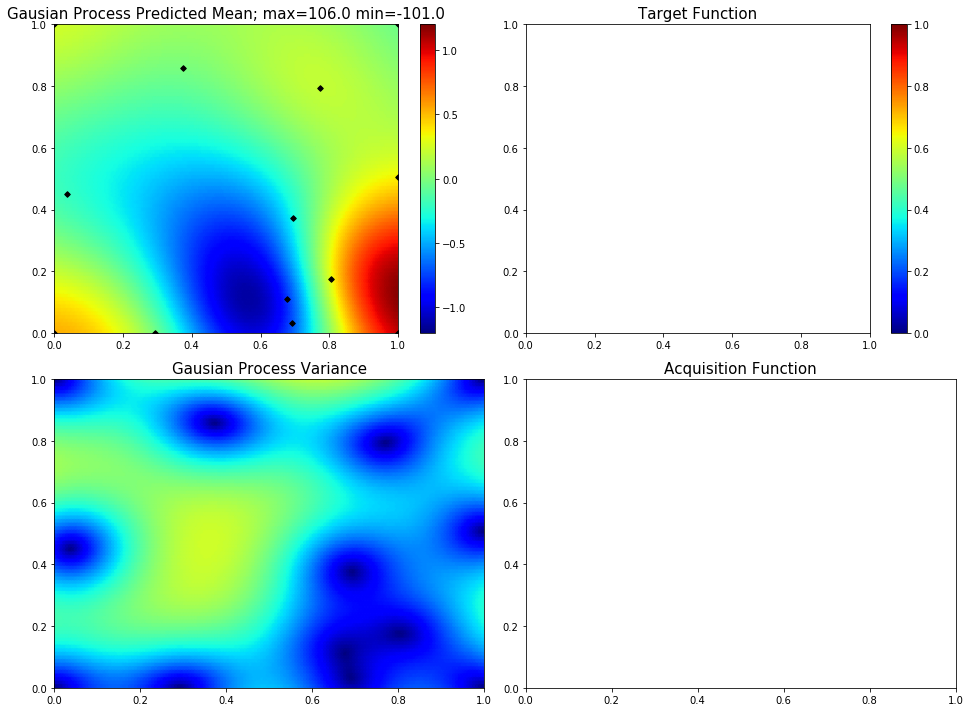

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.6144415034674113]
92  Evaluations Remaining
|  14       |  0.1141   |  1.0      |  0.6144   |
myplot:  014


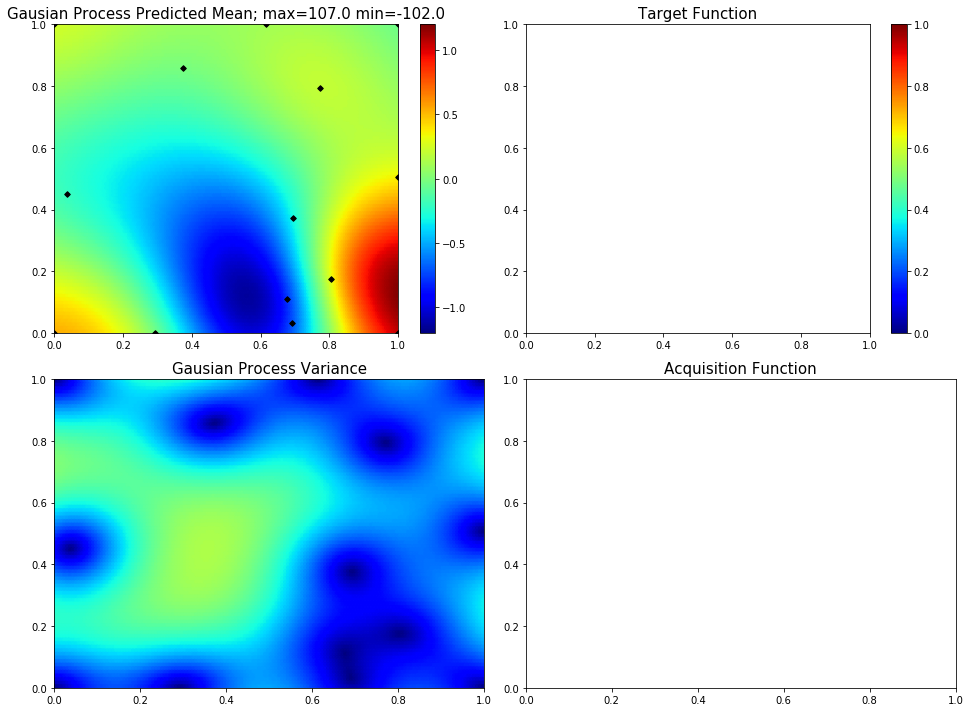

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.48909725063771964, 0.35342461972881956]
91  Evaluations Remaining
|  15       | -0.364    |  0.4891   |  0.3534   |
myplot:  015


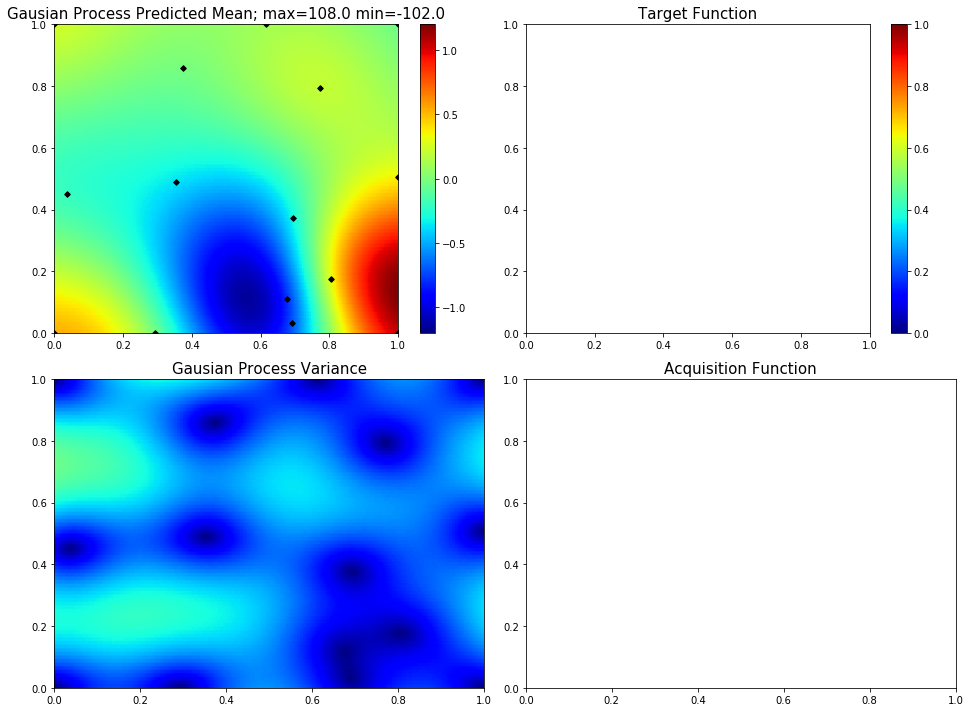

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.733726336375632, 0.0]
90  Evaluations Remaining
|  16       | -0.1371   |  0.7337   |  0.0      |
myplot:  016


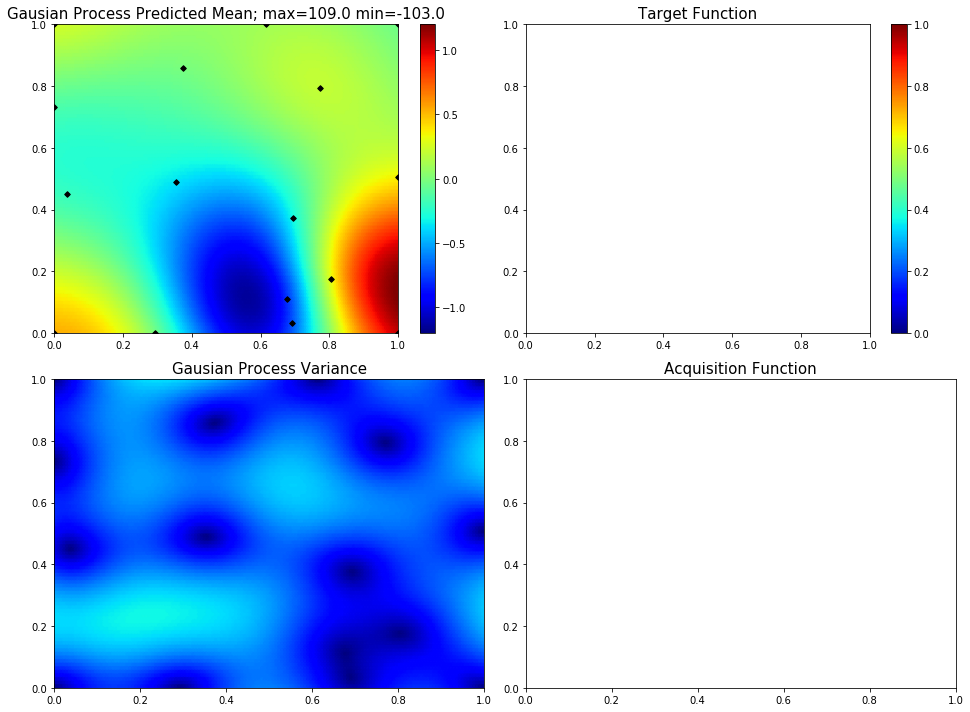

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.24329058619472382, 1.0]
89  Evaluations Remaining
|  17       |  3.258    |  0.2433   |  1.0      |
myplot:  017


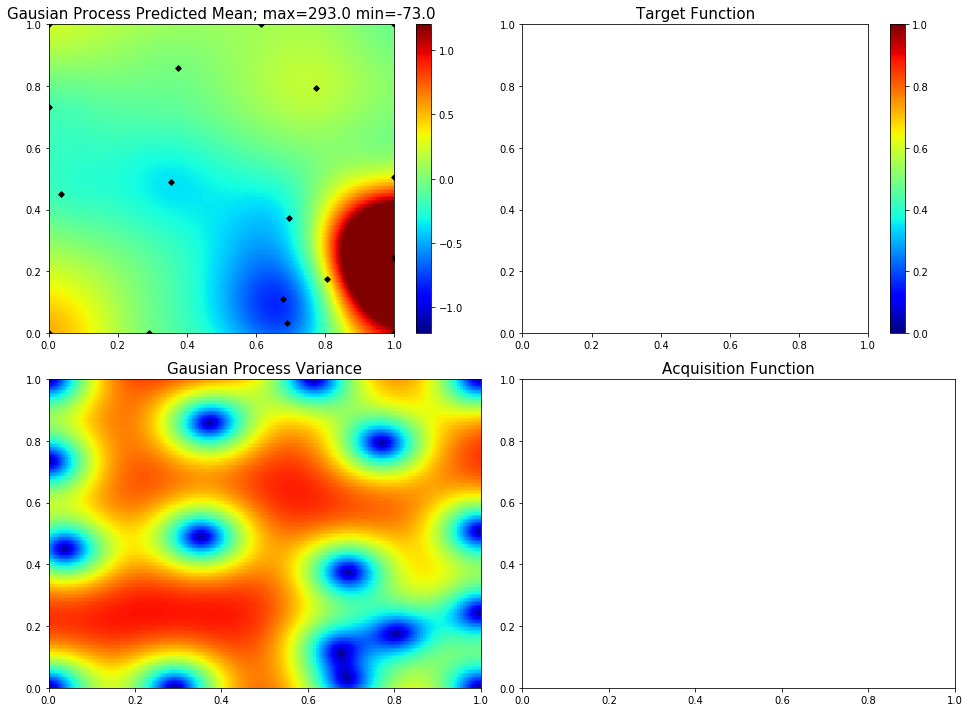

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.22891290258973793, 0.17942670896423293]
88  Evaluations Remaining
|  18       |  0.2881   |  0.2289   |  0.1794   |
myplot:  018


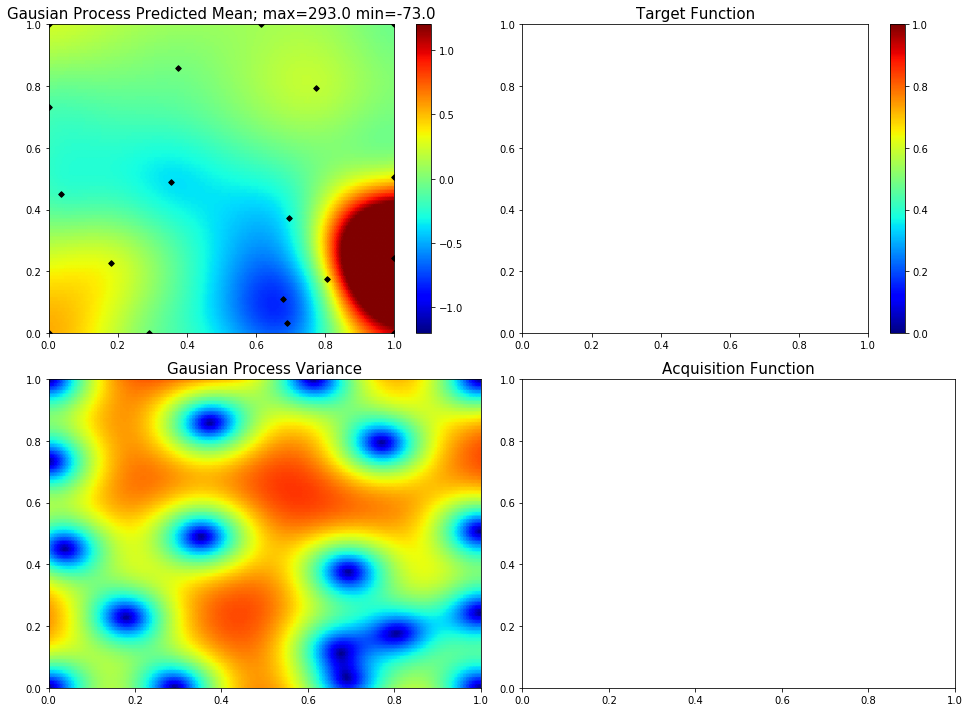

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6503701579554598, 0.5705692673401972]
87  Evaluations Remaining
|  19       | -0.001736 |  0.6504   |  0.5706   |
myplot:  019


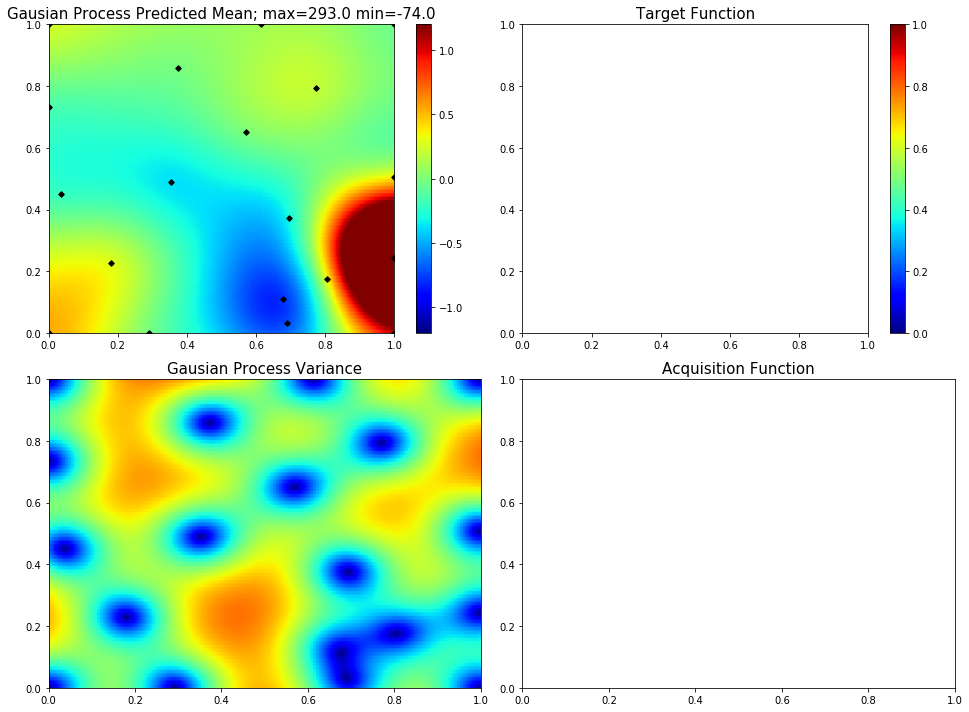

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.22685048954373513]
86  Evaluations Remaining
|  20       |  0.08779  |  1.0      |  0.2269   |
myplot:  020


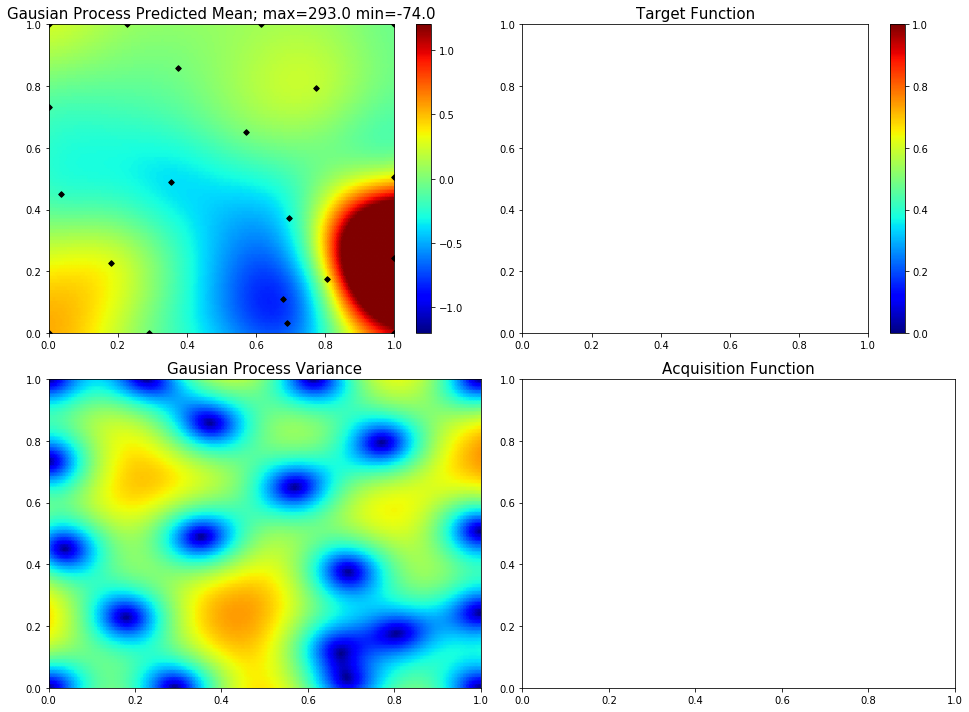

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7553640184427293, 1.0]
85  Evaluations Remaining
|  21       |  0.07737  |  0.7554   |  1.0      |
myplot:  021


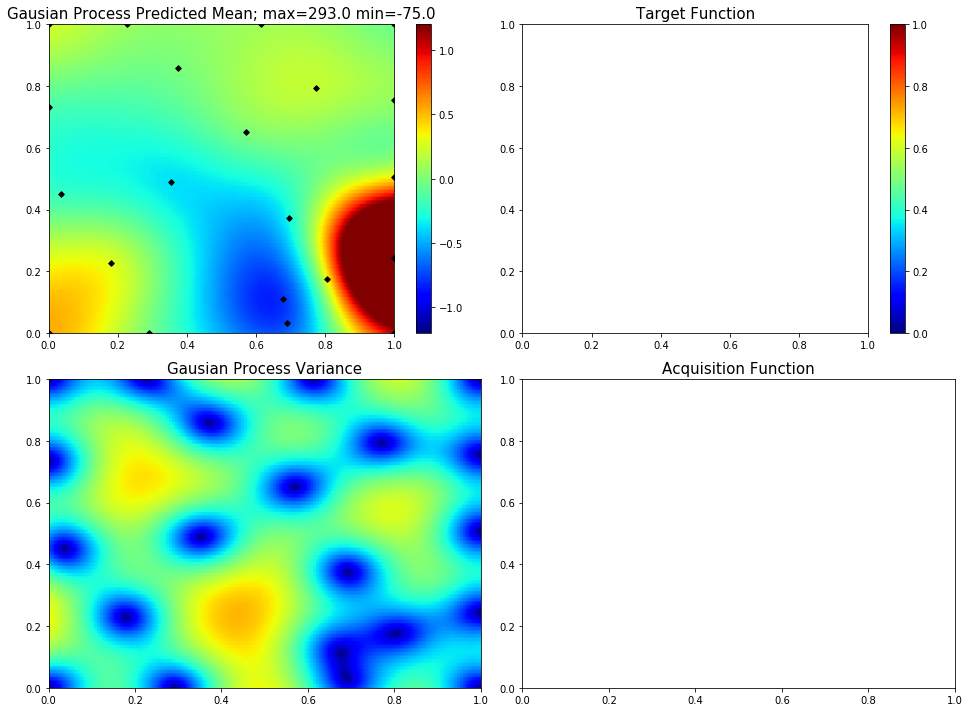

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.23383729255763408, 0.42480731977117986]
84  Evaluations Remaining
|  22       | -0.1546   |  0.2338   |  0.4248   |
myplot:  022


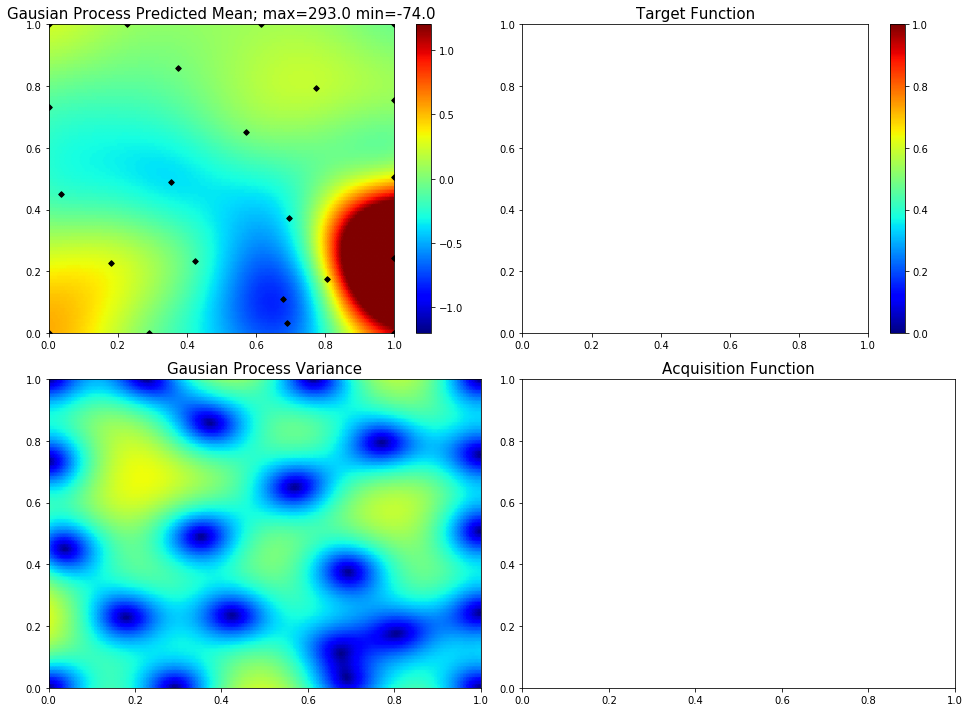

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.21833404173490004, 0.0]
83  Evaluations Remaining
|  23       |  0.1954   |  0.2183   |  0.0      |
myplot:  023


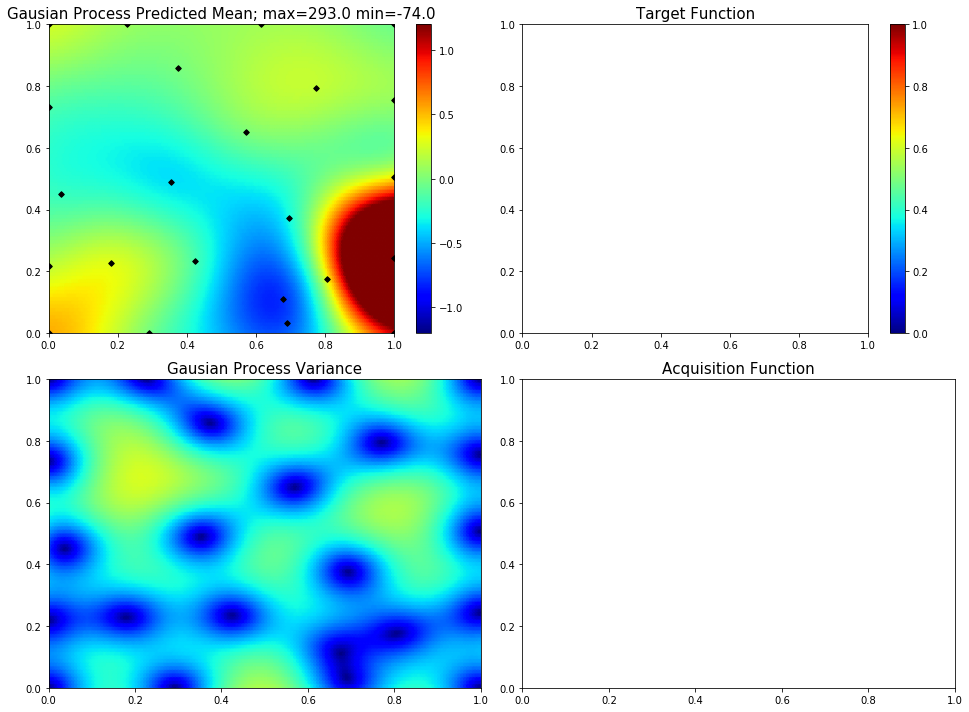

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6919783558515108, 0.21616401245866107]
82  Evaluations Remaining
|  24       | -0.2144   |  0.692    |  0.2162   |
myplot:  024


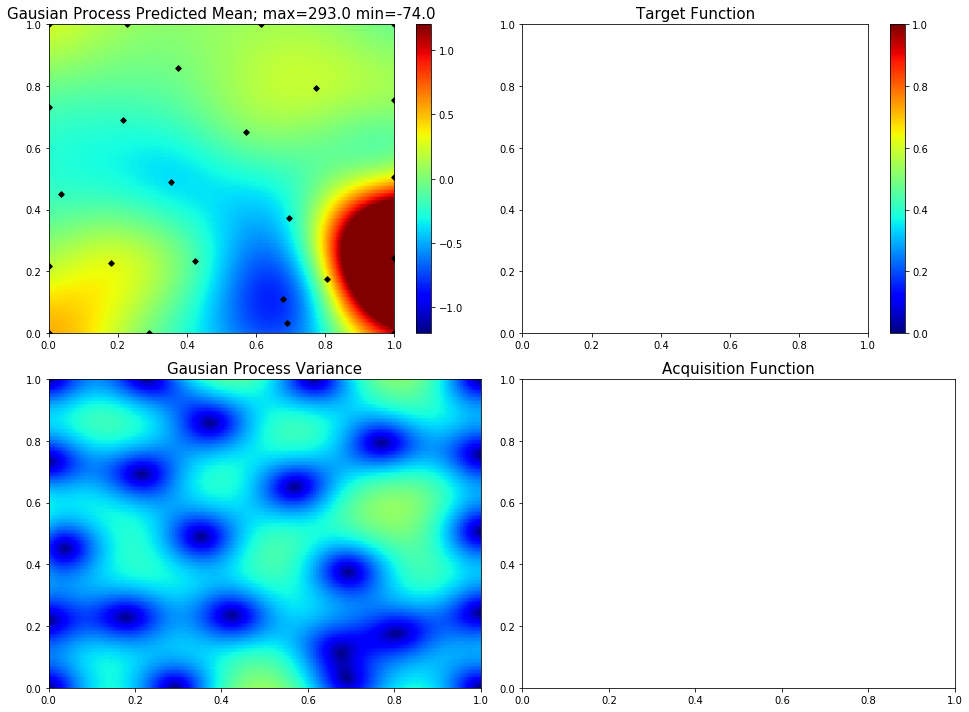

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.34164192408276606, 0.9202967903773542]
81  Evaluations Remaining
|  25       |  2.542    |  0.3416   |  0.9203   |
myplot:  025


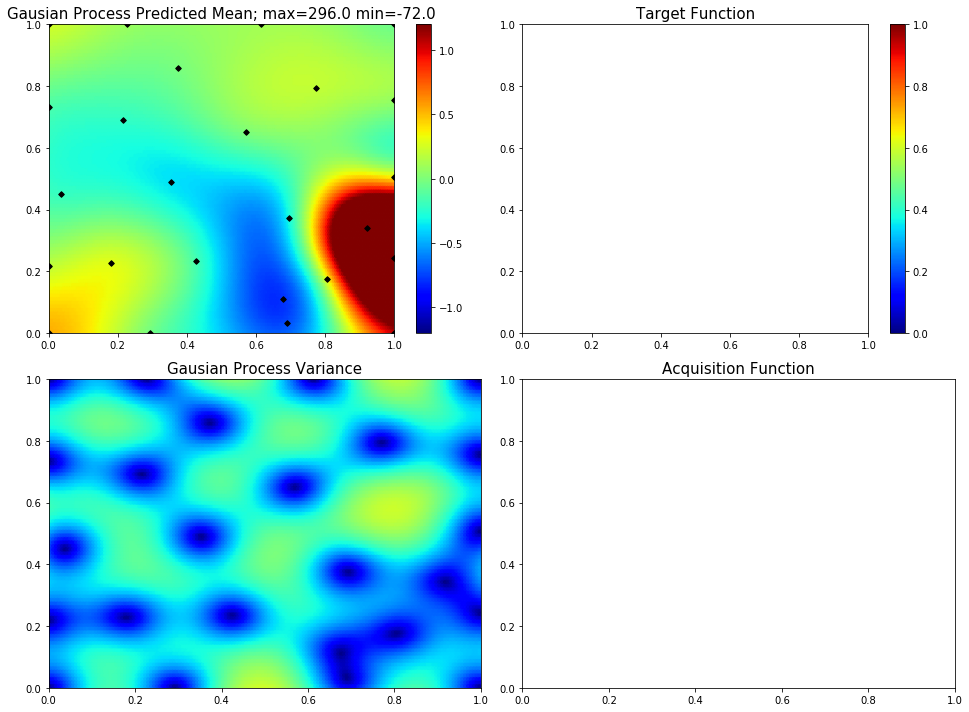

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5717427608097992, 0.8003872946328068]
80  Evaluations Remaining
|  26       |  0.02653  |  0.5717   |  0.8004   |
myplot:  026


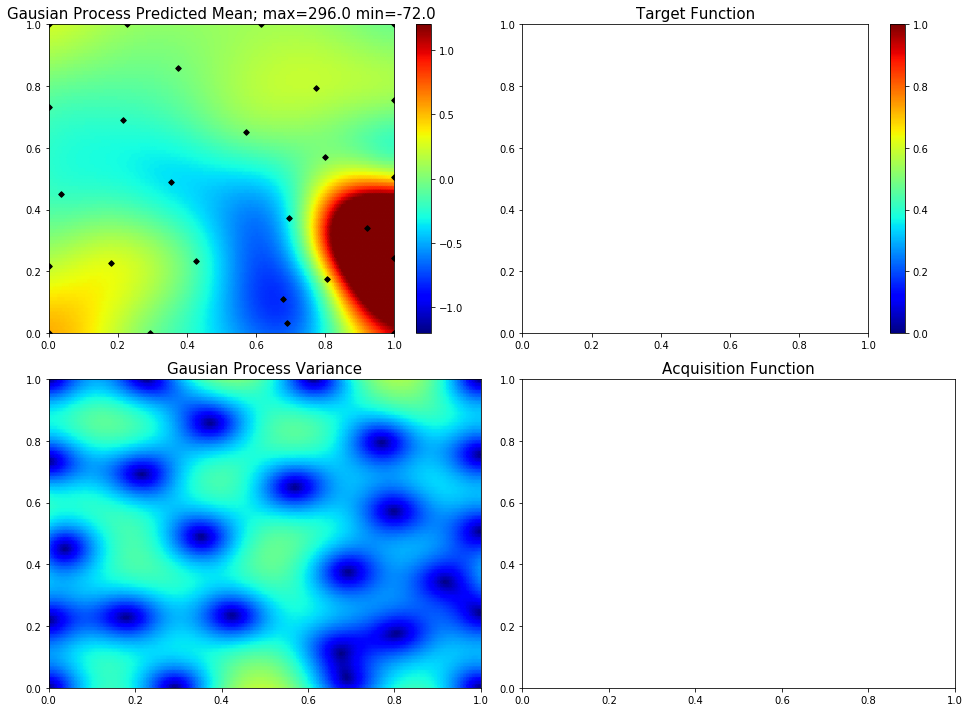

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.8095390029982424]
79  Evaluations Remaining
|  27       |  0.04859  |  1.0      |  0.8095   |
myplot:  027


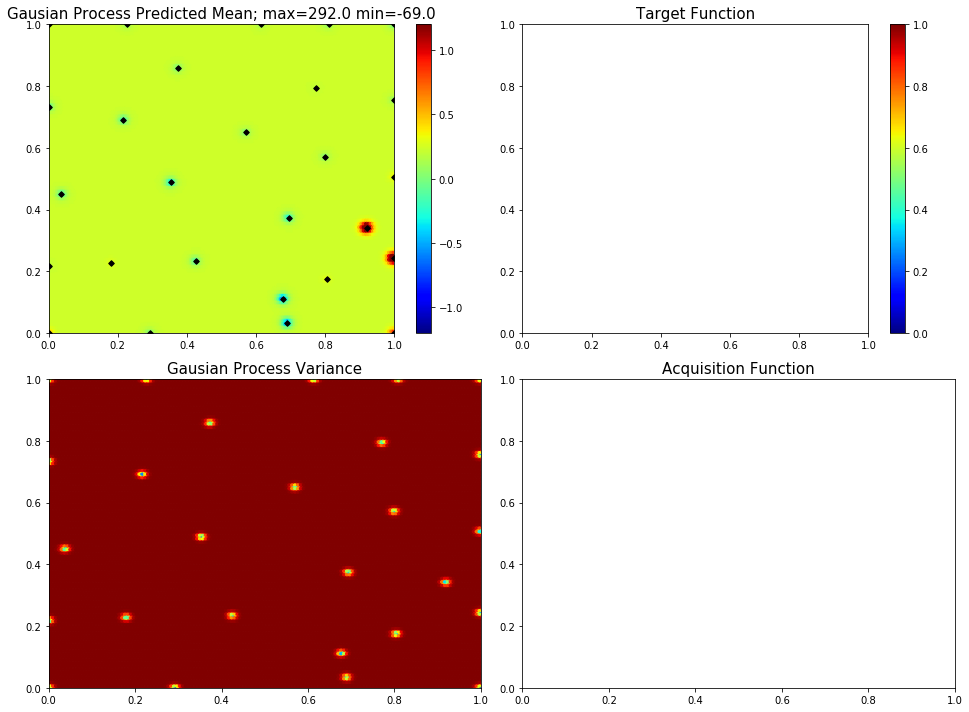

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3412222504983683, 1.0]
78  Evaluations Remaining
|  28       |  2.334    |  0.3412   |  1.0      |
myplot:  028


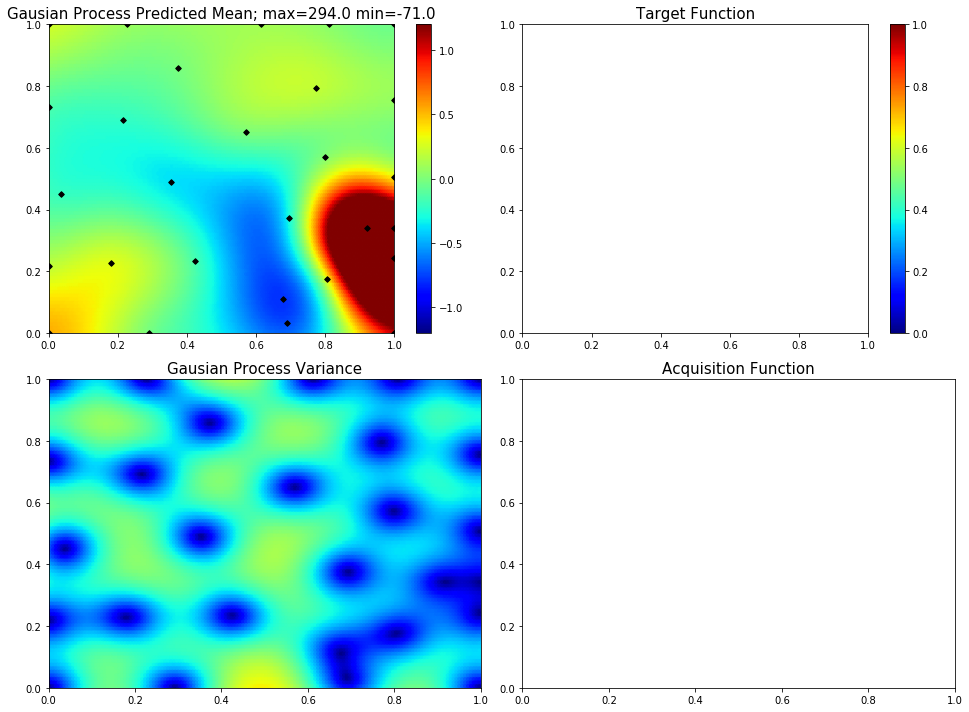

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.4872577926578137]
77  Evaluations Remaining
|  29       |  0.003002 |  0.0      |  0.4873   |
myplot:  029


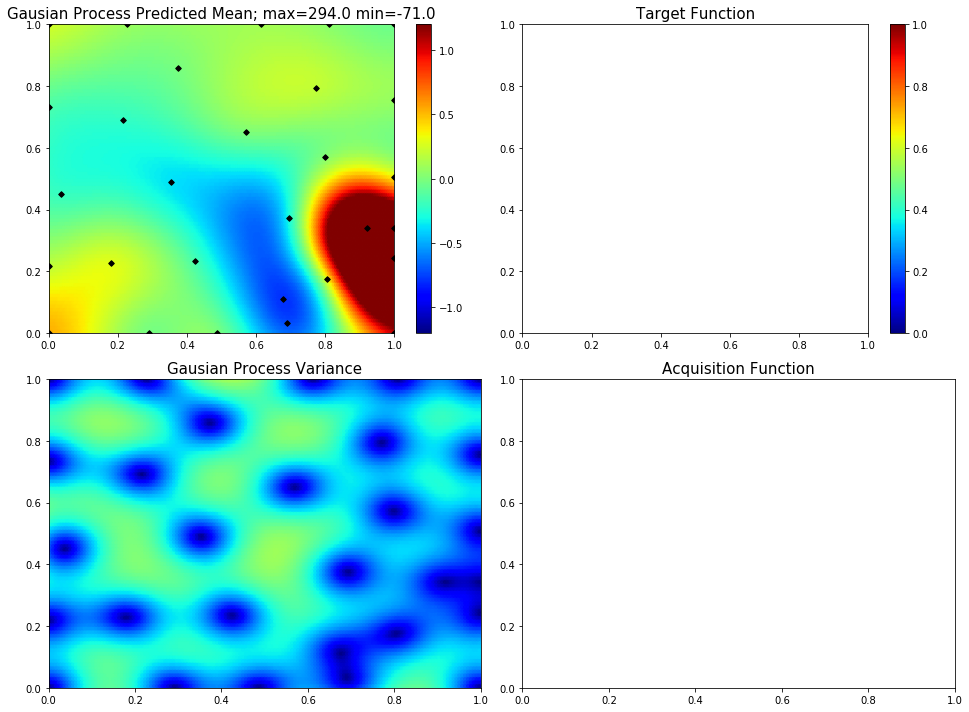

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.13440404817273646, 1.0]
76  Evaluations Remaining
|  30       |  3.177    |  0.1344   |  1.0      |
myplot:  030


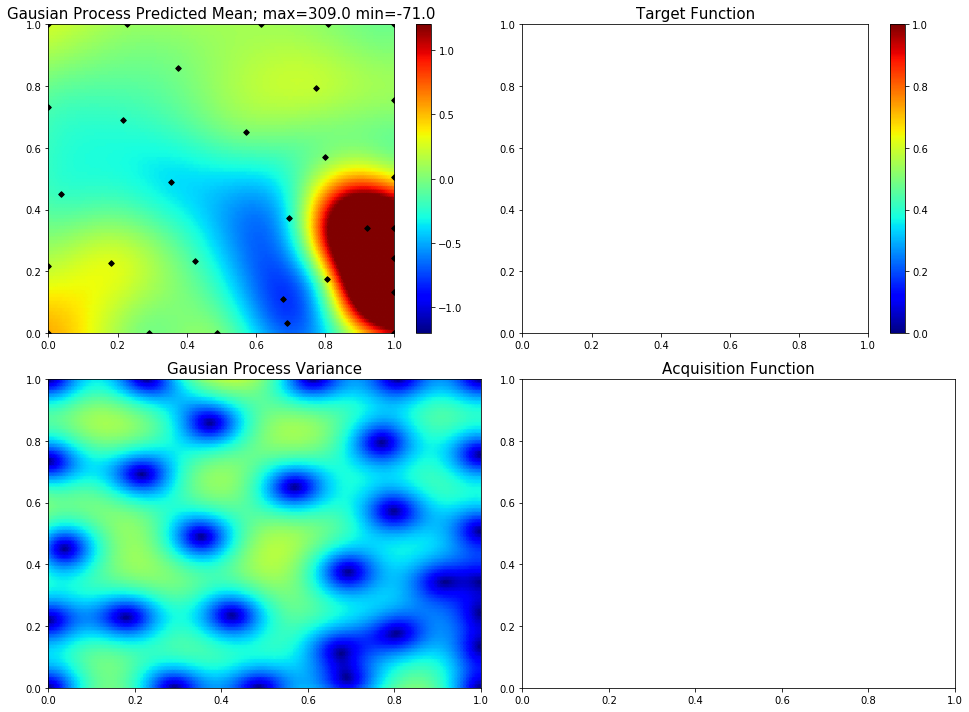

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.4283792621919613]
75  Evaluations Remaining
|  31       | -0.1162   |  1.0      |  0.4284   |
myplot:  031


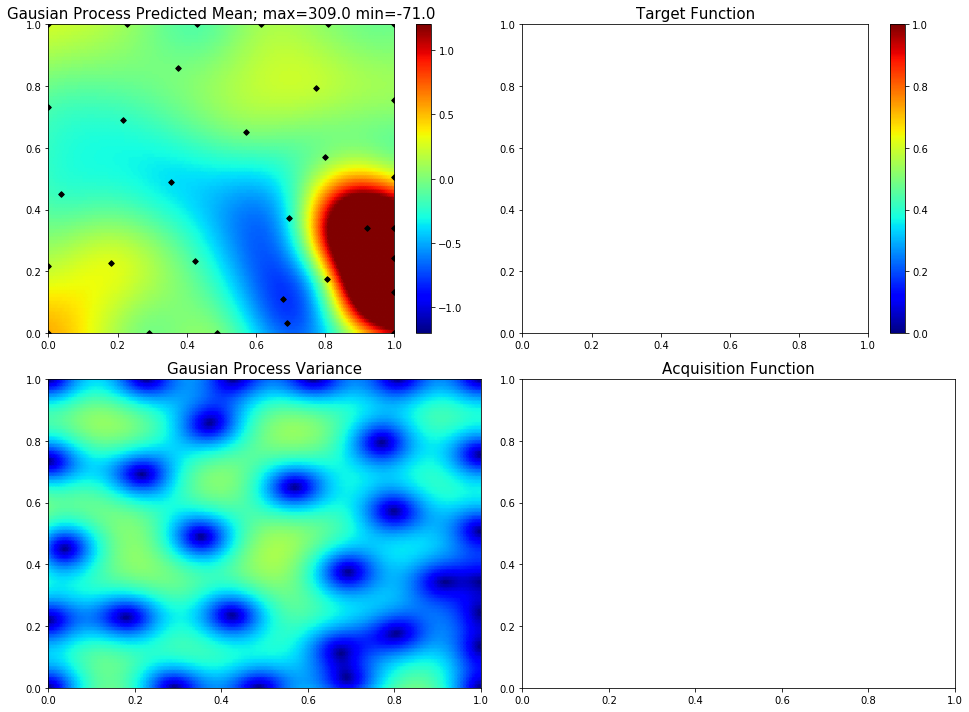

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8286424761022875, 0.5717782610519677]
74  Evaluations Remaining
|  32       | -0.1488   |  0.8286   |  0.5718   |
myplot:  032


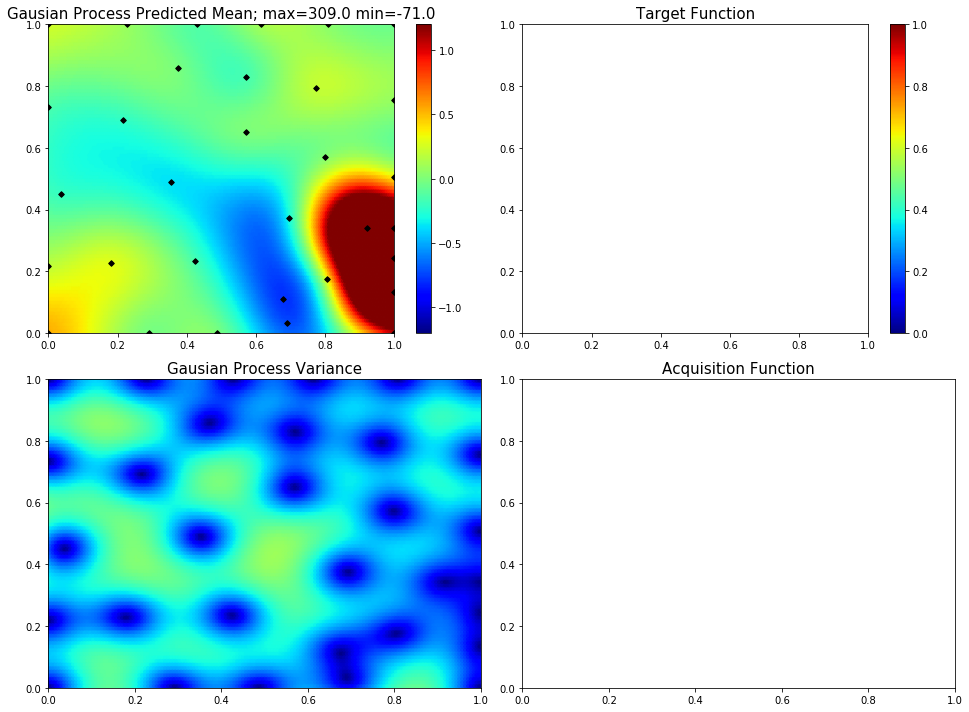

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8615733168568955, 0.12584634990596322]
73  Evaluations Remaining
|  33       |  0.05575  |  0.8616   |  0.1258   |
myplot:  033


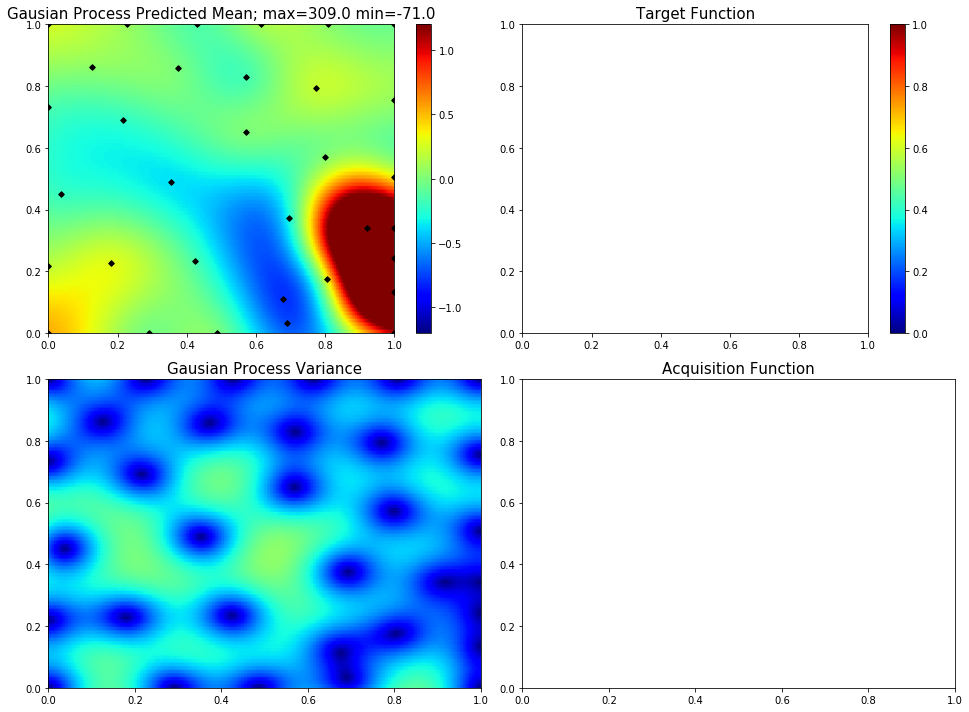

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1951145284663102, 0.9349989387564979]
72  Evaluations Remaining
|  34       |  3.239    |  0.1951   |  0.935    |
myplot:  034


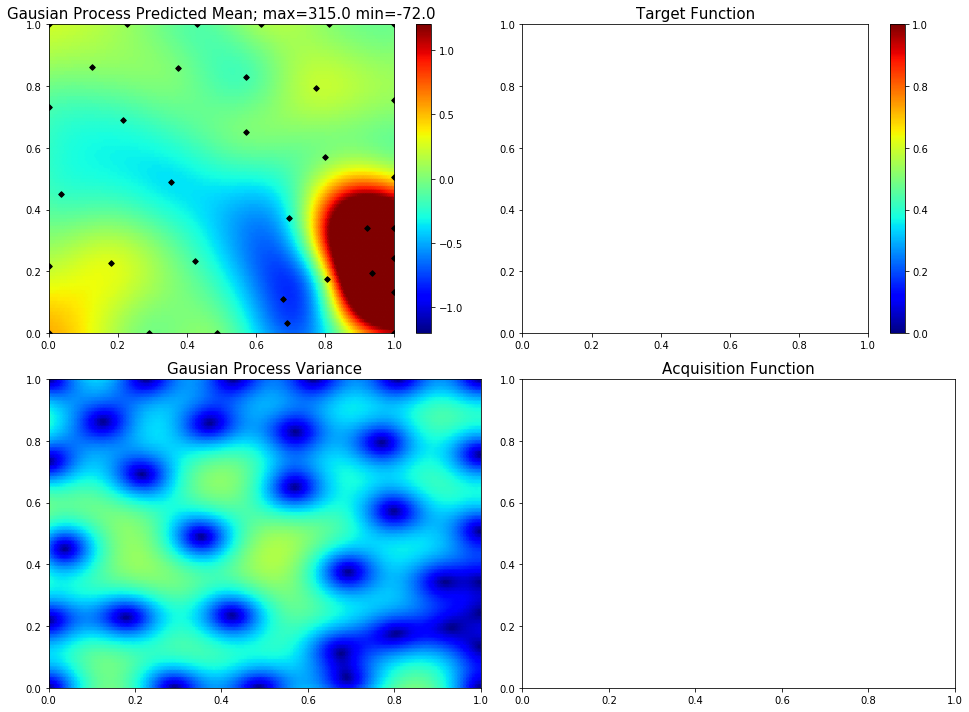

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.44232106781800107, 0.5243325968273219]
71  Evaluations Remaining
|  35       | -0.6647   |  0.4423   |  0.5243   |
myplot:  035


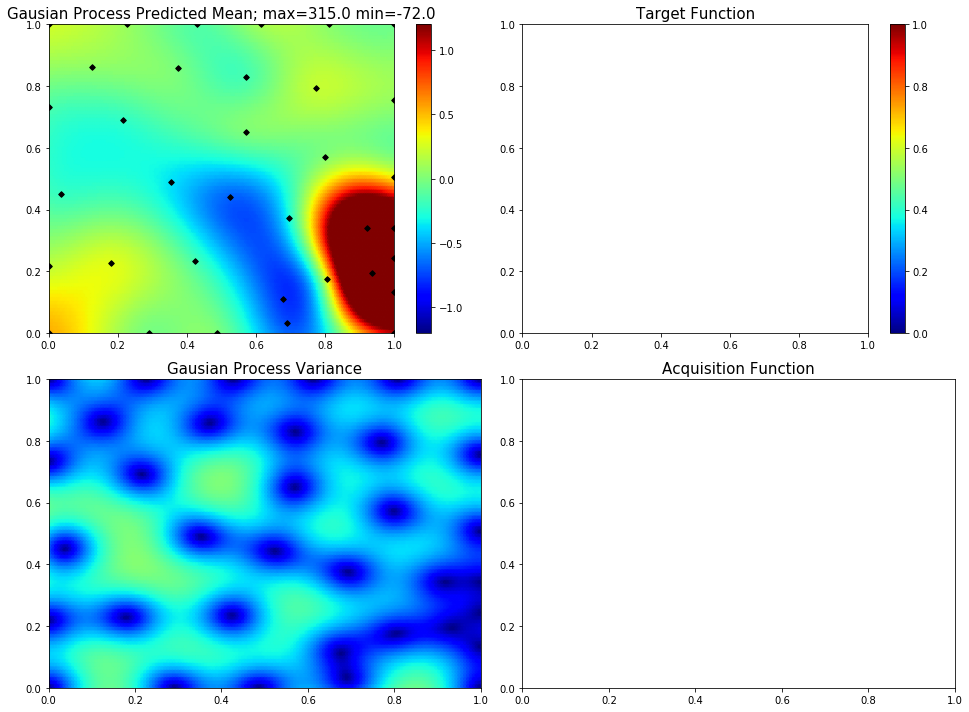

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0648529504455856, 0.13294640745784148]
70  Evaluations Remaining
|  36       |  0.181    |  0.06485  |  0.1329   |
myplot:  036


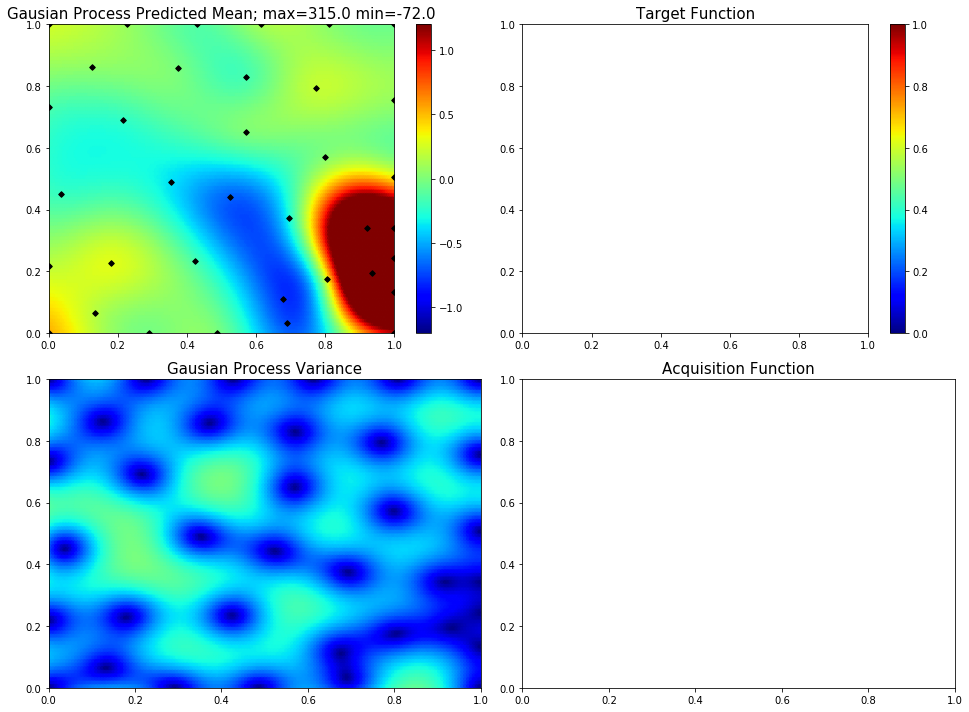

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4032964114647574, 0.20444299867135915]
69  Evaluations Remaining
|  37       | -0.004403 |  0.4033   |  0.2044   |
myplot:  037


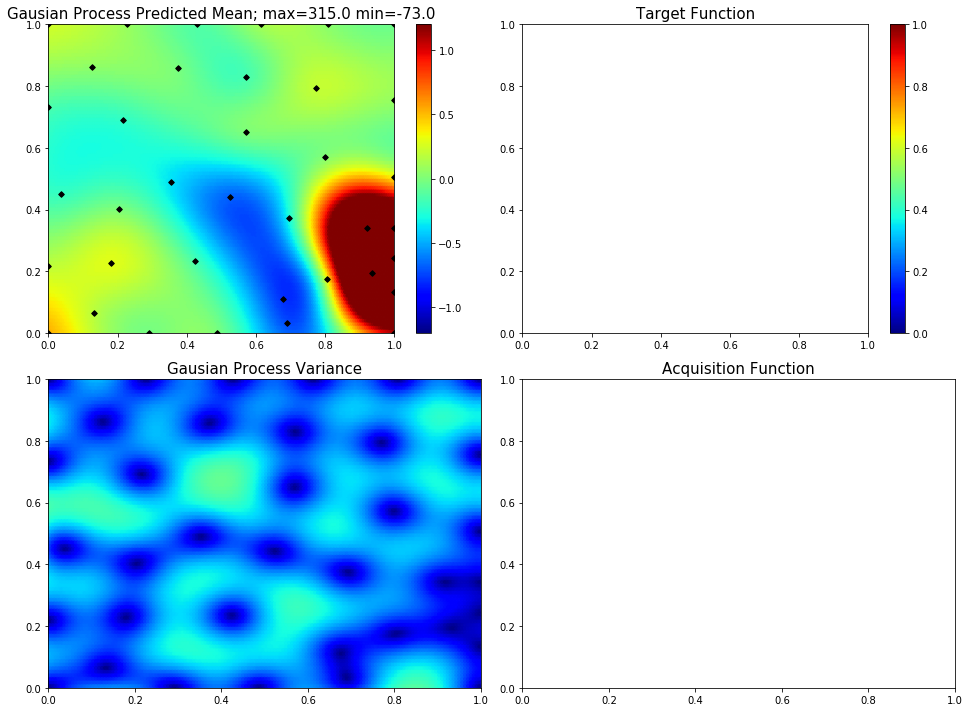

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.06962122423382178, 0.9043825430661522]
68  Evaluations Remaining
|  38       |  1.079    |  0.06962  |  0.9044   |
myplot:  038


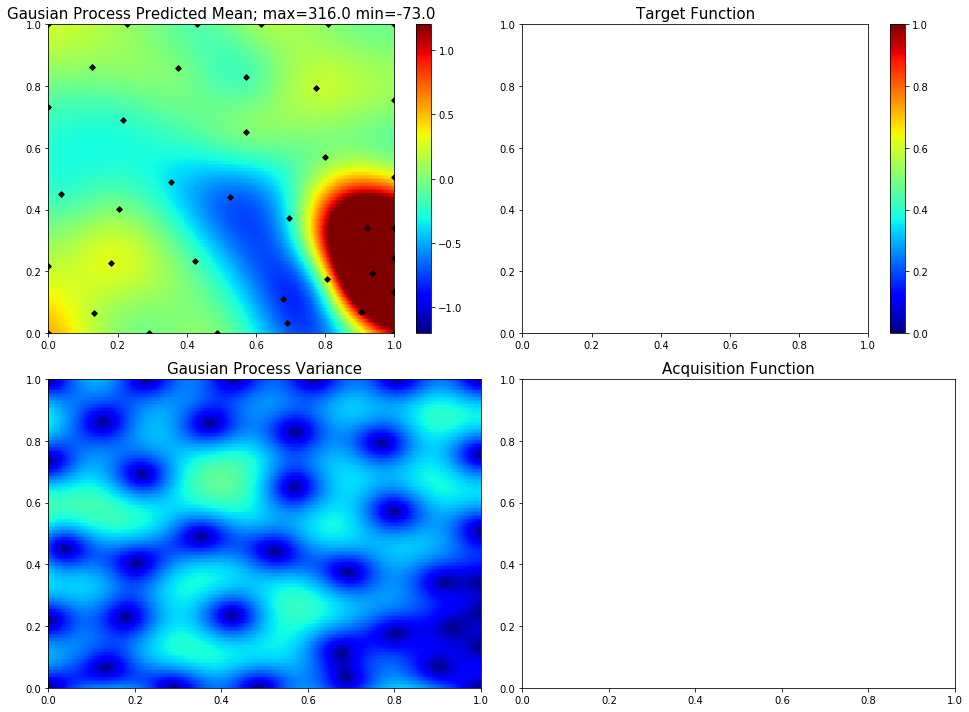

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6771479798022194, 0.4023299335722987]
67  Evaluations Remaining
|  39       |  0.0912   |  0.6771   |  0.4023   |
myplot:  039


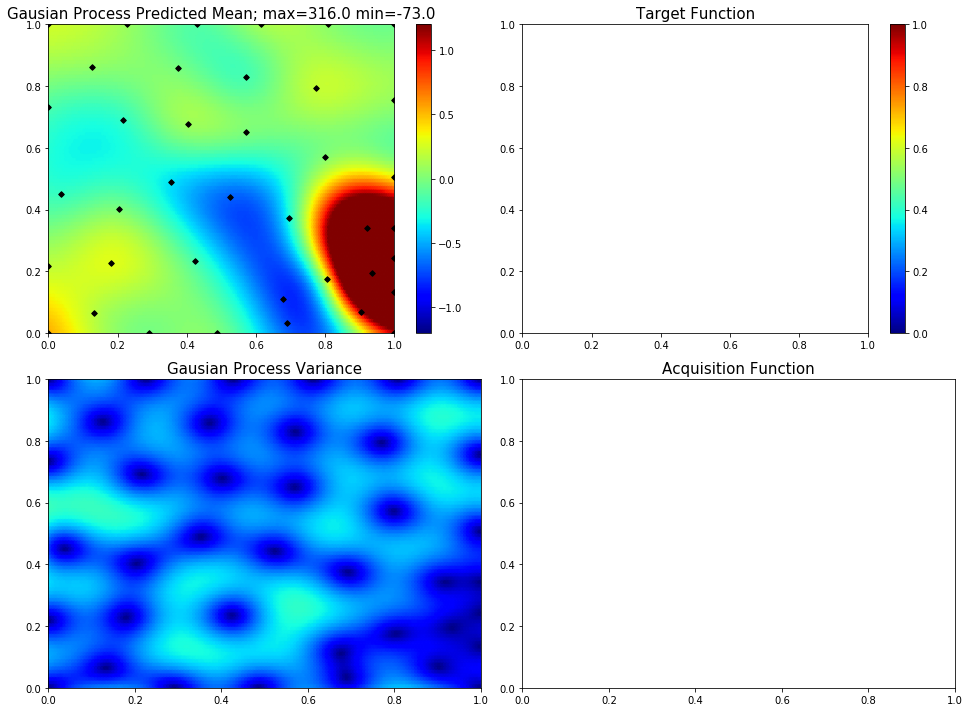

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.26399686491073276, 0.9253996758881912]
66  Evaluations Remaining
|  40       |  2.299    |  0.264    |  0.9254   |
myplot:  040


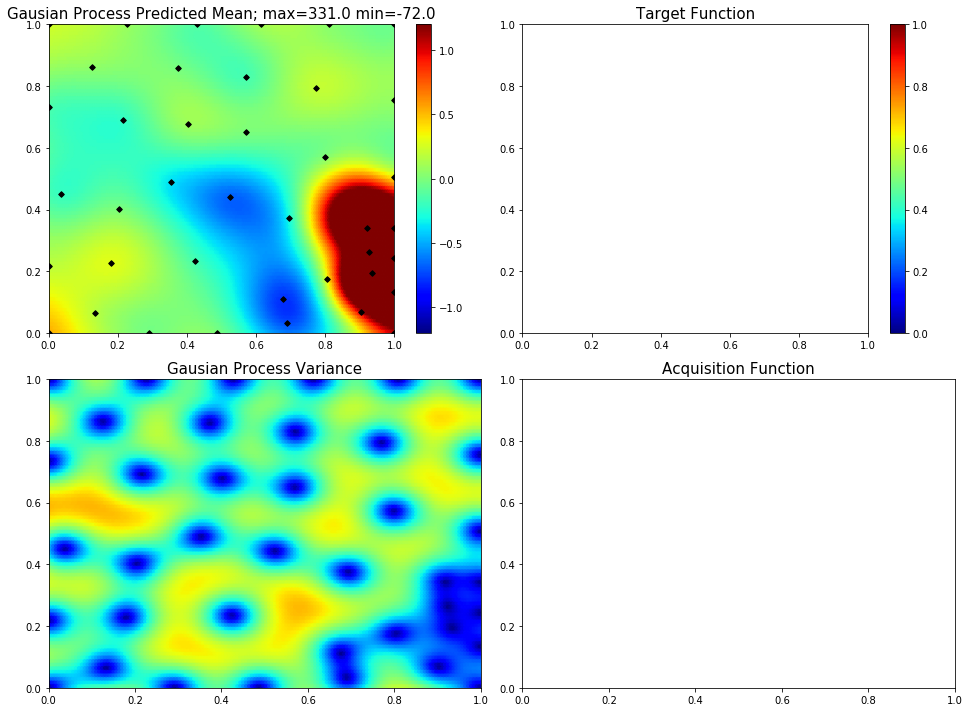

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5881618812119432, 0.0]
65  Evaluations Remaining
|  41       | -0.3181   |  0.5882   |  0.0      |
myplot:  041


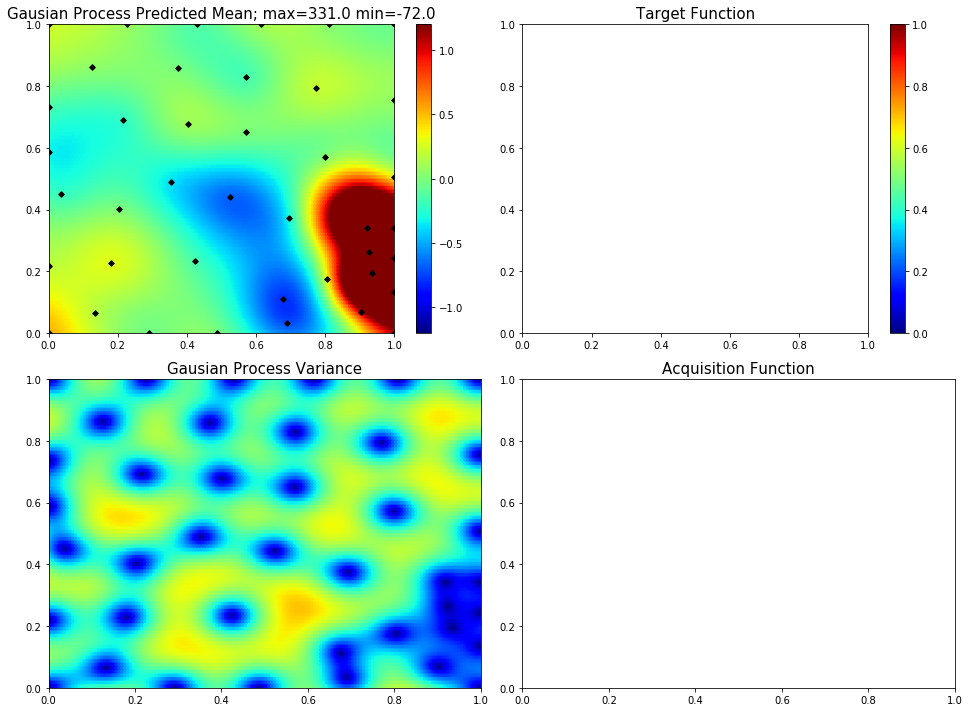

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4361066262076826, 0.8467602456951353]
64  Evaluations Remaining
|  42       | -0.04505  |  0.4361   |  0.8468   |
myplot:  042


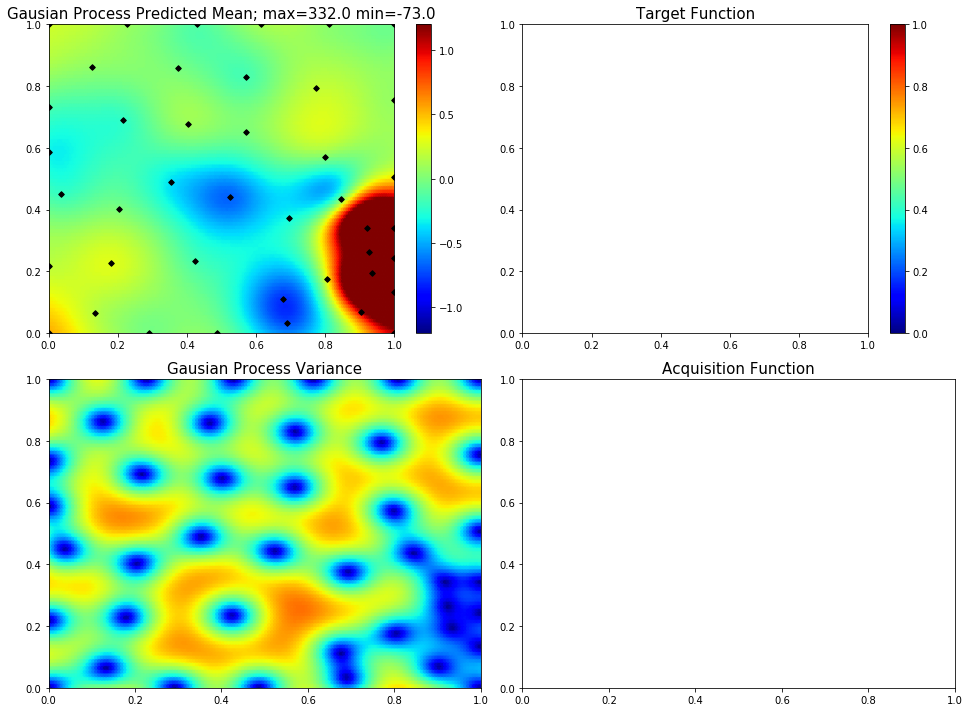

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2554956955228108, 0.5796032405563246]
63  Evaluations Remaining
|  43       | -0.2573   |  0.2555   |  0.5796   |
myplot:  043


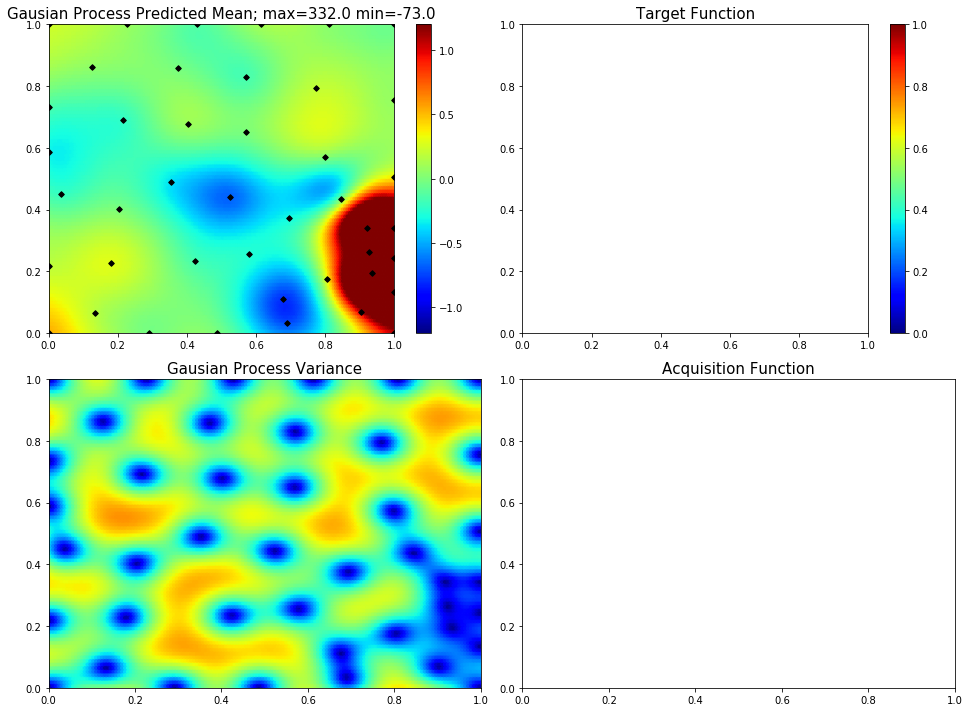

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8724779137597893, 0.9070176513935303]
62  Evaluations Remaining
|  44       |  0.002951 |  0.8725   |  0.907    |
myplot:  044


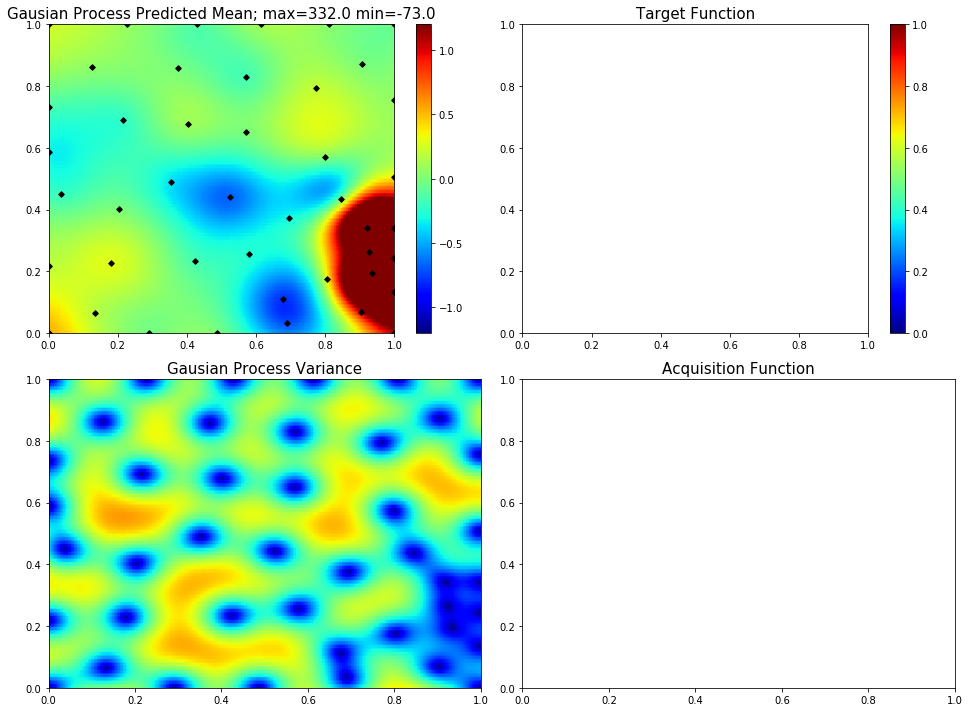

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.14396191961876562, 0.30746645023362434]
61  Evaluations Remaining
|  45       |  0.155    |  0.144    |  0.3075   |
myplot:  045


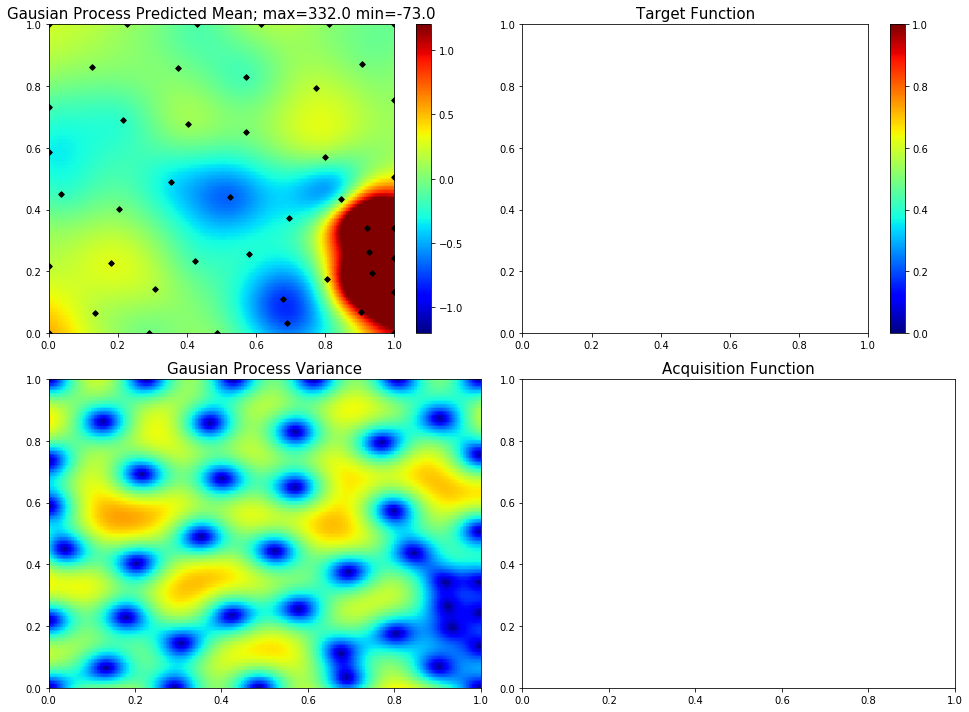

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5507919729011123, 0.17229681123622342]
60  Evaluations Remaining
|  46       | -0.2138   |  0.5508   |  0.1723   |
myplot:  046


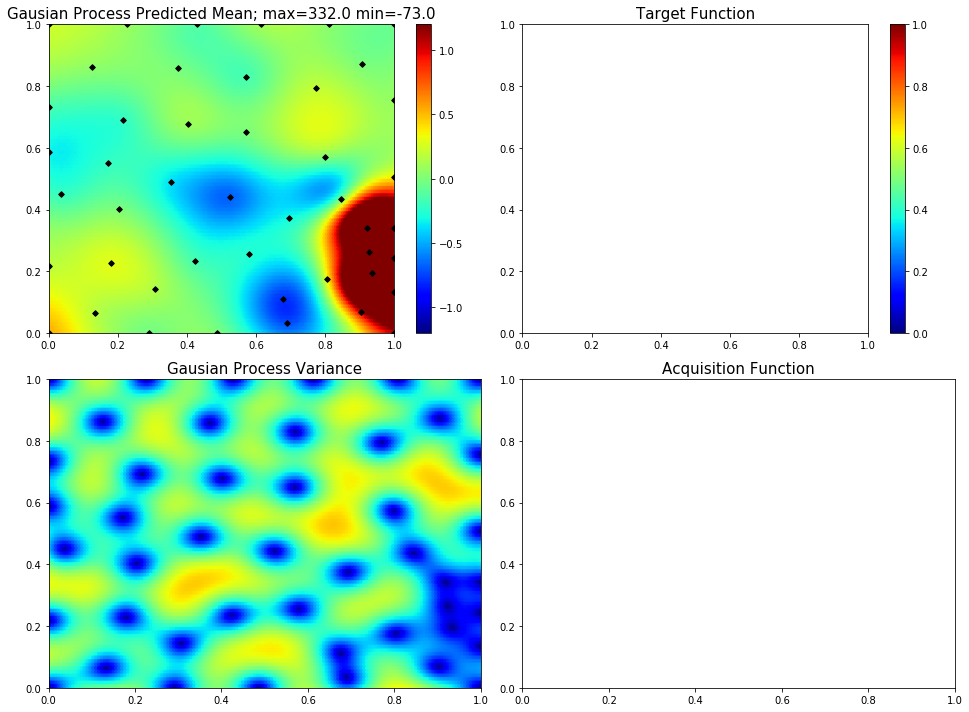

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6725984132422279, 0.8926550810933065]
59  Evaluations Remaining
|  47       |  0.1173   |  0.6726   |  0.8927   |
myplot:  047


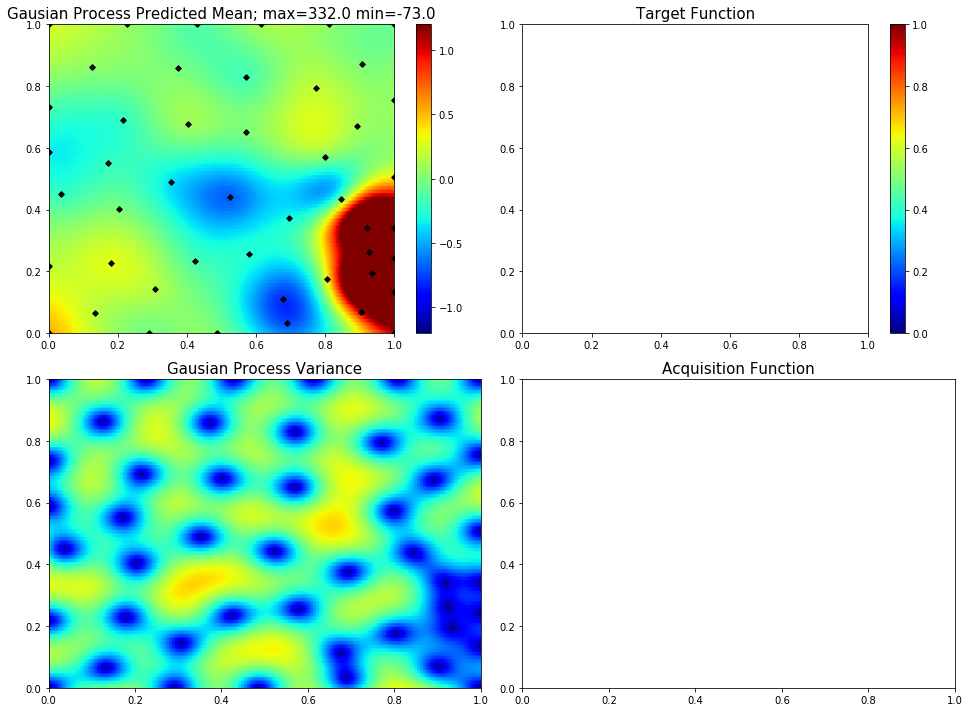

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3243271911767057, 0.32208074605726034]
58  Evaluations Remaining
|  48       | -0.1945   |  0.3243   |  0.3221   |
myplot:  048


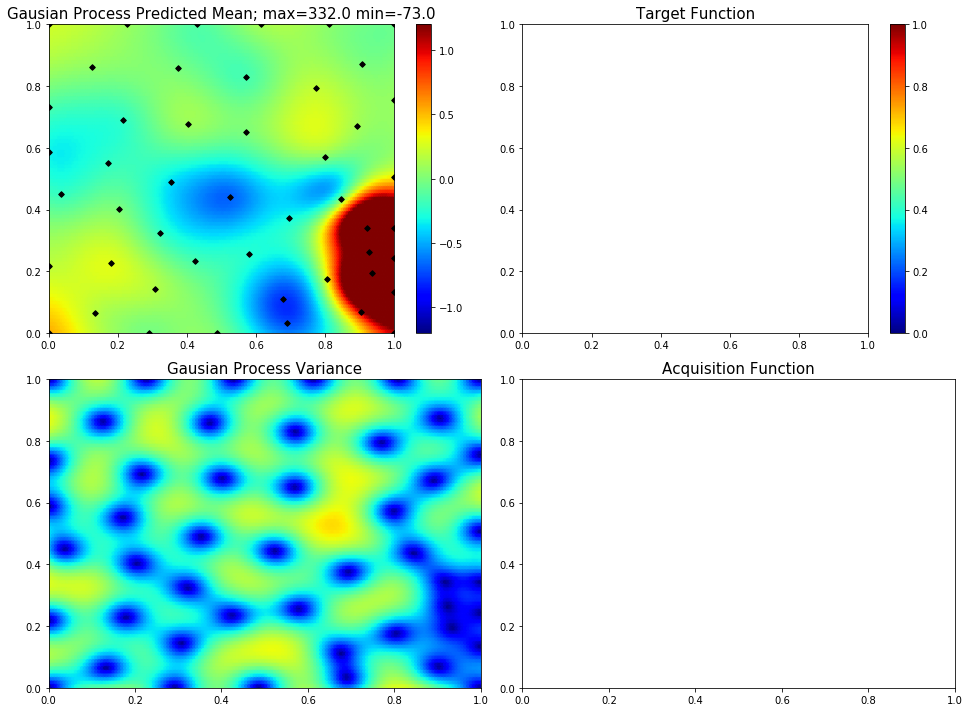

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.536902784957526, 0.6600724749235943]
57  Evaluations Remaining
|  49       |  0.129    |  0.5369   |  0.6601   |
myplot:  049


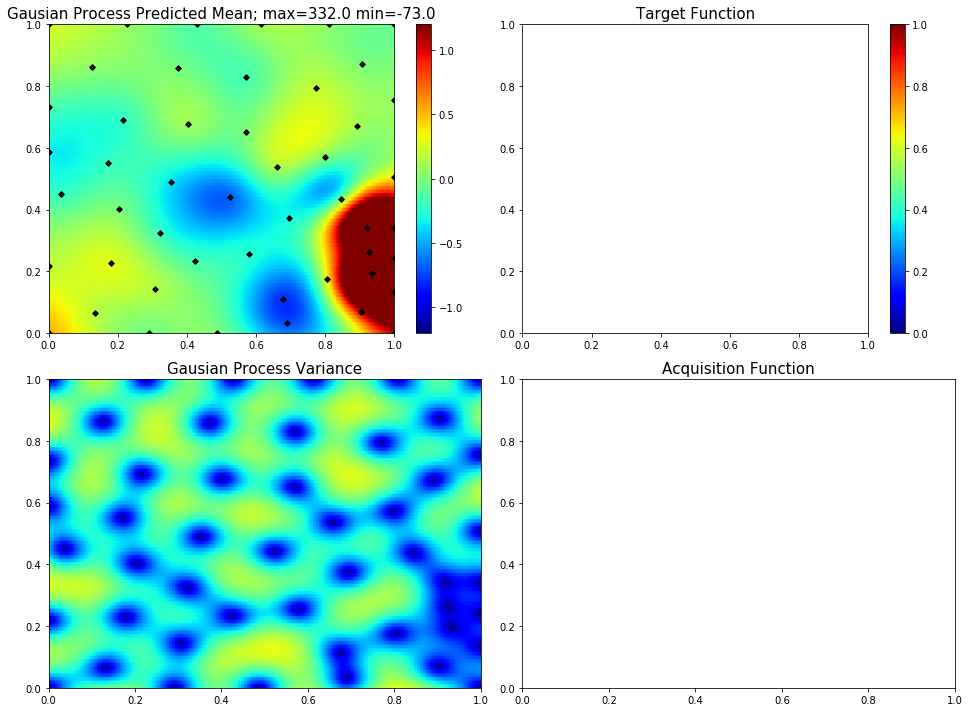

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6805265438746871, 0.7051544904233531]
56  Evaluations Remaining
|  50       |  0.006925 |  0.6805   |  0.7052   |
myplot:  050


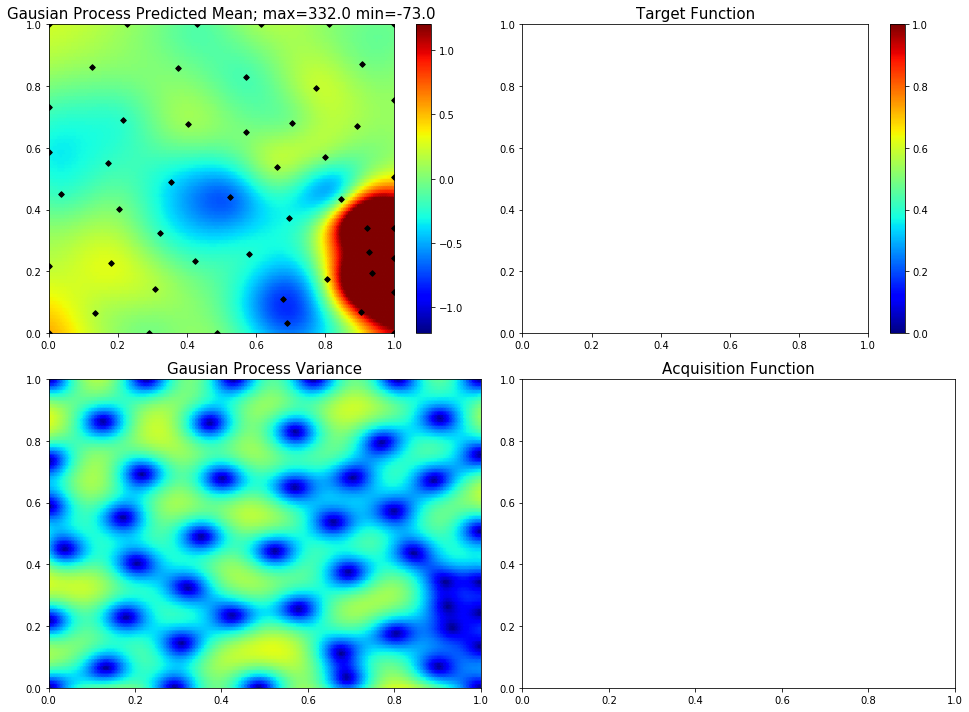

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8721381349393258, 0.0]
55  Evaluations Remaining
|  51       |  0.1034   |  0.8721   |  0.0      |
myplot:  051


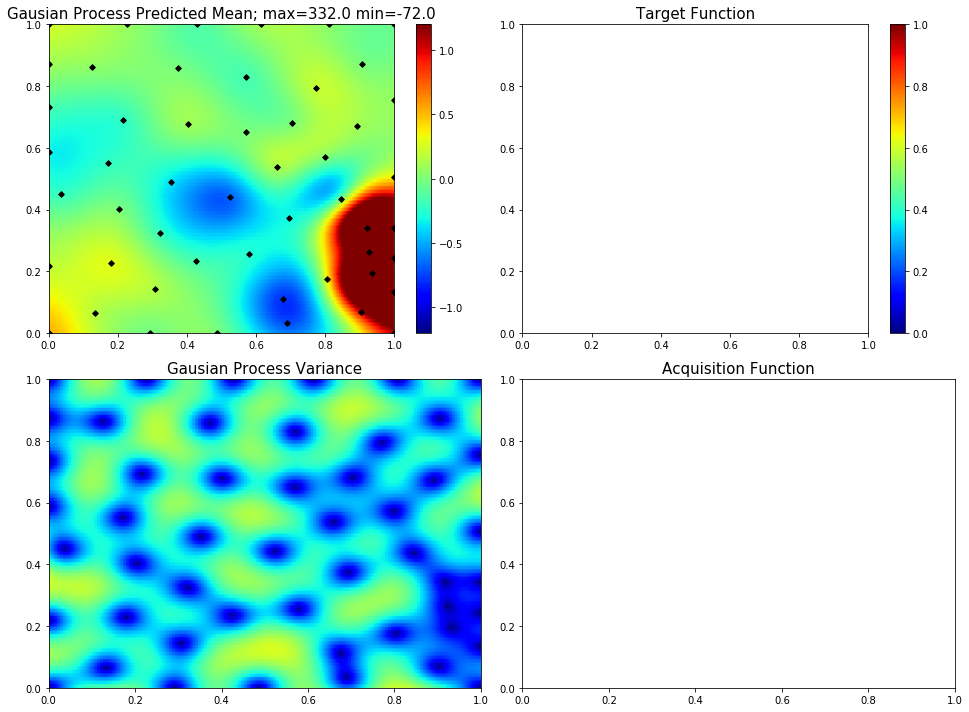

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3362709347923523, 0.0]
54  Evaluations Remaining
|  52       |  0.06413  |  0.3363   |  0.0      |
myplot:  052


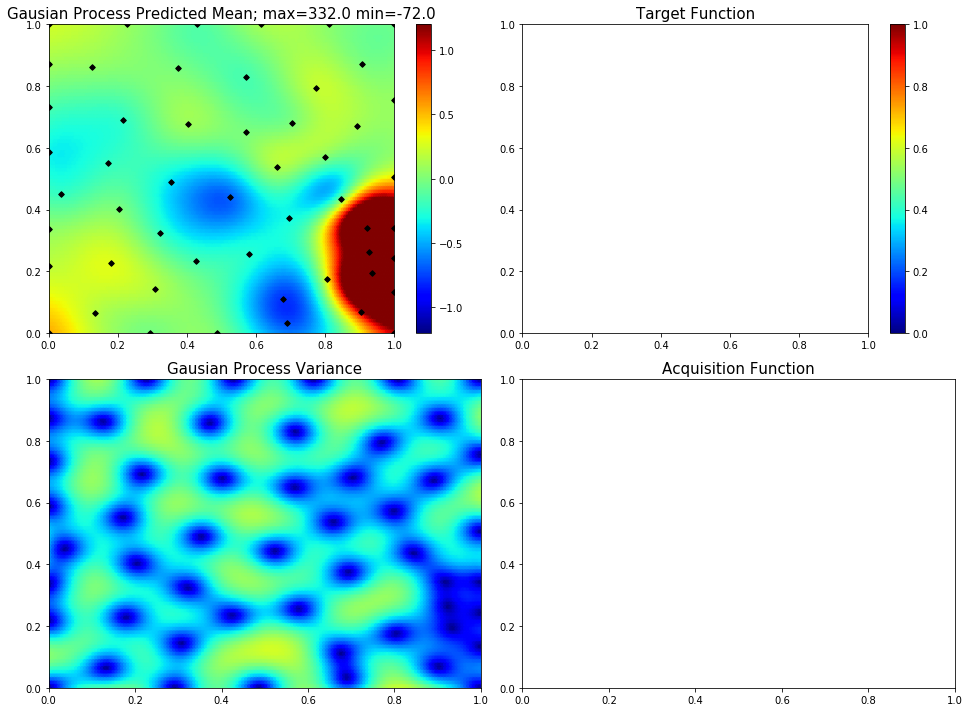

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9050850492634326, 0.7052237123593962]
53  Evaluations Remaining
|  53       |  0.1453   |  0.9051   |  0.7052   |
myplot:  053


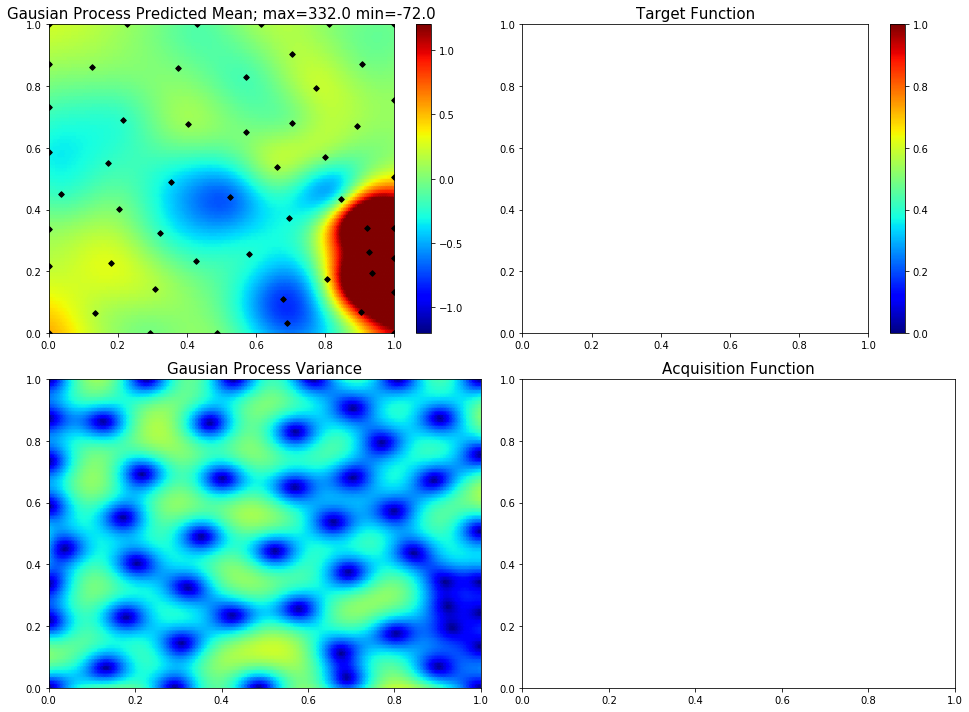

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.12397691133783313, 0.506511559904171]
52  Evaluations Remaining
|  54       | -0.3894   |  0.124    |  0.5065   |
myplot:  054


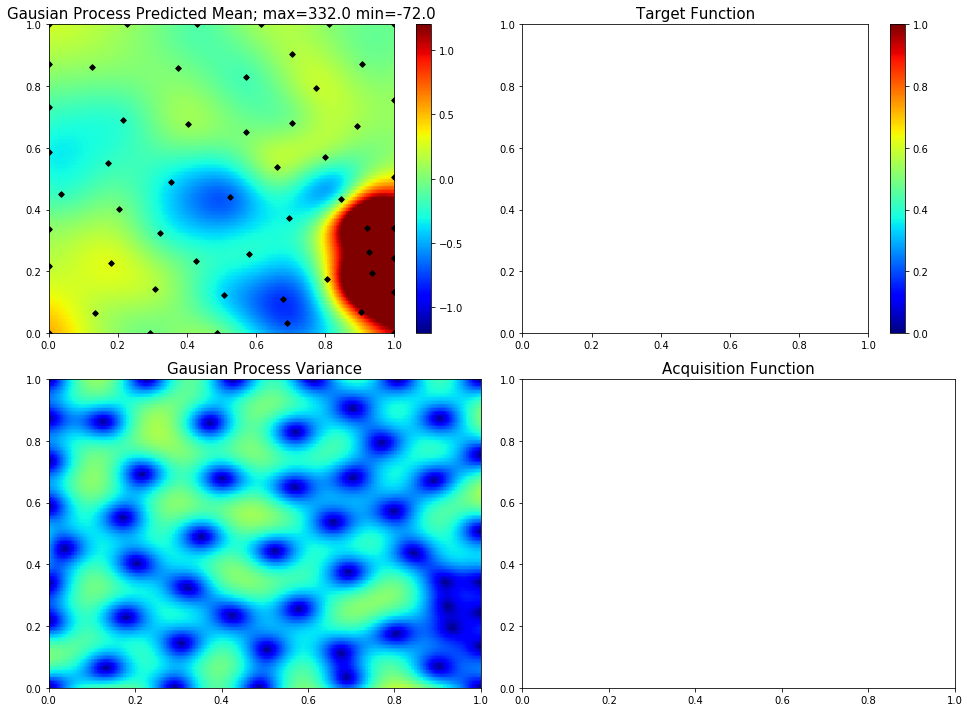

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8357273261280039, 0.25307720080999546]
51  Evaluations Remaining
|  55       |  0.006456 |  0.8357   |  0.2531   |
myplot:  055


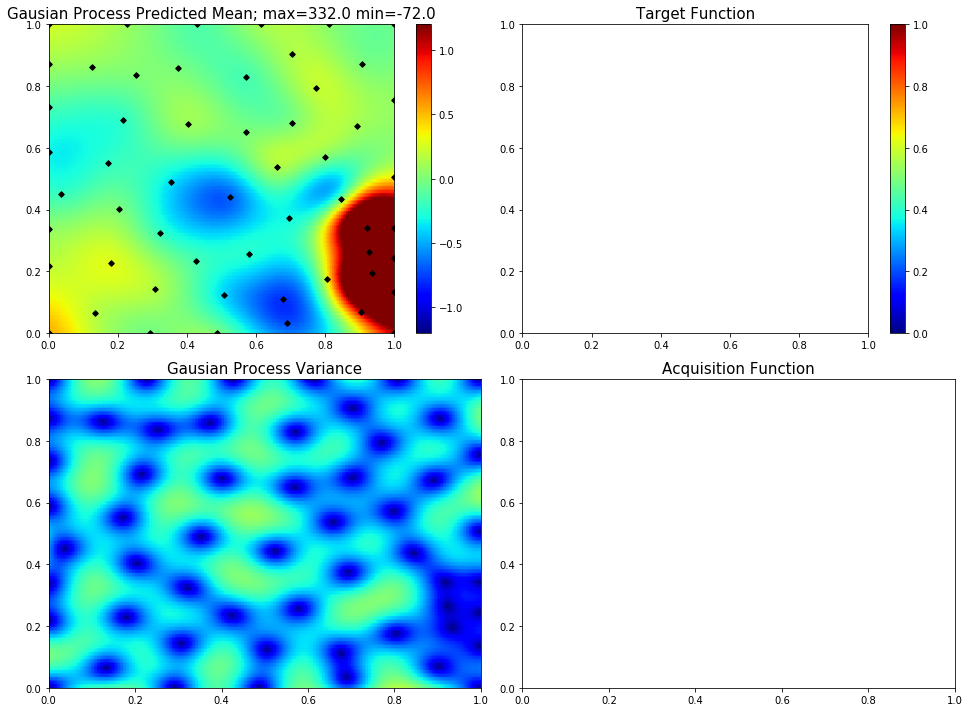

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8206487468504422]
50  Evaluations Remaining
|  56       | -0.37     |  0.0      |  0.8206   |
myplot:  056


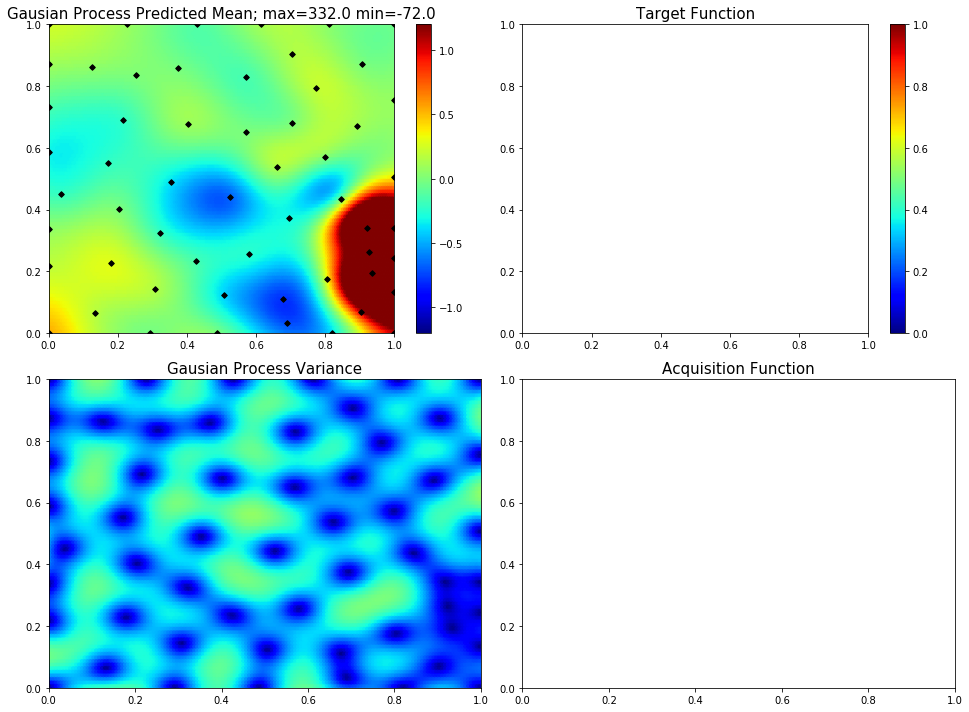

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.30492375351924517, 0.8125874871554454]
49  Evaluations Remaining
|  57       |  0.4301   |  0.3049   |  0.8126   |
myplot:  057


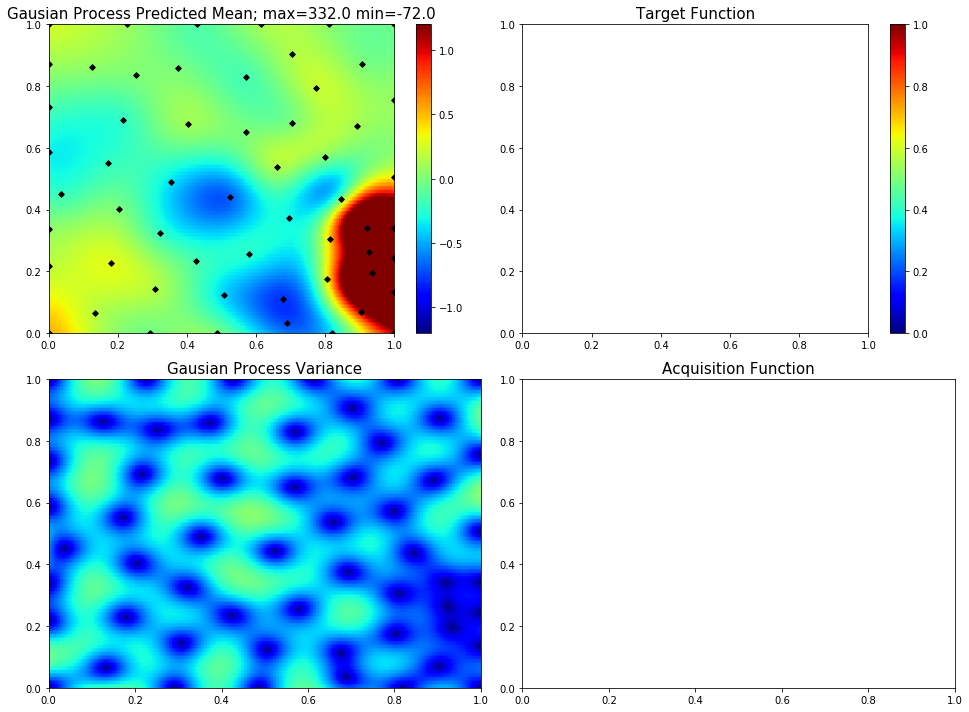

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6287963198011843, 1.0]
48  Evaluations Remaining
|  58       |  0.1671   |  0.6288   |  1.0      |
myplot:  058


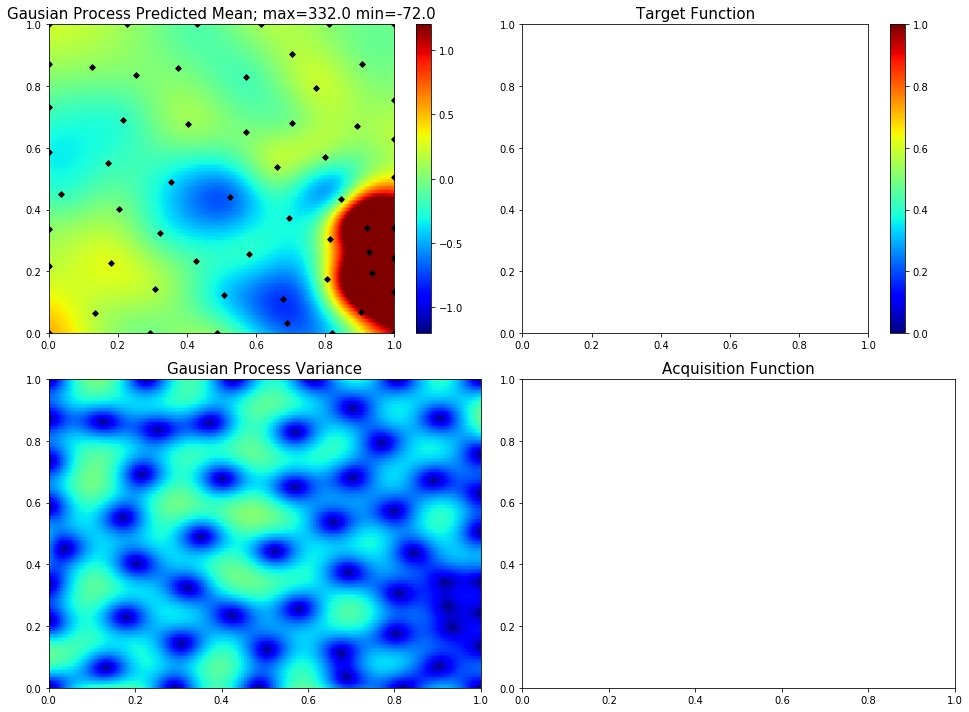

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.1107947721139276]
47  Evaluations Remaining
|  59       |  0.3191   |  1.0      |  0.1108   |
myplot:  059


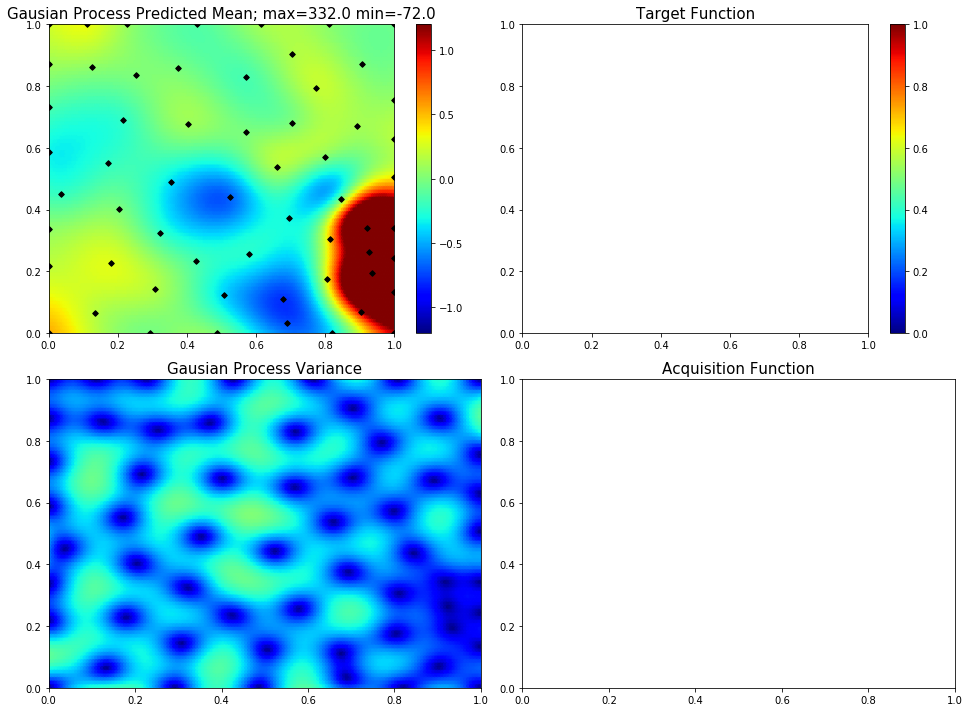

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.18802433657425843, 1.0]
46  Evaluations Remaining
|  60       |  3.266    |  0.188    |  1.0      |
myplot:  060


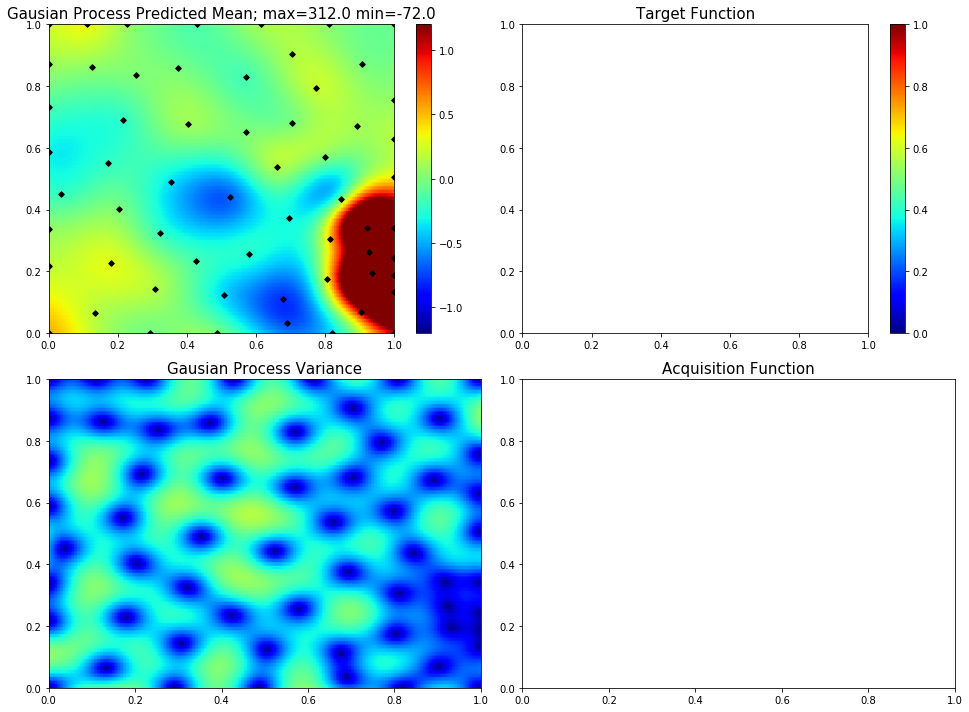

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.103799667112421, 0.0]
45  Evaluations Remaining
|  61       |  0.5085   |  0.1038   |  0.0      |
myplot:  061


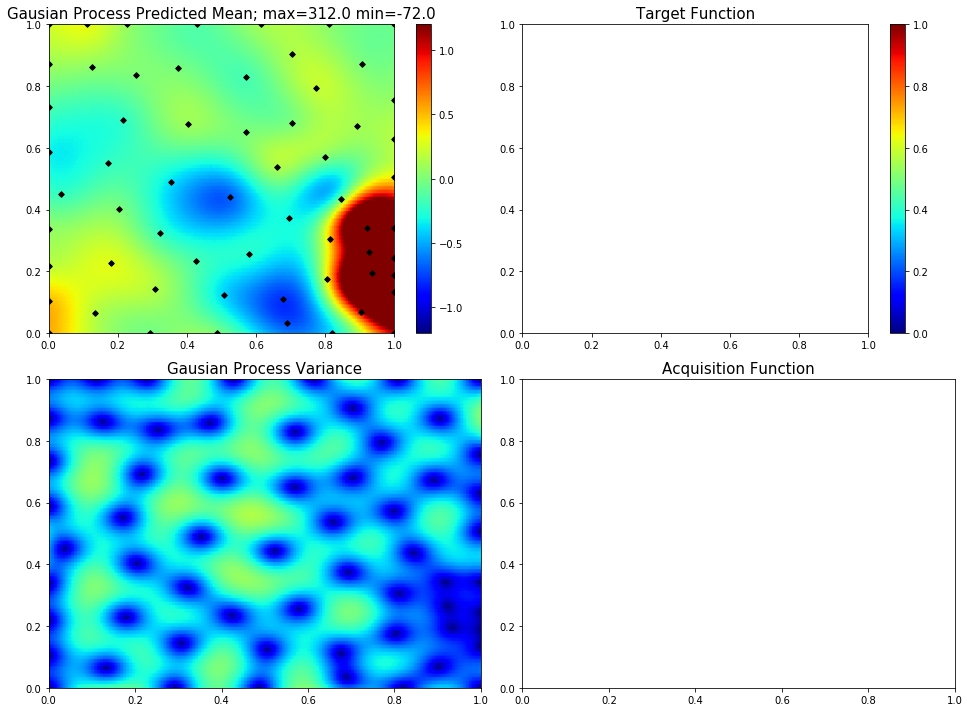

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.14410211288026226, 0.9501830823916629]
44  Evaluations Remaining
|  62       |  3.191    |  0.1441   |  0.9502   |
myplot:  062


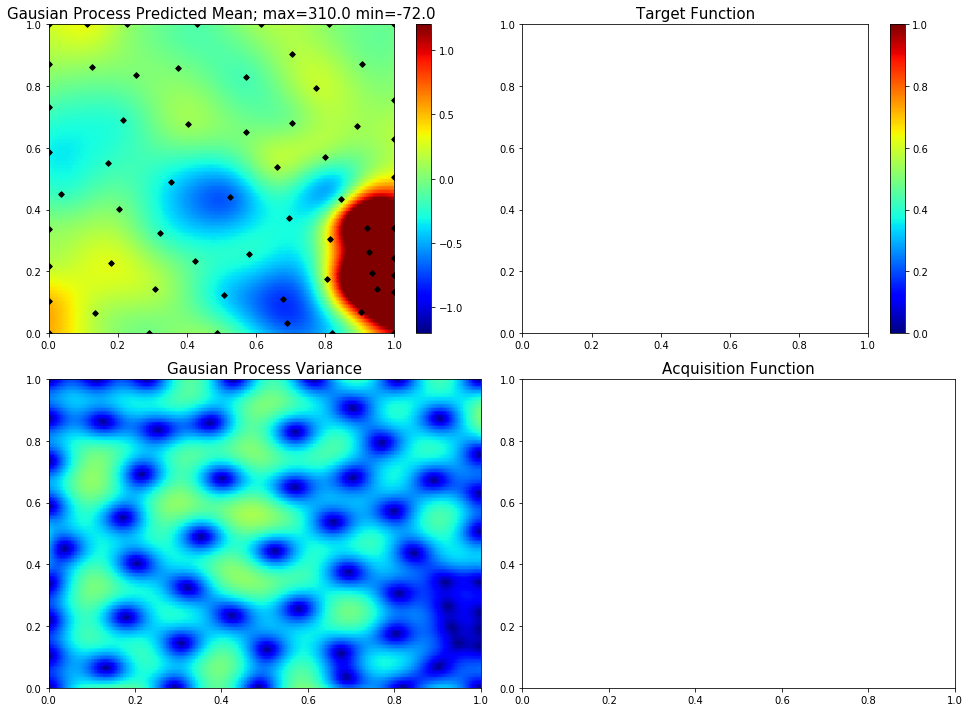

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4069299472697713, 0.9548498831969158]
43  Evaluations Remaining
|  63       |  0.7849   |  0.4069   |  0.9548   |
myplot:  063


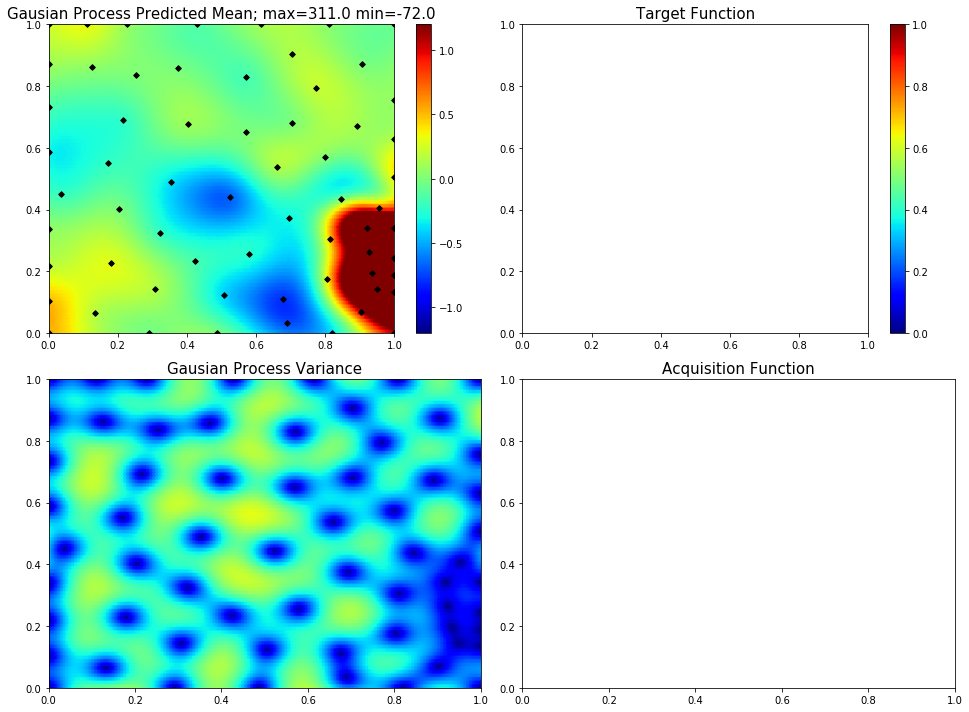

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5684140652193124, 0.47003613399550814]
42  Evaluations Remaining
|  64       | -0.5702   |  0.5684   |  0.47     |
myplot:  064


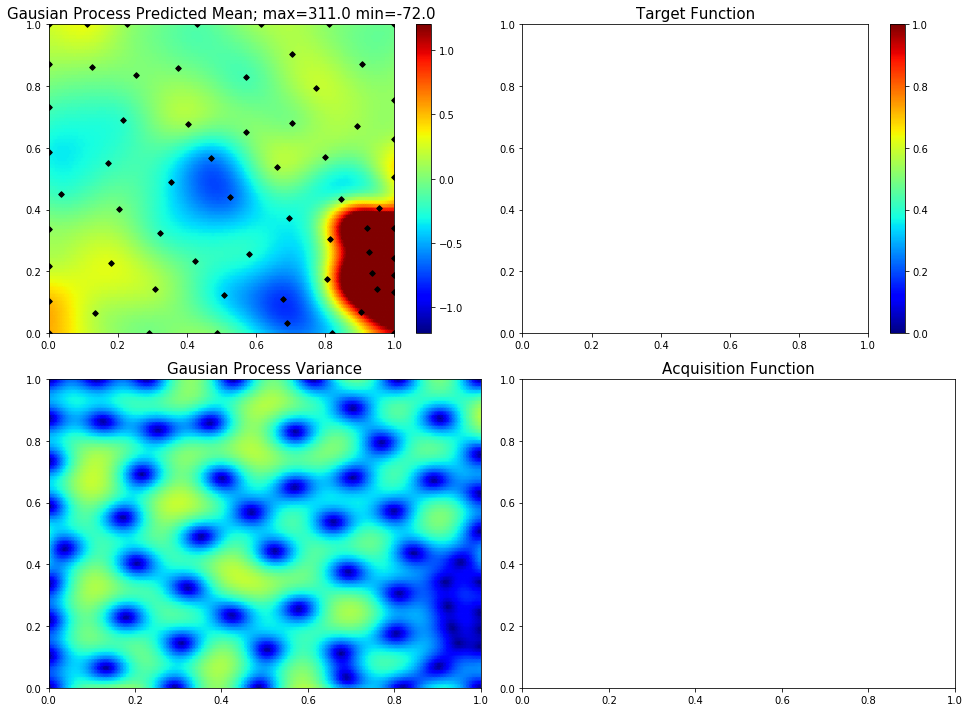

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.321216433003181, 0.10942712945363563]
41  Evaluations Remaining
|  65       |  0.02883  |  0.3212   |  0.1094   |
myplot:  065


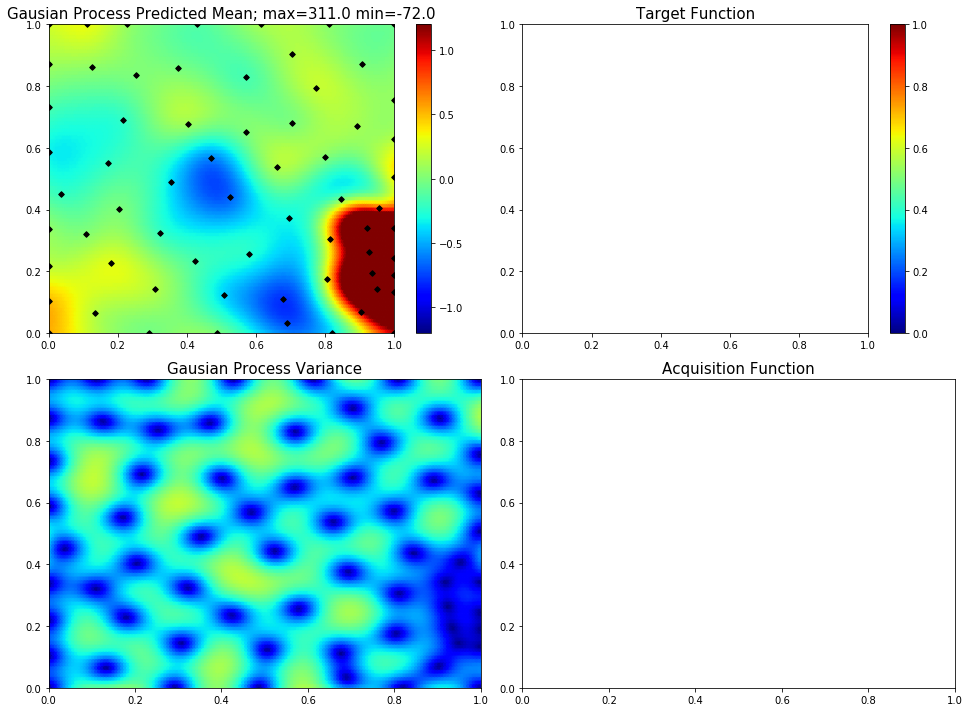

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6018847794719316, 0.30065509113082695]
40  Evaluations Remaining
|  66       | -0.3818   |  0.6019   |  0.3007   |
myplot:  066


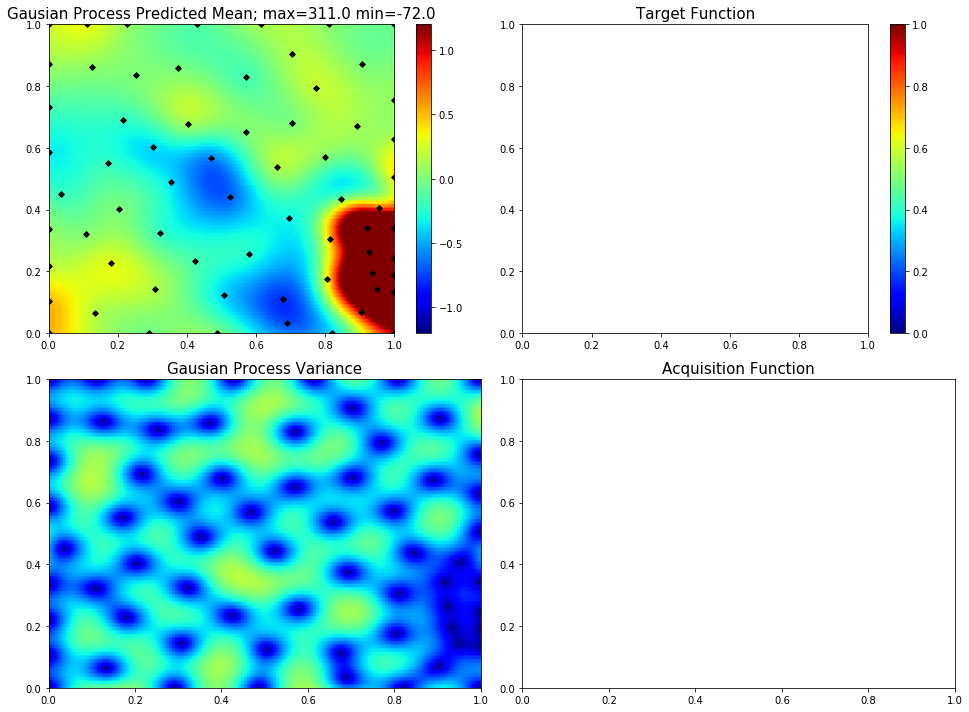

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7692335656562861, 0.47039845784664325]
39  Evaluations Remaining
|  67       |  0.0488   |  0.7692   |  0.4704   |
myplot:  067


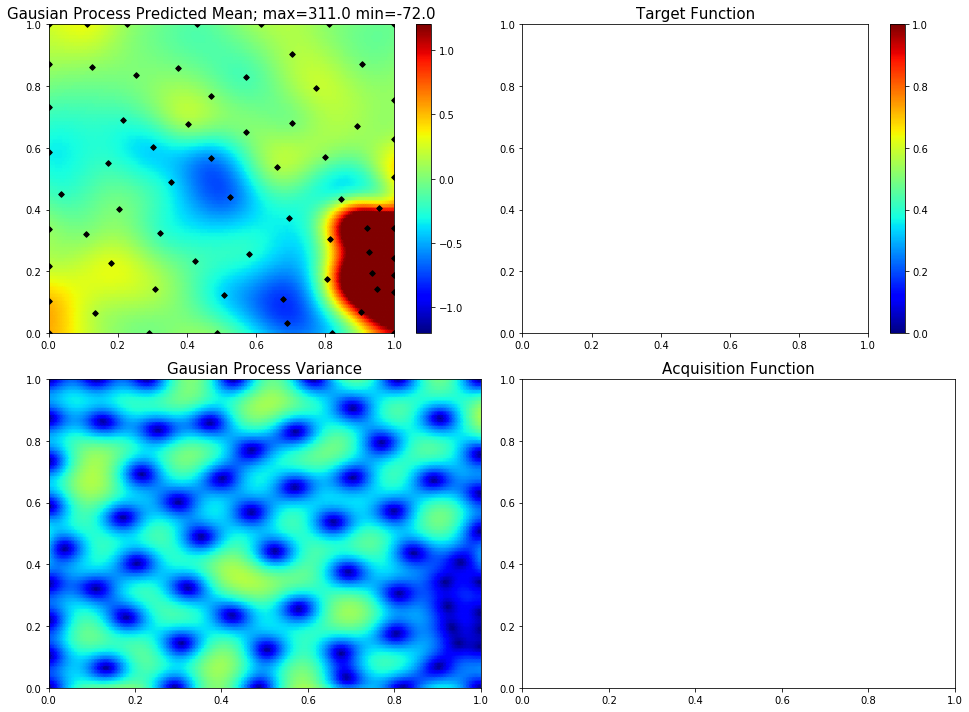

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1842986908214178, 0.9950255491229176]
38  Evaluations Remaining
|  68       |  3.318    |  0.1843   |  0.995    |
myplot:  068


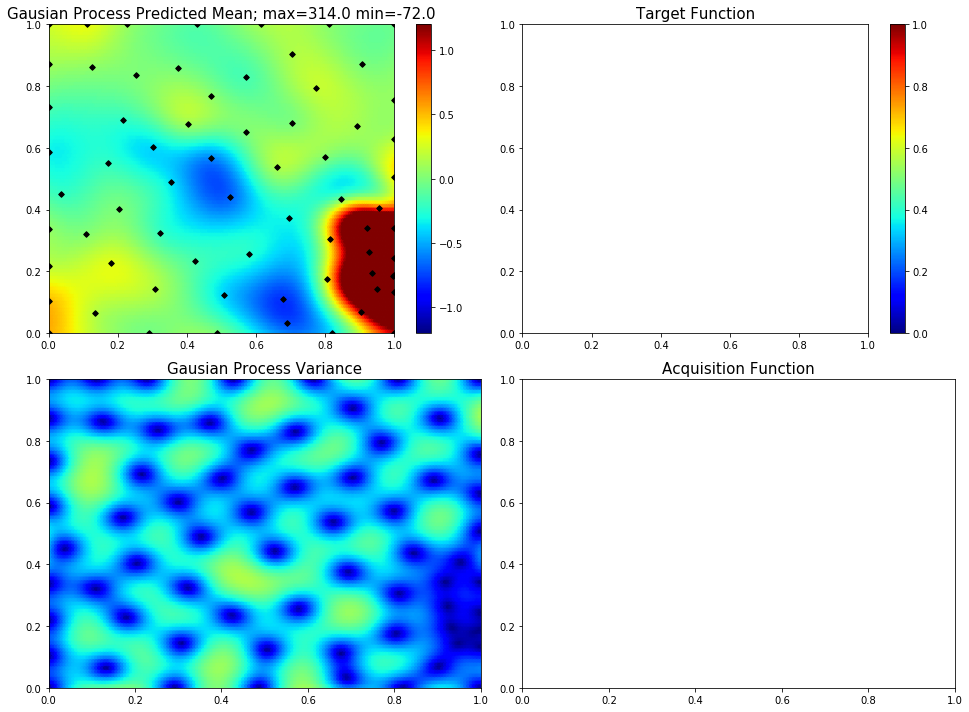

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8808317338108953, 1.0]
37  Evaluations Remaining
|  69       | -0.02953  |  0.8808   |  1.0      |
myplot:  069


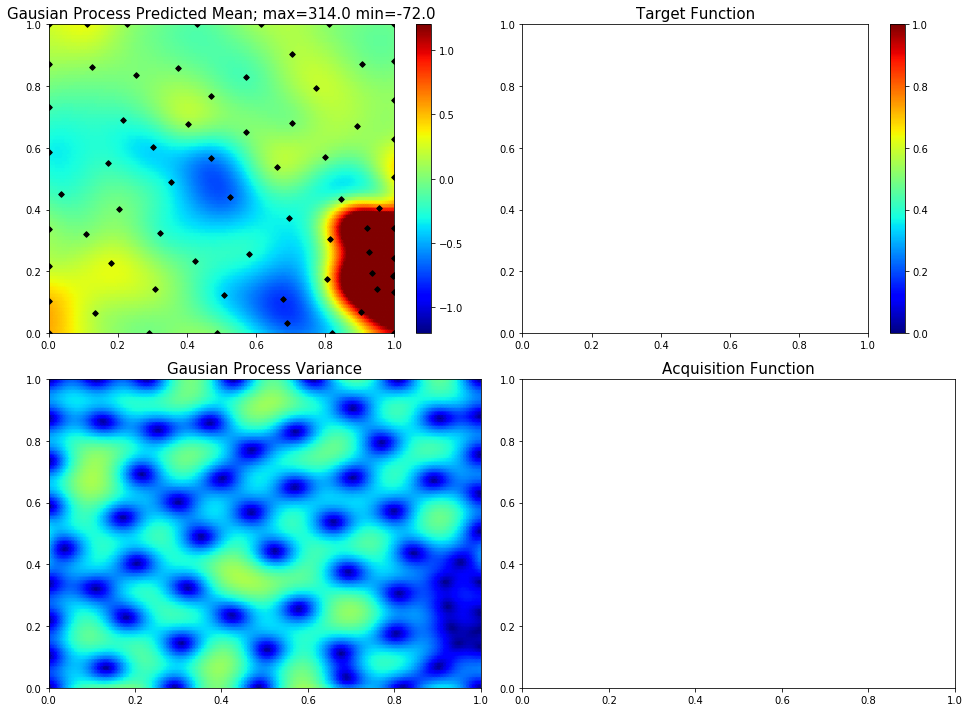

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.062100151963127175, 0.39307106624518157]
36  Evaluations Remaining
|  70       | -0.0645   |  0.0621   |  0.3931   |
myplot:  070


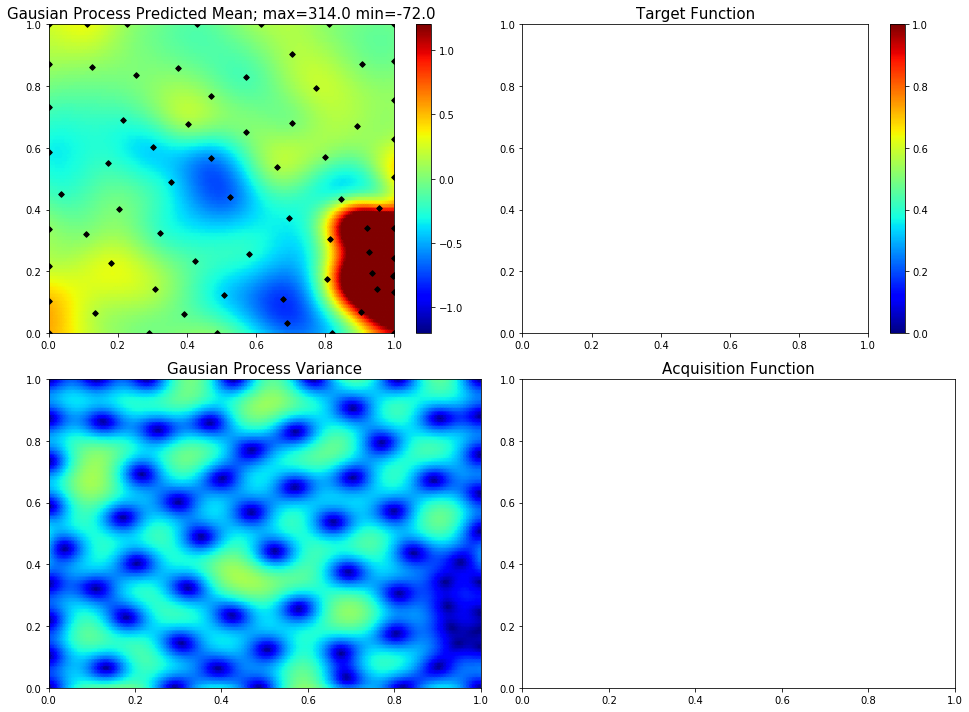

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.07866760328750709, 1.0]
35  Evaluations Remaining
|  71       |  1.029    |  0.07867  |  1.0      |
myplot:  071


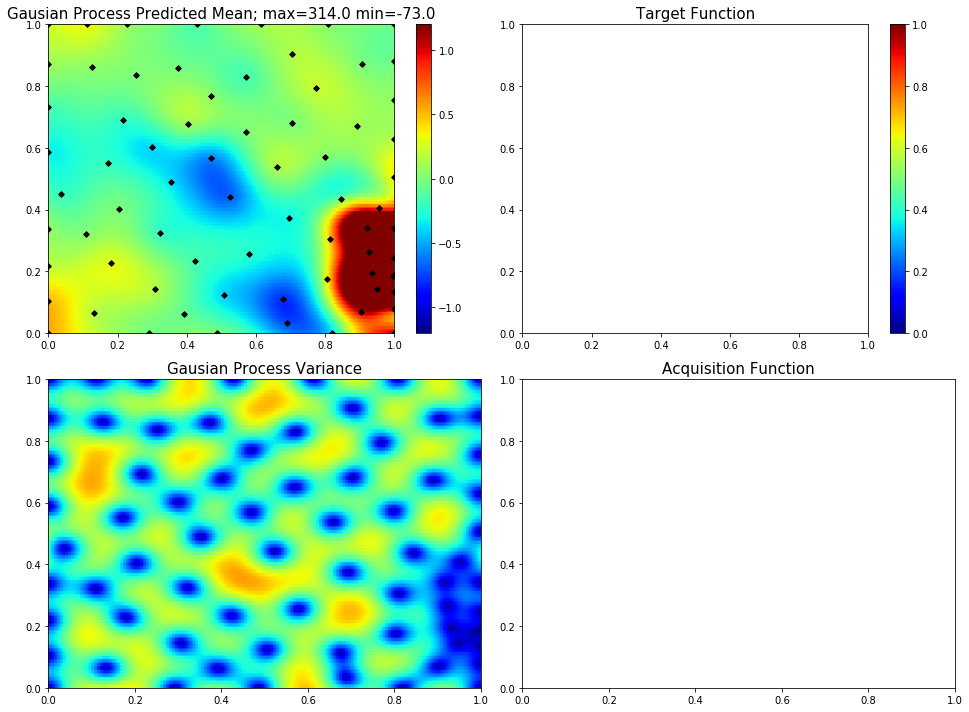

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6789720135825404, 0.10174388840115571]
34  Evaluations Remaining
|  72       | -0.09601  |  0.679    |  0.1017   |
myplot:  072


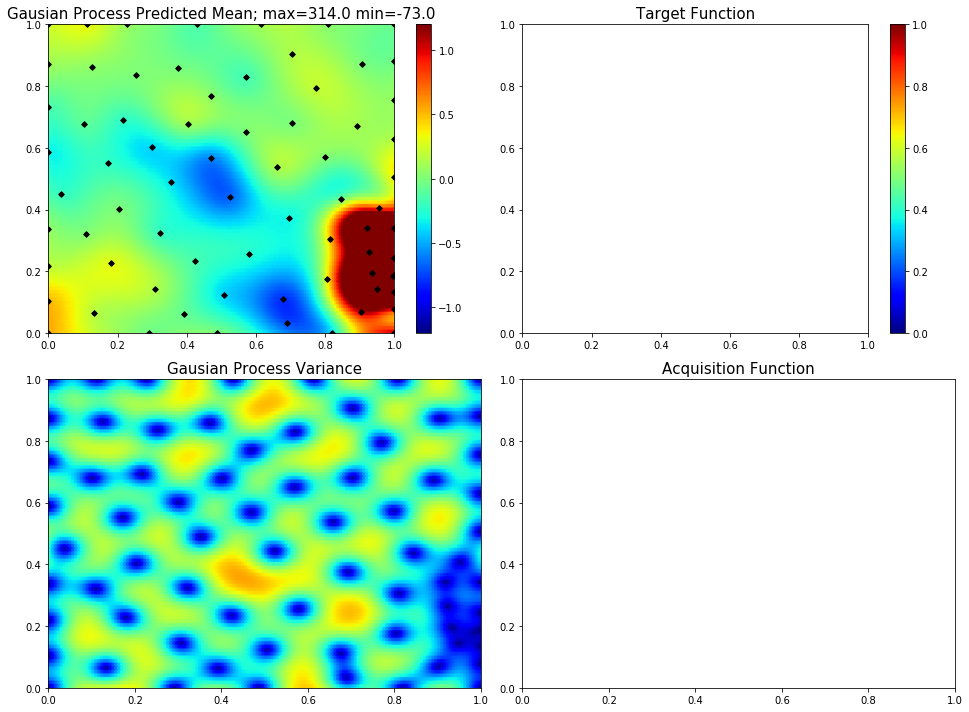

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9218798649684857, 0.5084391919516126]
33  Evaluations Remaining
|  73       |  0.01108  |  0.9219   |  0.5084   |
myplot:  073


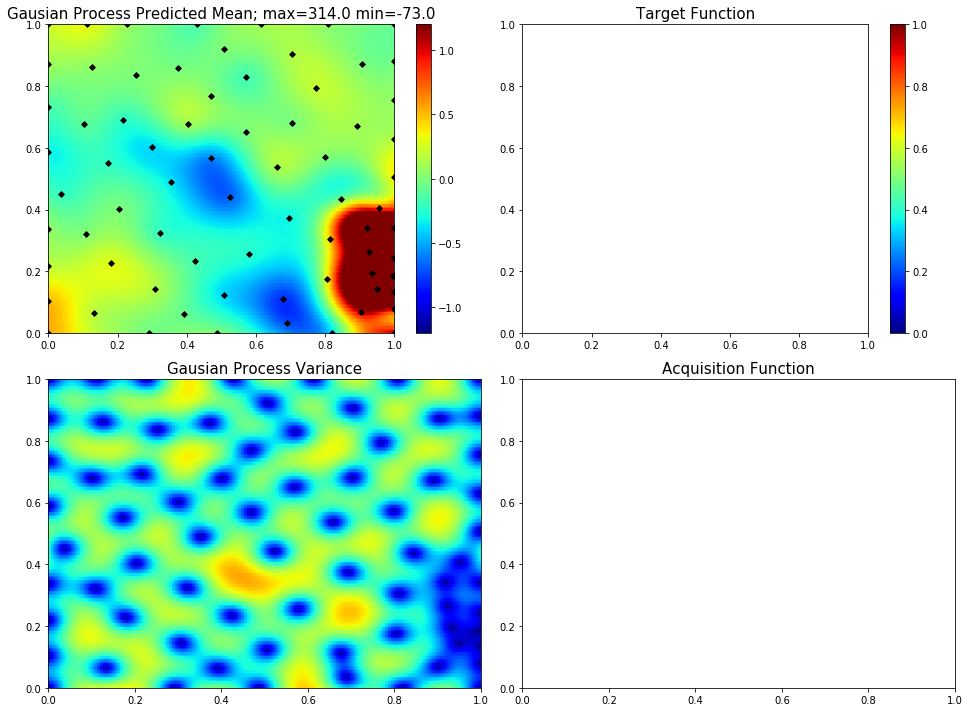

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.35192099158524526, 0.44717539386623634]
32  Evaluations Remaining
|  74       | -0.5739   |  0.3519   |  0.4472   |
myplot:  074


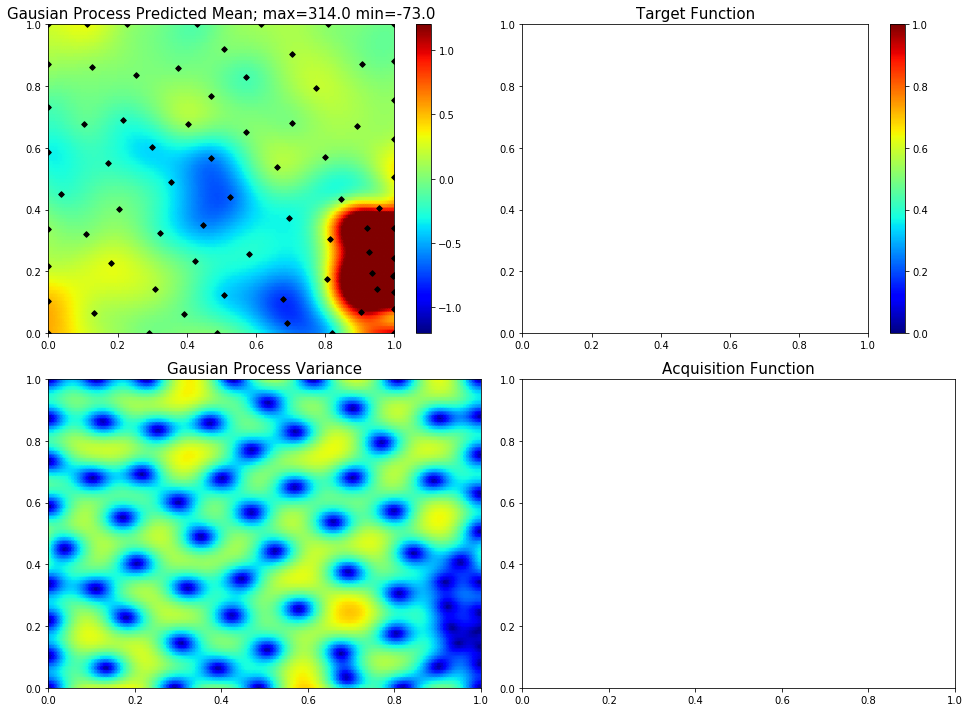

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16818760014695777, 0.09507810321235899]
31  Evaluations Remaining
|  75       |  0.2962   |  0.1682   |  0.09508  |
myplot:  075


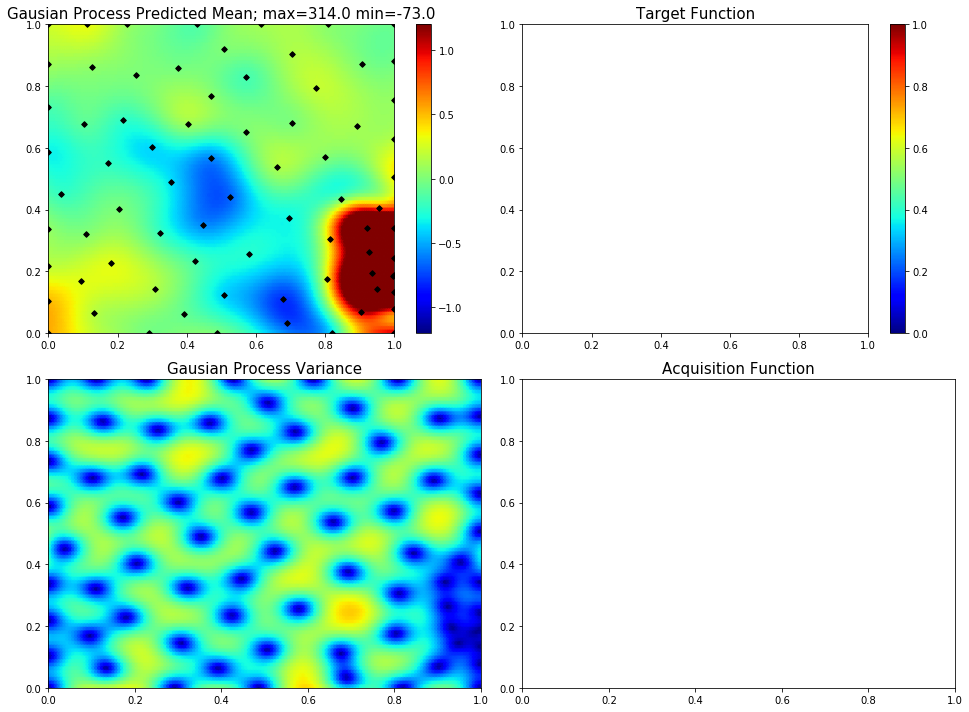

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.5907644740687131]
30  Evaluations Remaining
|  76       | -0.2085   |  0.0      |  0.5908   |
myplot:  076


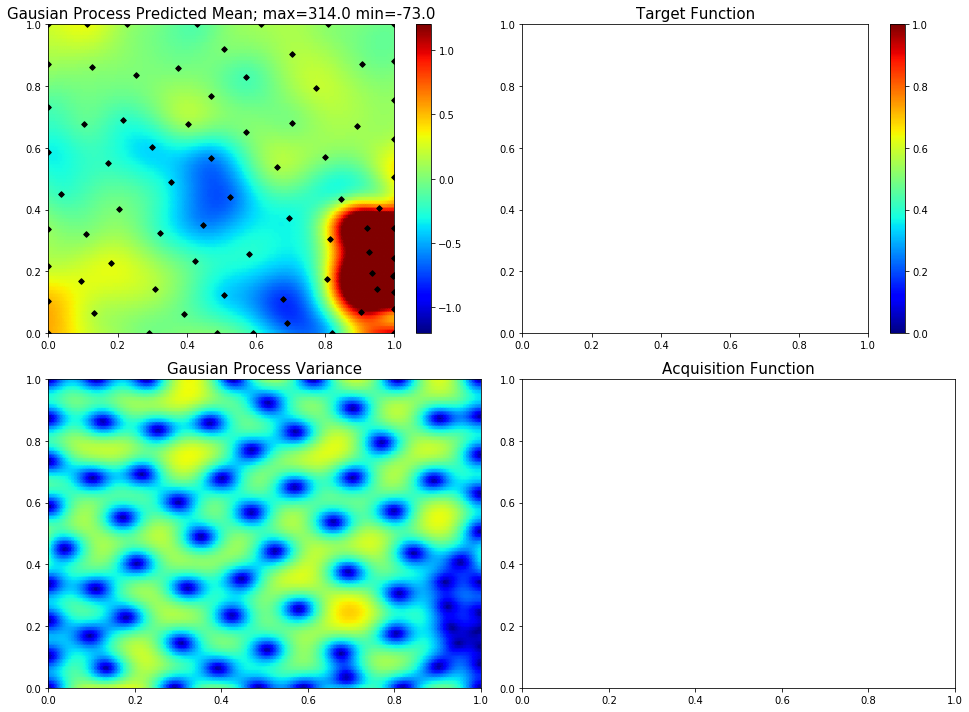

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7502507141332826, 0.32714853181614517]
29  Evaluations Remaining
|  77       |  0.0493   |  0.7503   |  0.3271   |
myplot:  077


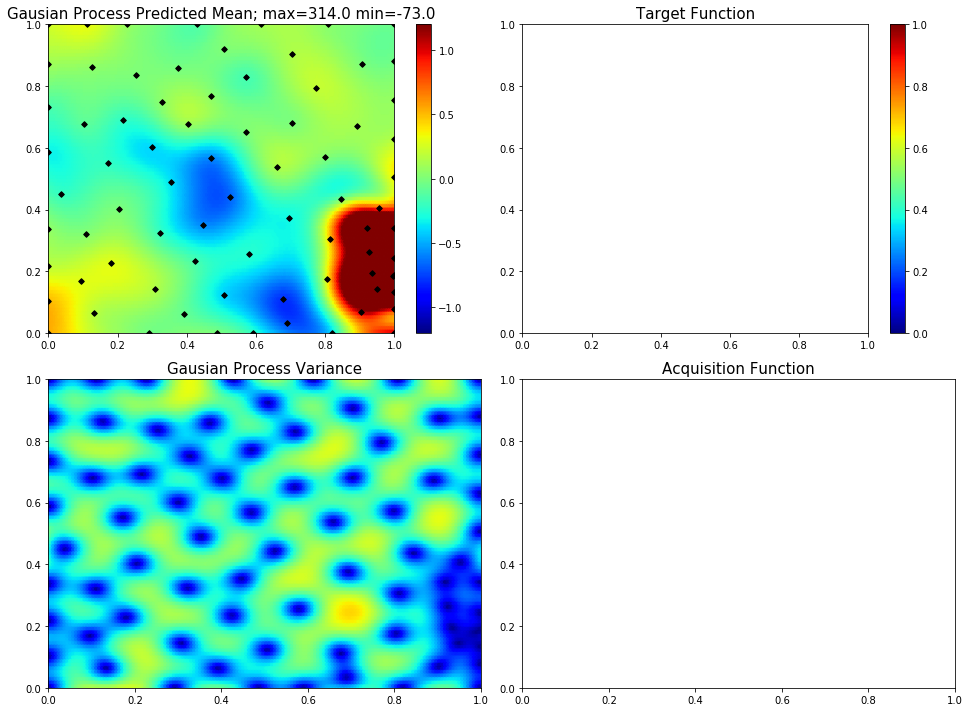

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.24812719198185987, 0.6993294583368564]
28  Evaluations Remaining
|  78       | -0.6995   |  0.2481   |  0.6993   |
myplot:  078


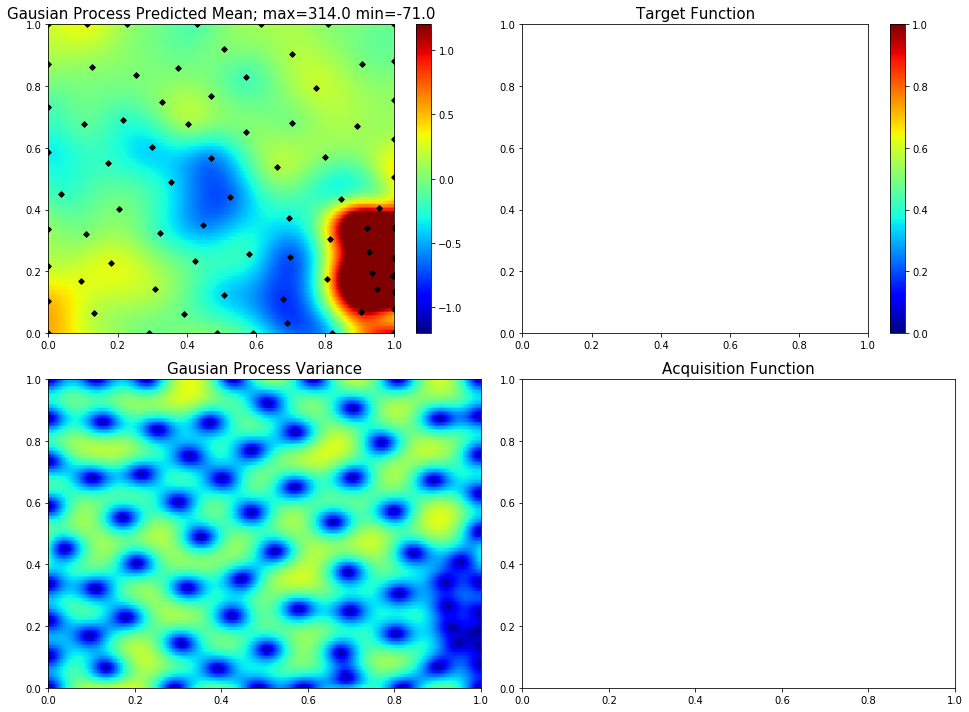

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.3266016760427336]
27  Evaluations Remaining
|  79       | -0.2303   |  1.0      |  0.3266   |
myplot:  079


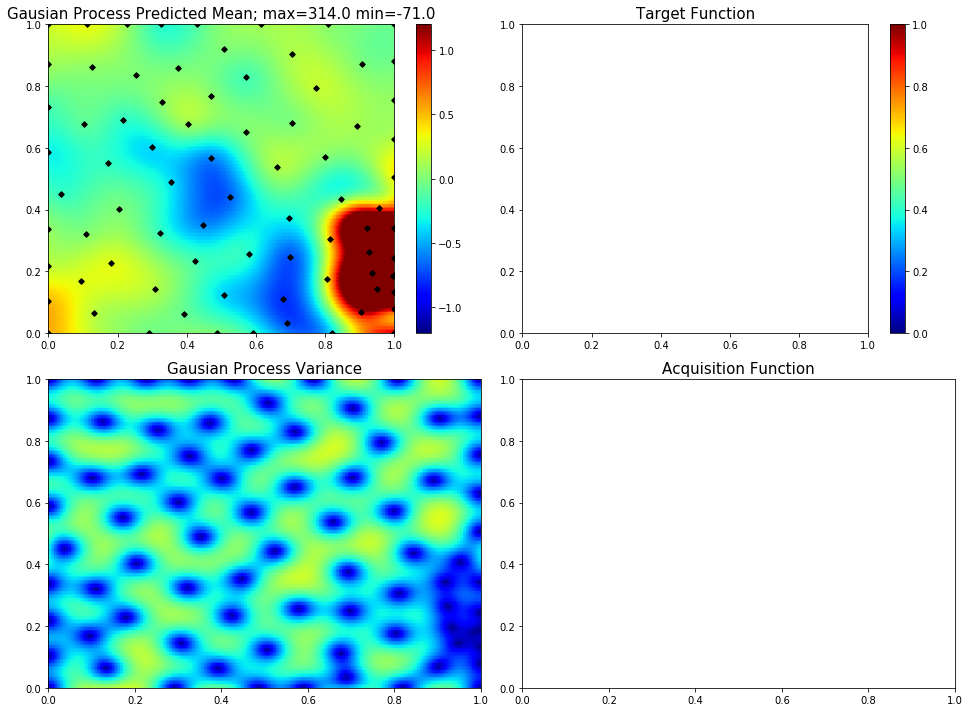

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.18338782468184764]
26  Evaluations Remaining
|  80       |  0.2465   |  0.0      |  0.1834   |
myplot:  080


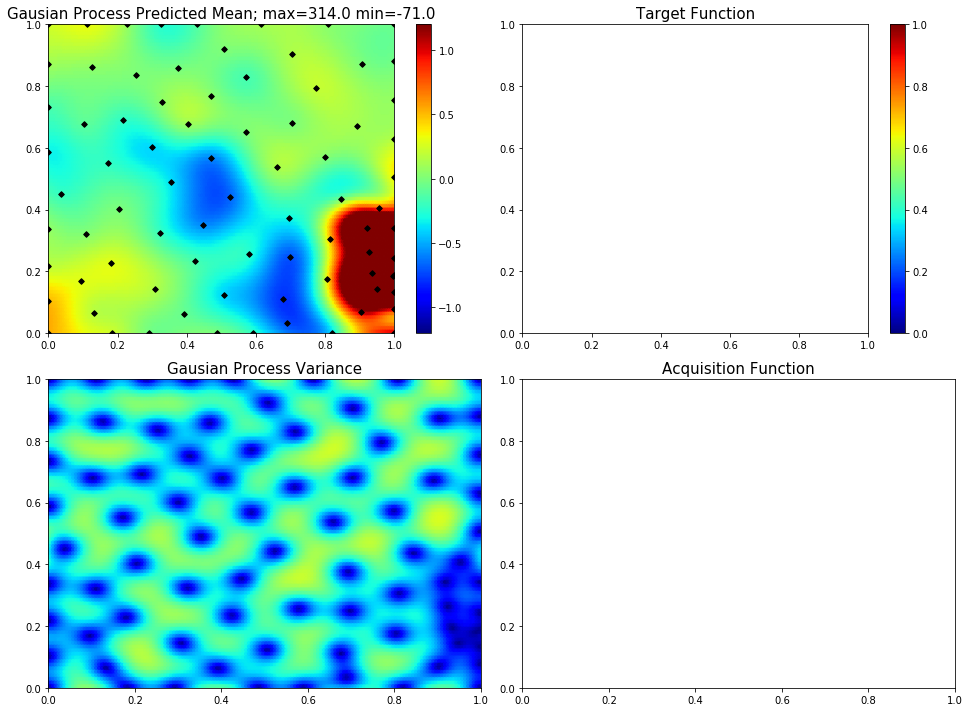

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5550381412742833, 0.9092837411216086]
25  Evaluations Remaining
|  81       |  0.1874   |  0.555    |  0.9093   |
myplot:  081


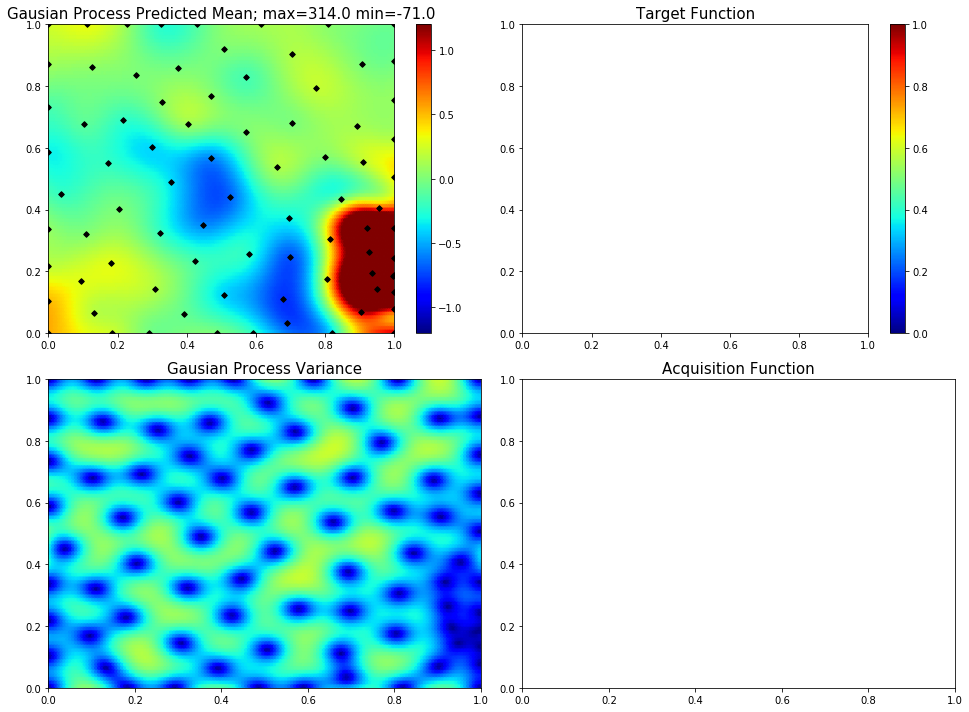

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1573145185640497, 0.8907977820561478]
24  Evaluations Remaining
|  82       |  3.172    |  0.1573   |  0.8908   |
myplot:  082


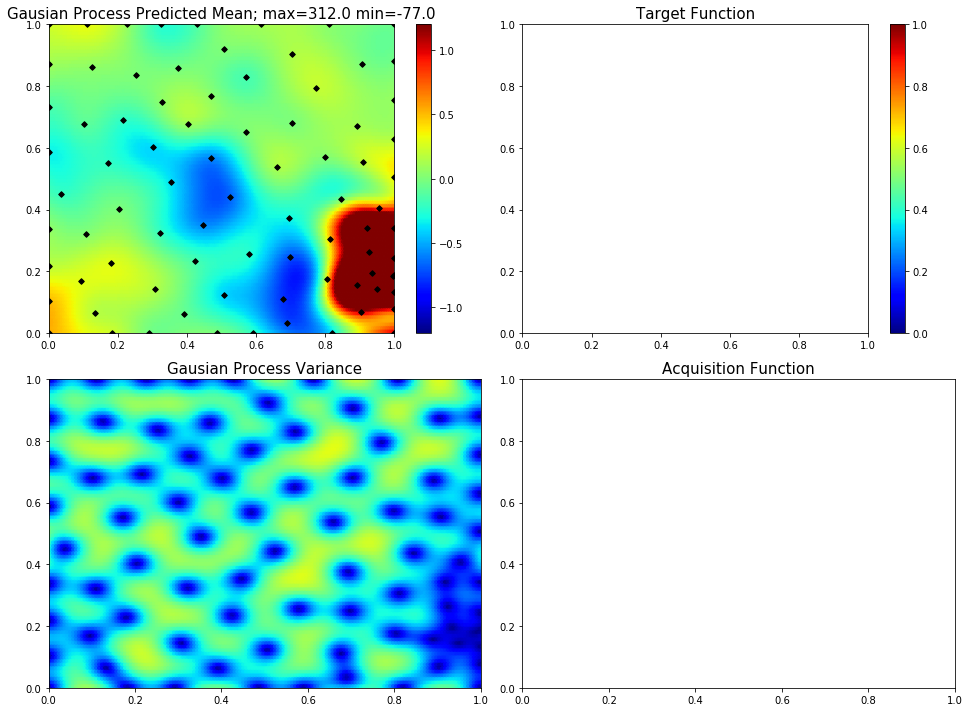

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.29387838947029254, 0.9768077828589938]
23  Evaluations Remaining
|  83       |  2.26     |  0.2939   |  0.9768   |
myplot:  083


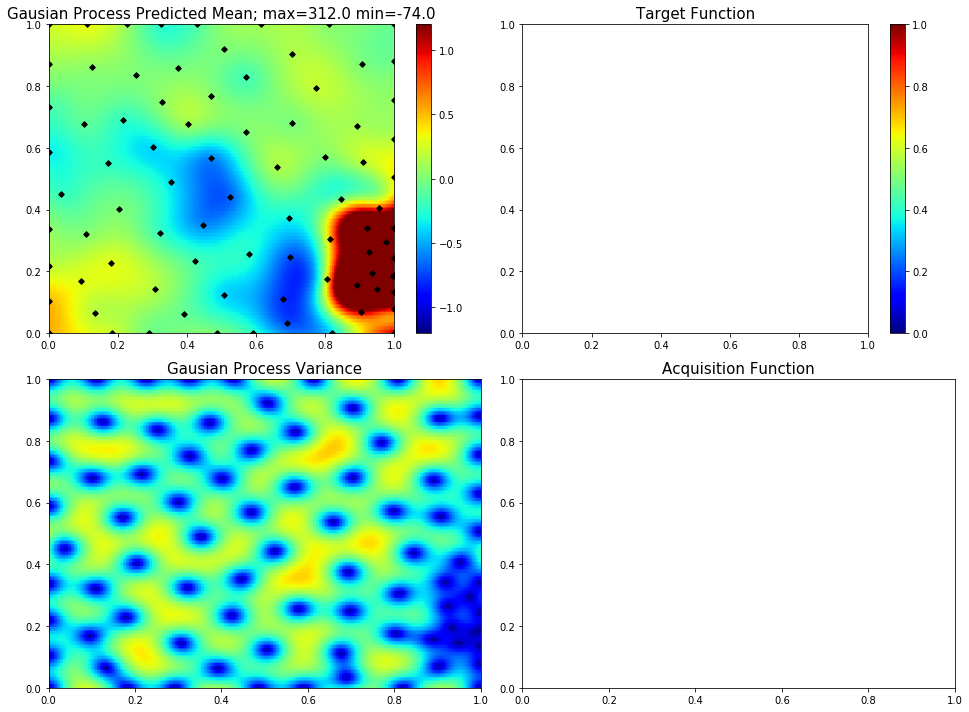

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.21605180840179466, 0.8745543217839257]
22  Evaluations Remaining
|  84       |  0.33     |  0.2161   |  0.8746   |
myplot:  084


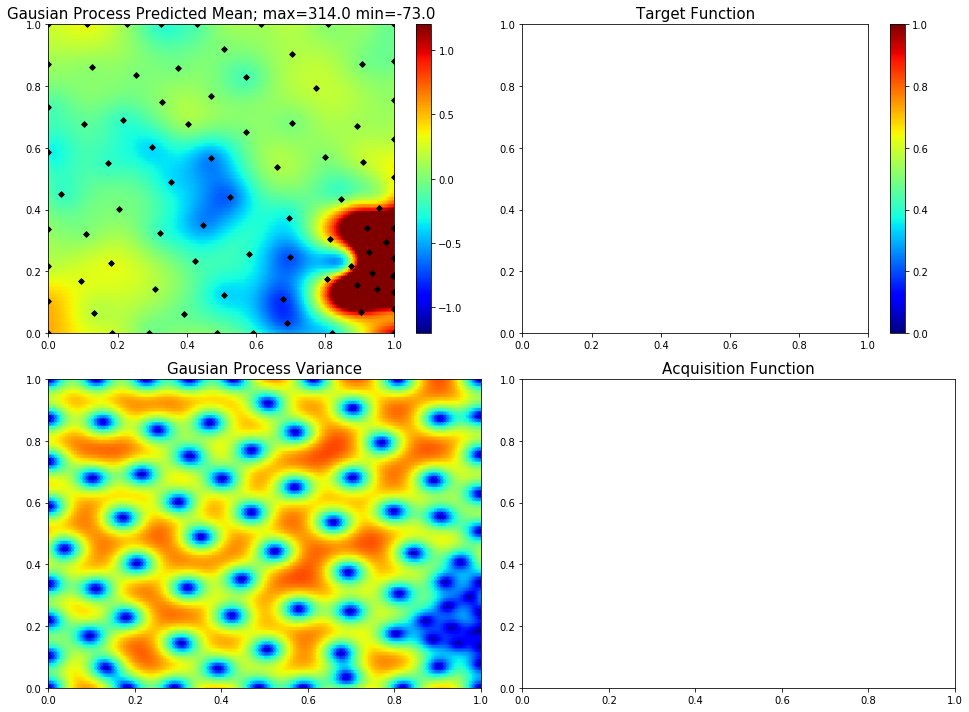

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7787688220441312, 0.6628299887457215]
21  Evaluations Remaining
|  85       |  0.269    |  0.7788   |  0.6628   |
myplot:  085


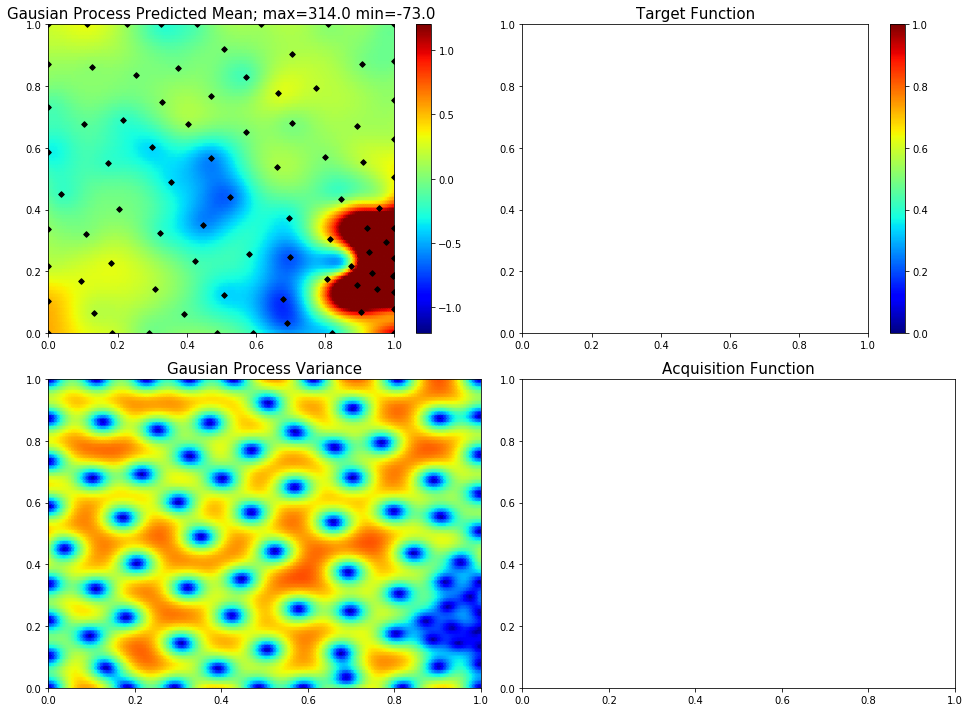

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.10277610748622695, 0.8332411311868211]
20  Evaluations Remaining
|  86       | -0.3338   |  0.1028   |  0.8332   |
myplot:  086


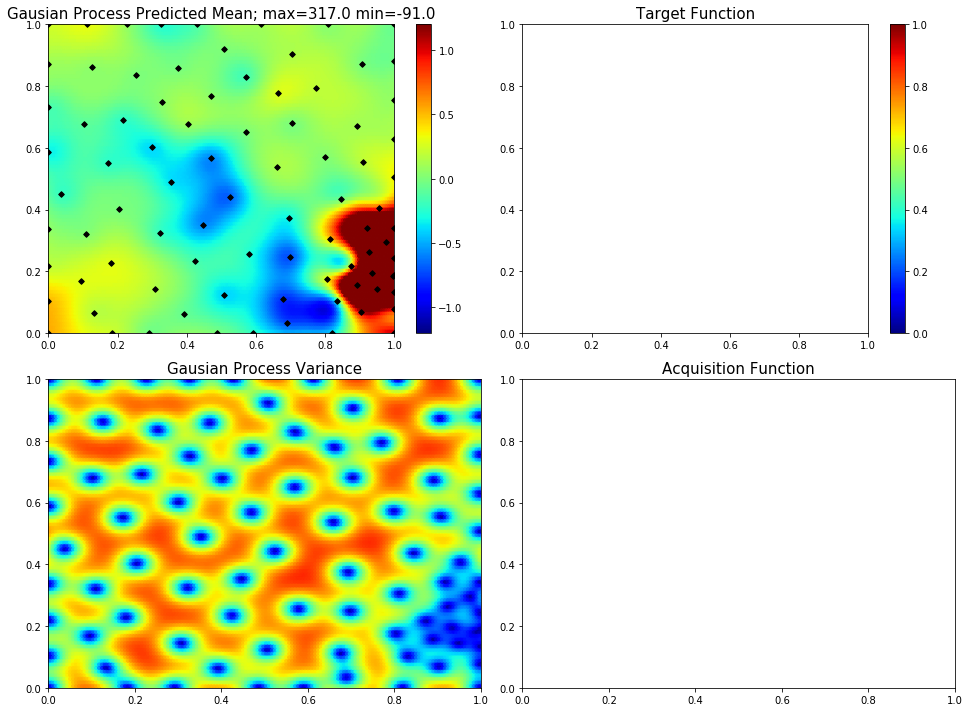

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.22428430394795712, 0.967861958911152]
19  Evaluations Remaining
|  87       |  3.273    |  0.2243   |  0.9679   |
myplot:  087


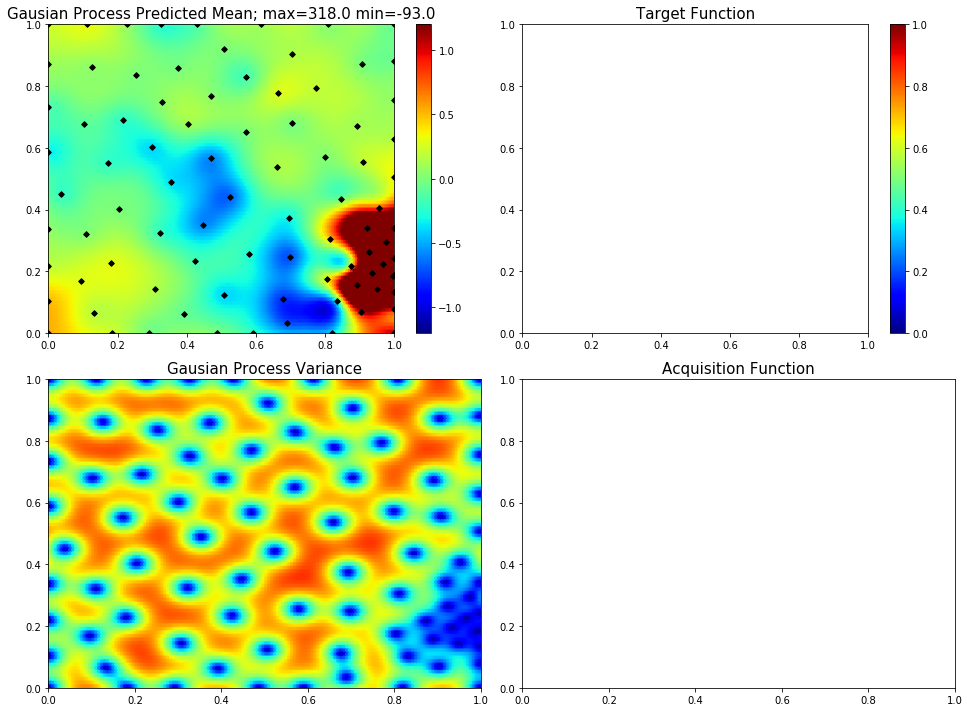

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.13277492261539436, 0.912173223931532]
18  Evaluations Remaining
|  88       |  3.245    |  0.1328   |  0.9122   |
myplot:  088


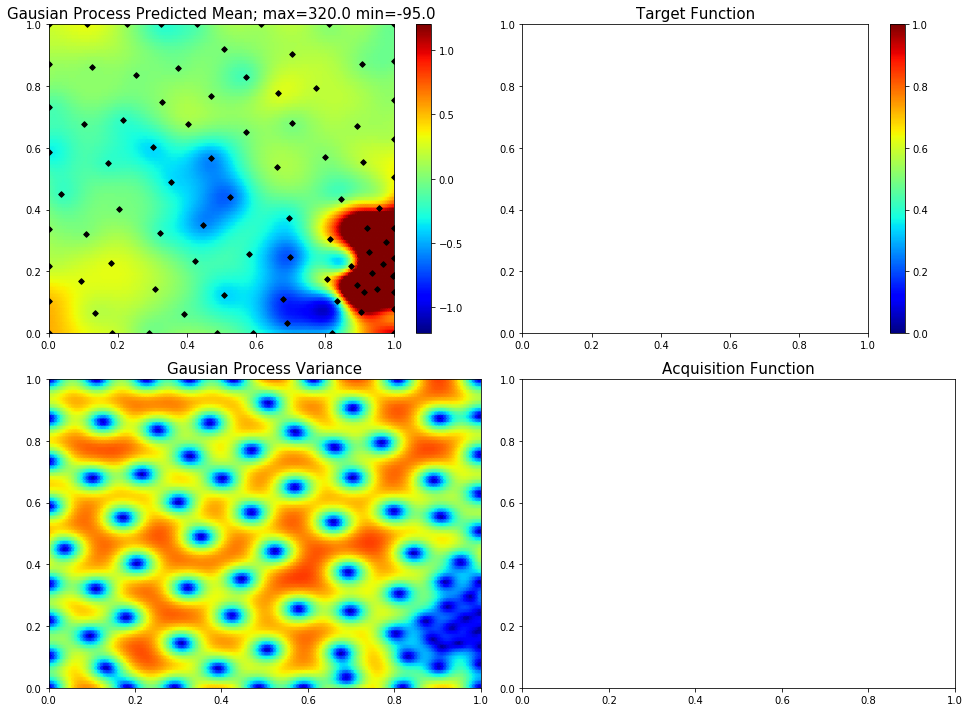

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16247334610522232, 0.9218734593094728]
17  Evaluations Remaining
|  89       |  3.179    |  0.1625   |  0.9219   |
myplot:  089


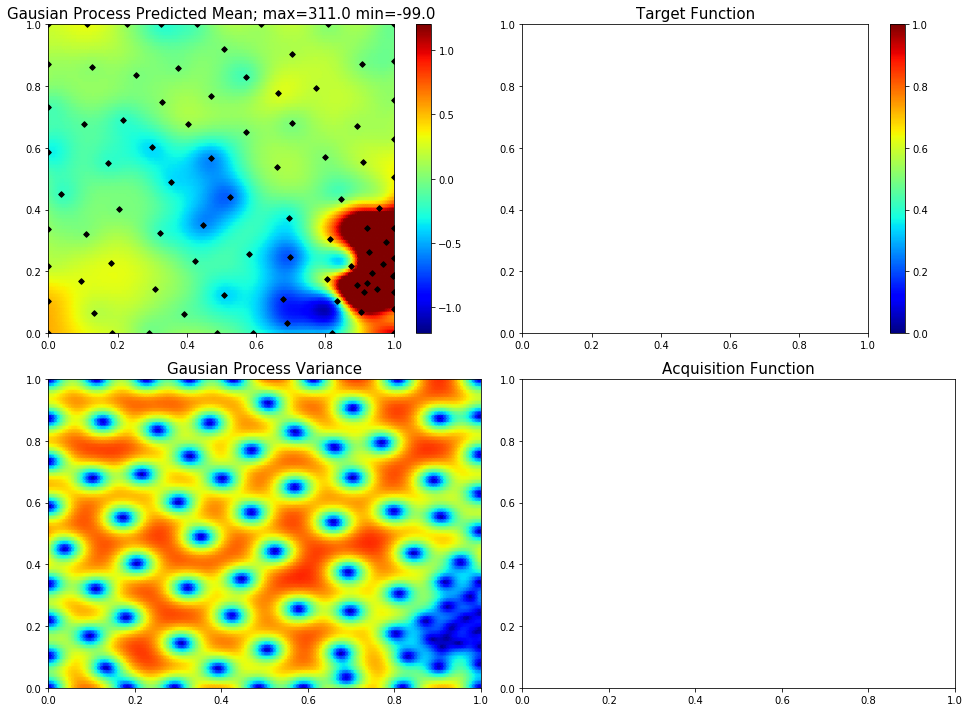

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.12364988581487663, 0.2118073687642339]
16  Evaluations Remaining
|  90       |  0.2185   |  0.1236   |  0.2118   |
myplot:  090


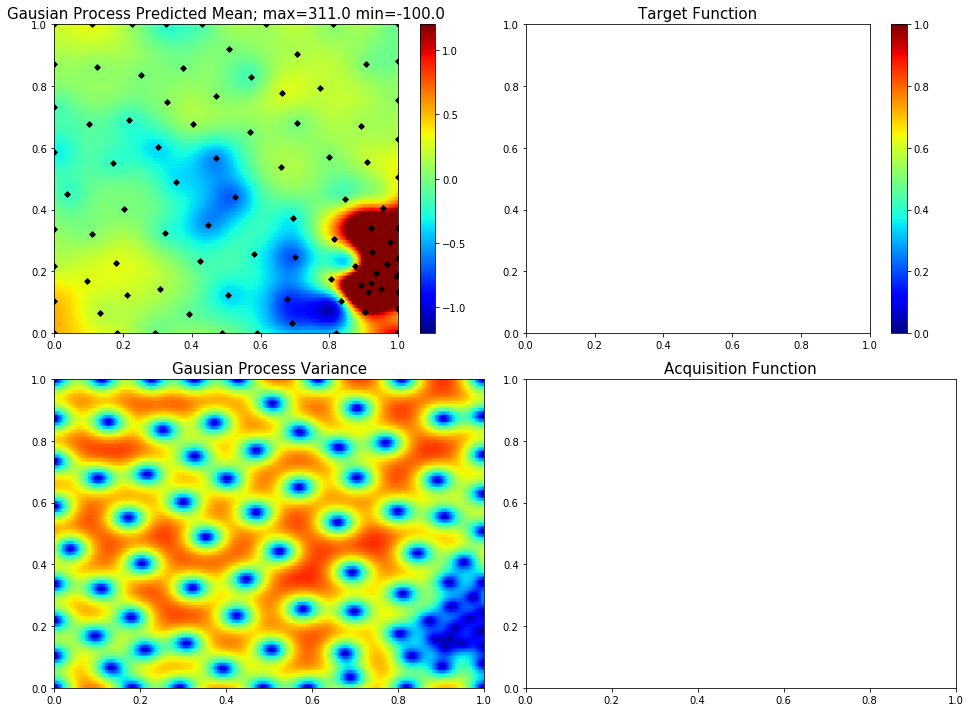

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.772513176059742, 0.8763558265086603]
15  Evaluations Remaining
|  91       | -0.135    |  0.7725   |  0.8764   |
myplot:  091


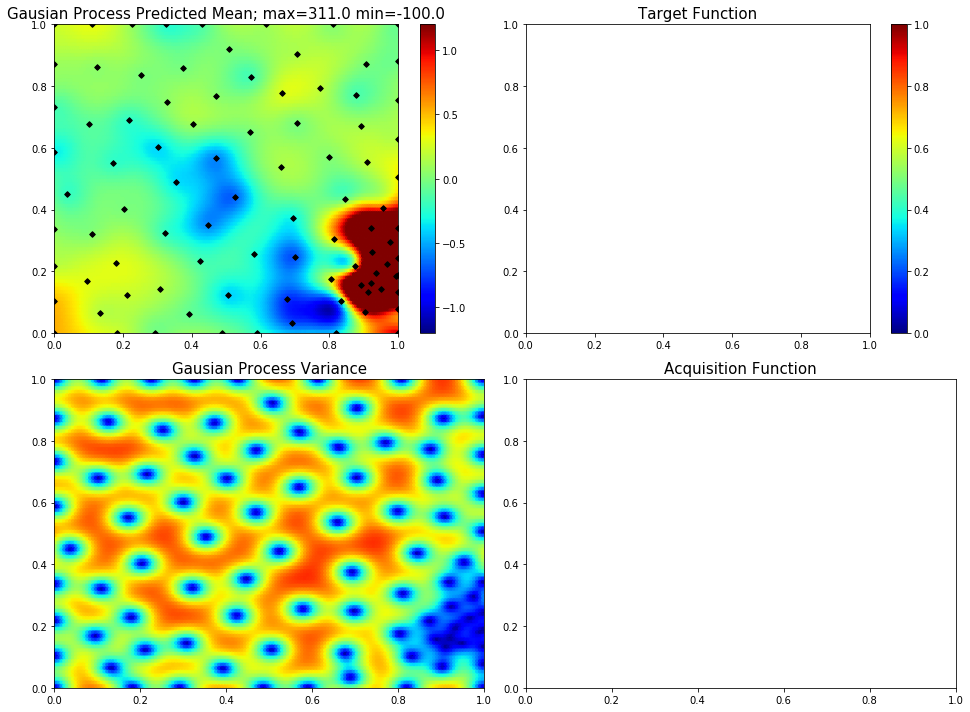

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.903971732121415]
14  Evaluations Remaining
|  92       | -0.1941   |  1.0      |  0.904    |
myplot:  092


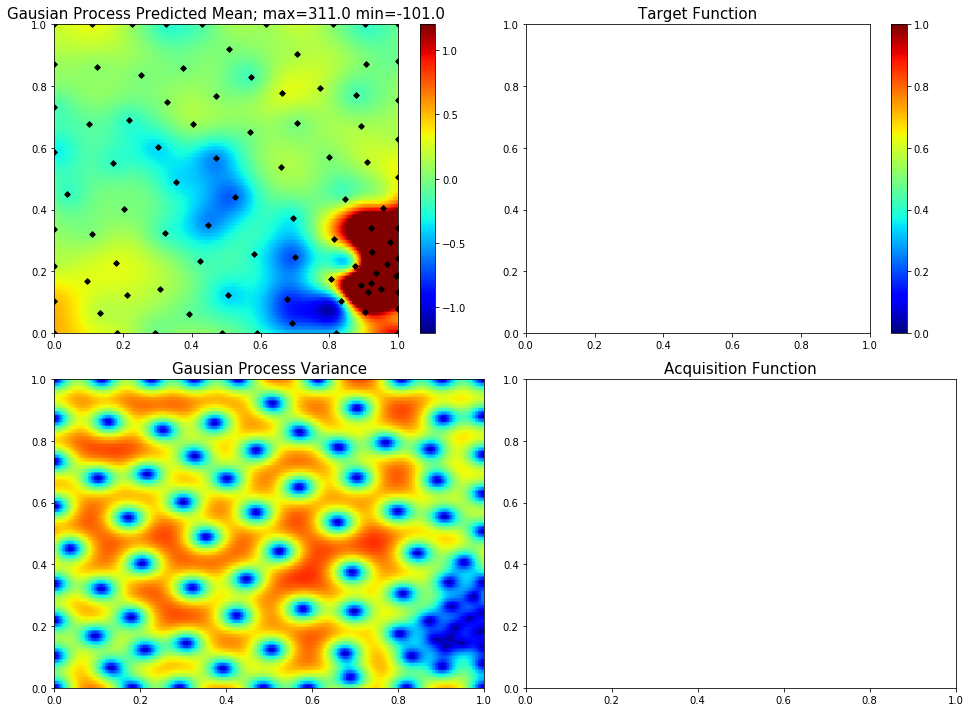

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3504528609458131, 0.8698588325788602]
13  Evaluations Remaining
|  93       |  0.3834   |  0.3505   |  0.8699   |
myplot:  093


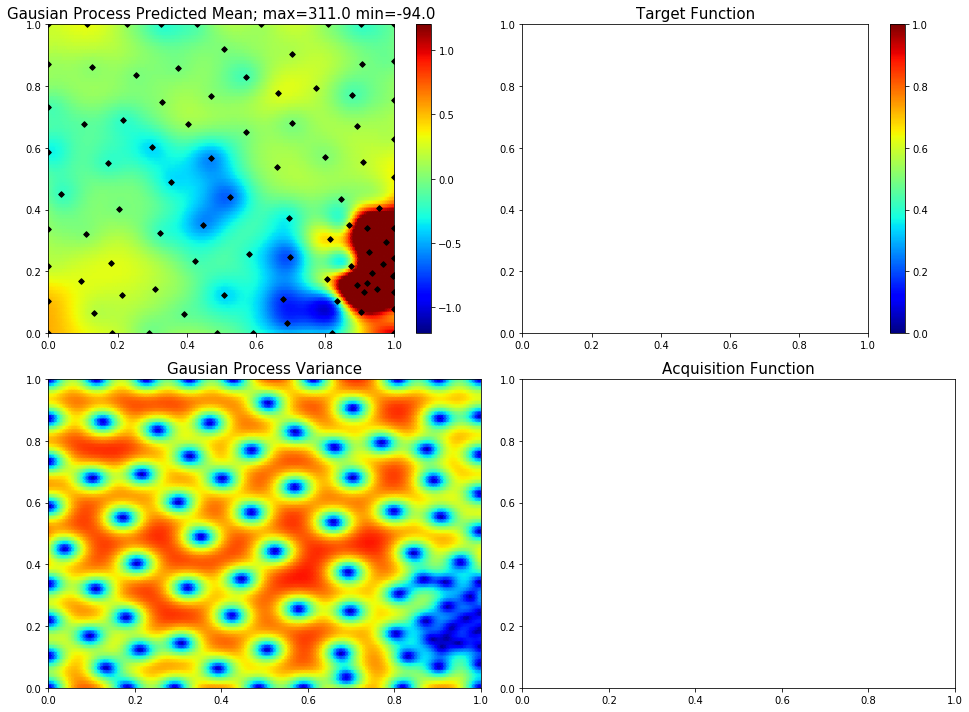

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.47485160022584694, 0.744539417068406]
12  Evaluations Remaining
|  94       | -0.2554   |  0.4749   |  0.7445   |
myplot:  094


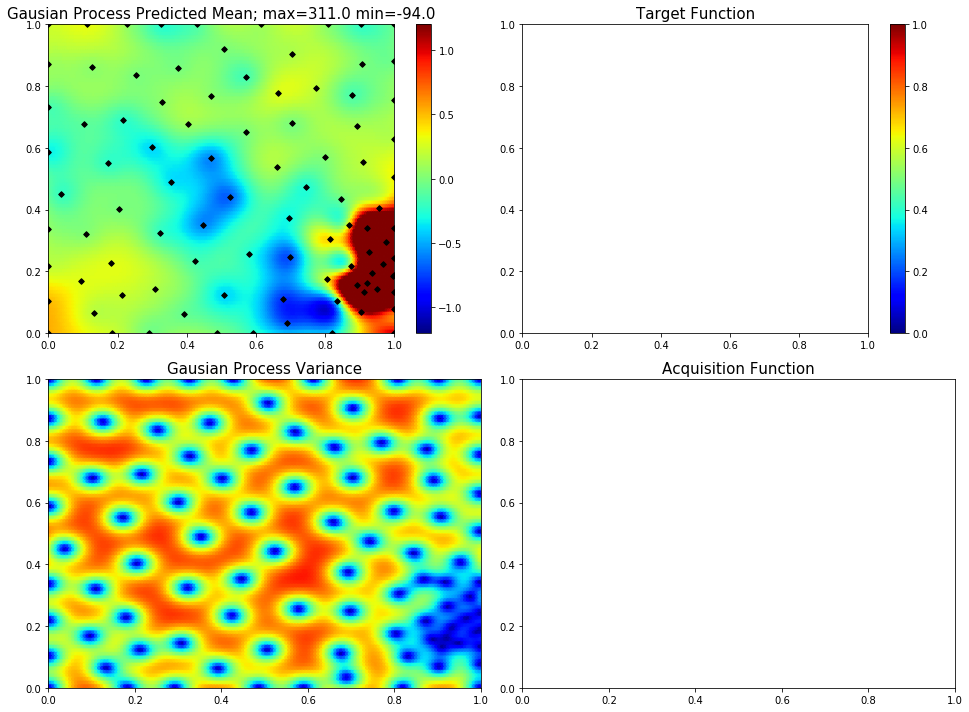

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.18399736441347544, 0.9610020276132939]
11  Evaluations Remaining
|  95       |  3.272    |  0.184    |  0.961    |
myplot:  095


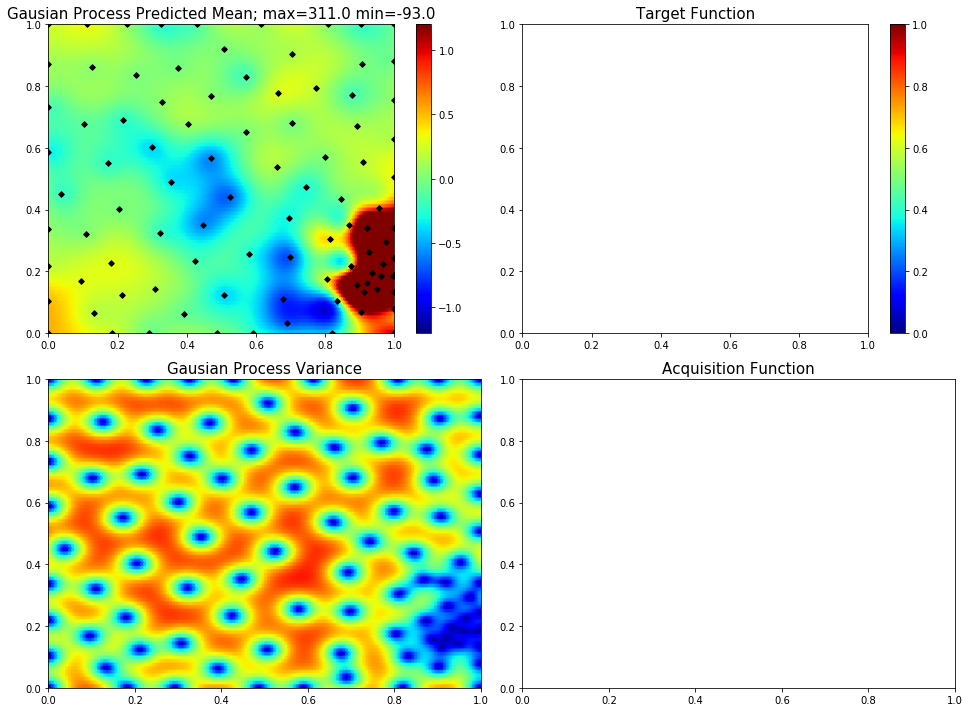

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.15896465079759342, 1.0]
10  Evaluations Remaining
|  96       |  3.191    |  0.159    |  1.0      |
myplot:  096


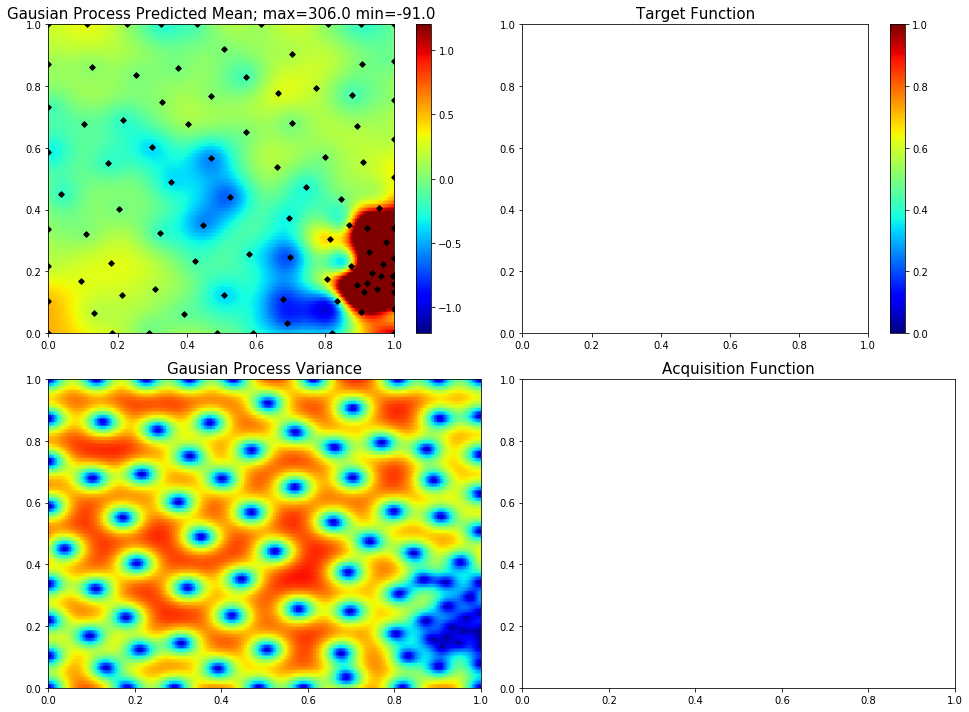

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.21675633564726063, 0.99371125078866]
9  Evaluations Remaining
|  97       |  3.404    |  0.2168   |  0.9937   |
myplot:  097


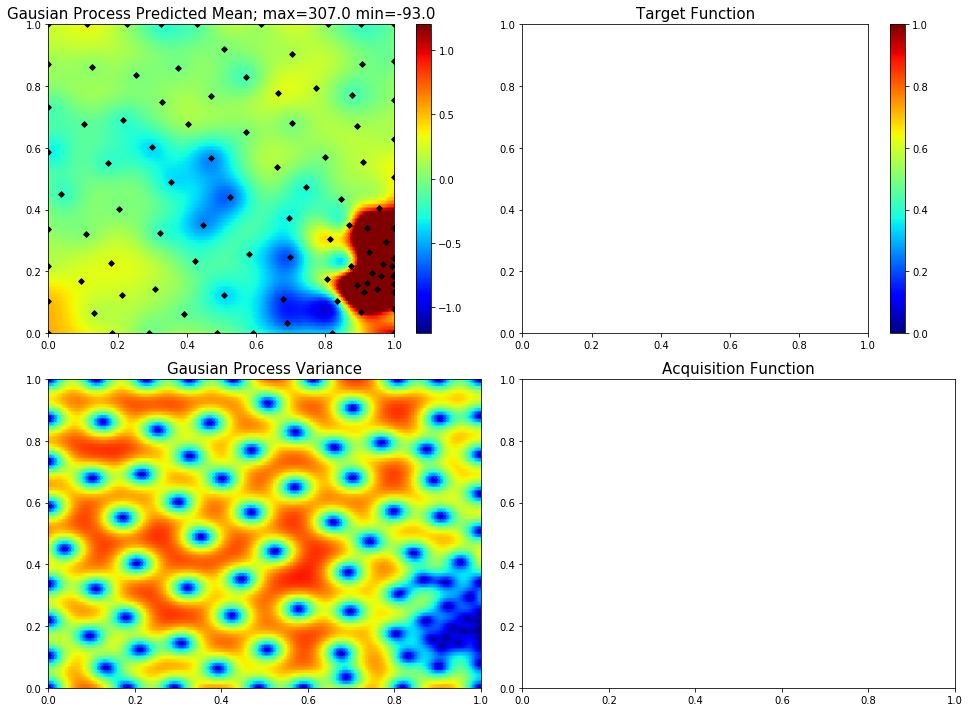

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.14231107687624367, 0.9785041120601293]
8  Evaluations Remaining
|  98       |  3.216    |  0.1423   |  0.9785   |
myplot:  098


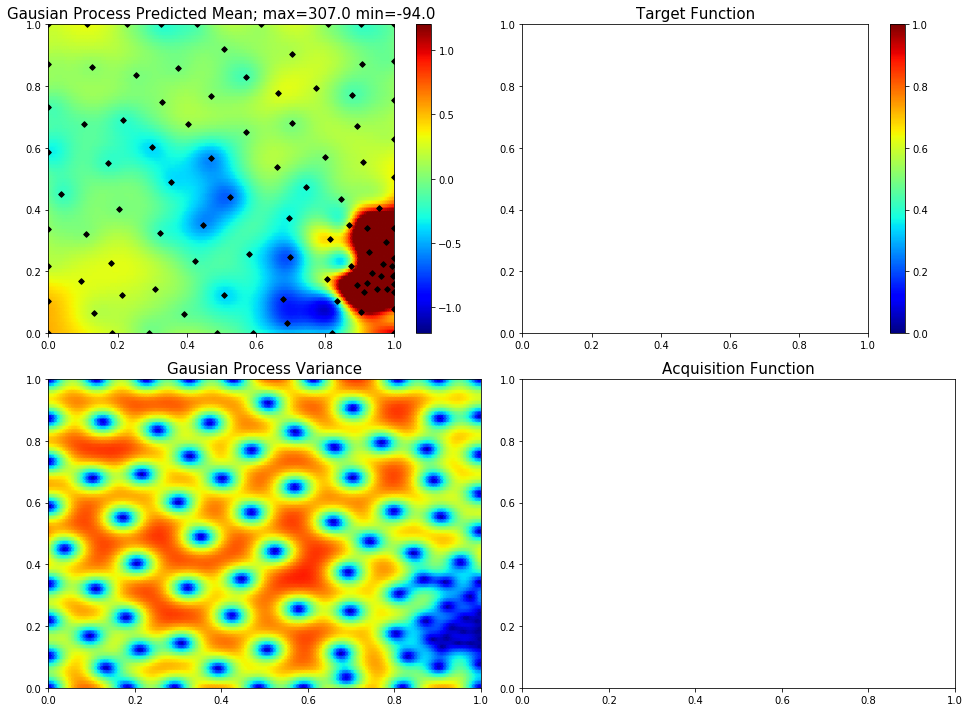

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2028177959041836, 0.9767485462265227]
7  Evaluations Remaining
|  99       |  3.281    |  0.2028   |  0.9767   |
myplot:  099


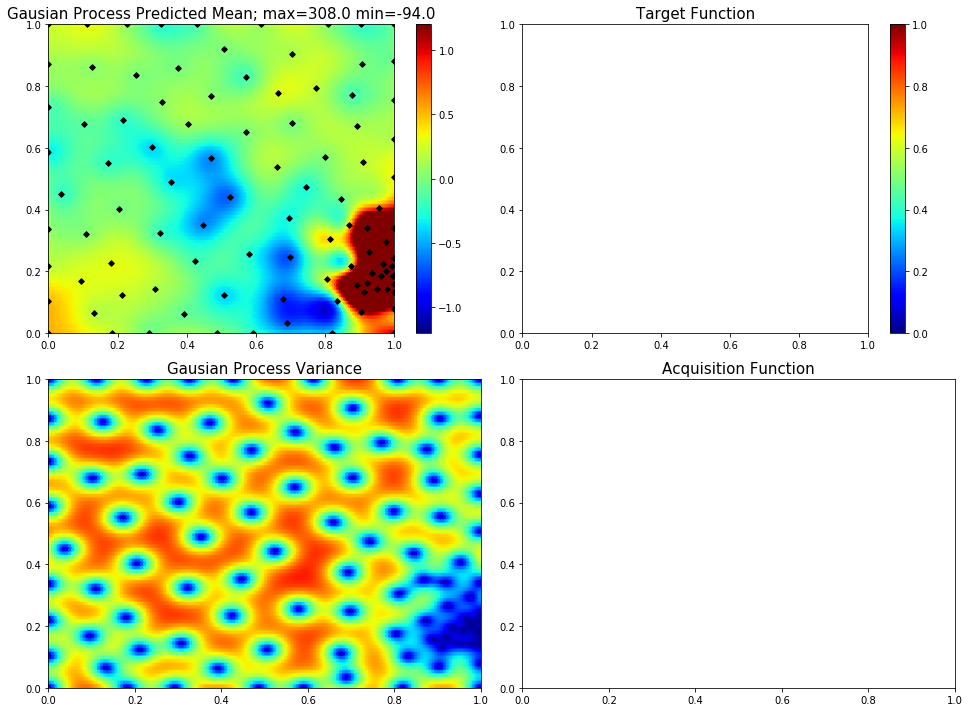

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.33861887554620407, 0.9547152561126545]
6  Evaluations Remaining
|  100      |  2.354    |  0.3386   |  0.9547   |
myplot:  100


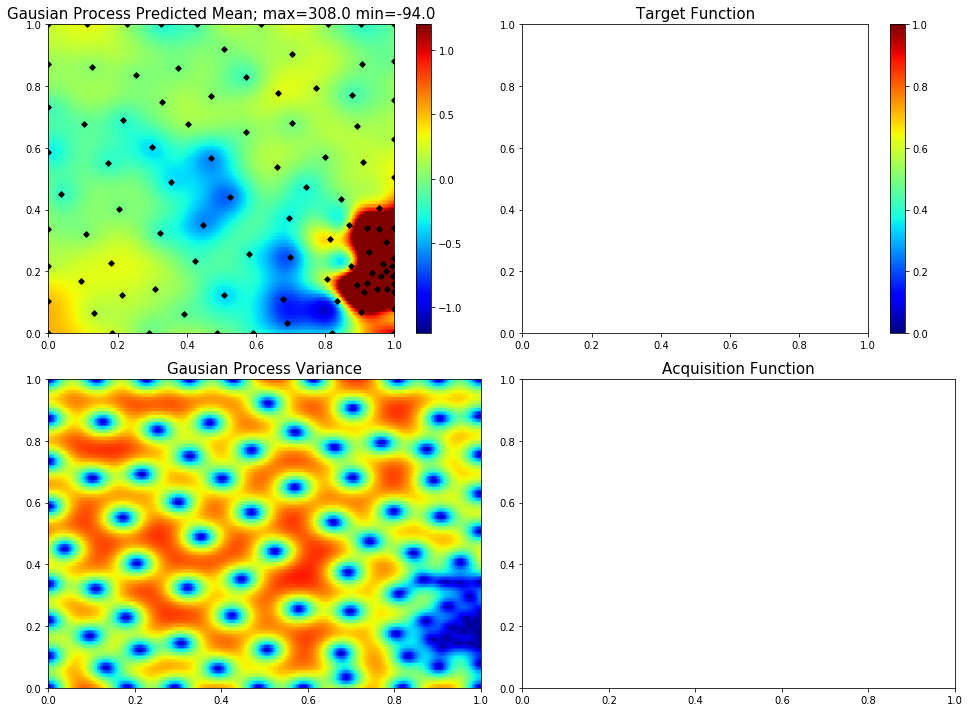

In [9]:
# Turn interactive plotting off
plt.ioff()
#policy =  [ [0.9991712478009906, 0.026881743252439638], [0.19702391566063626, 0.8142634903489118], [0.02287582405055888, 0.6499711714347374], [0.9944402045090077, 0.017507068898582667], [0.7295230492436623, 0.9926887775501024] ]

for i in range(95):
    bo.maximize(init_points=0, n_iter=1, acq='ucb', kappa=used_kappa)
    print("myplot: ", "{:03}".format(len(bo.space)) )
    plot_2d("{:03}".format(len(bo.space)))
    
    
    #invRL_score = invRL(policy)
    #if (i % 20 == 1 ): 
        #test_score = testHolePolicy(policy)
        #print("diff = ", invRL_score*90.0 - test_score)
    if (i==53):
        used_kappa = 8
    if (i==75):
        used_kappa = 7
    if (i==80):
        used_kappa = 5
    if (i==88):
        used_kappa = 3
        

In [10]:
def myRandom():
    return rand.random() # return round(rand.random(), 2)# TODO: remove this round thig # TODO run it more 

def GetRandPolicy():
    policy=[]
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()]) 
    return policy


evolution = []
policies = []
maxReward= 0.0
nbTestedPolicy = 0


In [11]:
for _ in range(50000):
    if (nbTestedPolicy % 1000 == 0 ):
        print('nbTestedPolicy',nbTestedPolicy)
    nbTestedPolicy += 1
    
    policy = {}
    policy['nwemer'] = GetRandPolicy()
    with suppress_stdout():
        potentialReward = invRL(policy['nwemer'])
    if np.sum(potentialReward)<maxReward*0.9: continue
    print(policy)
        

    policy['AvgReward'] = np.mean(potentialReward)
    policy['maxRewards'] = np.max(potentialReward)
    policy['totRewards'] = np.sum(potentialReward)
    policy['Rewards'] = potentialReward
    policies.append(policy)



    policies.sort(key=lambda r: -r['totRewards'])
    evolution.append(policies[0]['AvgReward'])
    maxReward=policies[0]['totRewards']
    print("##################################################################")
    clear_output()
    
    print('totRewards',round(policies[0]['totRewards']))
    print('rewards',policies[0]['AvgReward'])
    print('maxRewards',round(policies[0]['maxRewards']))
    print('nbTestedPolicy',nbTestedPolicy)
    
    
    if len(policies)>10: 
        policies = policies[0:9]
    print(policies)
    print("##################################################################")
    print(evolution)

nbTestedPolicy 0


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [ ]:
print('totRewards',policies[0]['totRewards'])
print('rewards',policies[0]['AvgReward'])
print('maxRewards',policies[0]['maxRewards'])
print('nbTestedPolicy',nbTestedPolicy)
policies[0]

In [ ]:
plot_2d()

In [ ]:
envSeqDec = ChallengeSeqDecEnvironment()

#policy =  [ [0.9991712478009906, 0.026881743252439638], [0.19702391566063626, 0.8142634903489118], [0.02287582405055888, 0.6499711714347374], [0.9944402045090077, 0.017507068898582667], [0.7295230492436623, 0.9926887775501024] ]
policy = [[0.31328663818396973, 0.9776861325195532],
  [0.07206449061138168, 0.011854559756869415],
  [0.015001307755673127, 0.7824223824506427],
  [0.3448629245009954, 0.07300768816008919],
  [0.04056924624498471, 0.27620473268585843]]
policy= [[0.017363777900124777, 0.8479028716329575], [0.7961740200410486, 0.0384155626867467], [0.0007479541597428817, 0.784541637169782], [0.6168483799846353, 0.12921609525220837], [0.07021082750169359, 0.8135289568164947]]
policy=[[0.0014498060608478802, 0.7901454626026162], [0.6791898353834519, 0.0912706440317113], [0.02393225621723486, 0.772009761068695], [0.897451024460483, 0.019135270067331032], [0.07942440232028156, 0.8954976621776467]]
policy=[[0.06532976733282991, 0.8687345318407067], [0.4865239879760457, 0.11761979547307863], [0.02449963006843666, 0.7640924632117153], [0.9418943242247545, 0.0012583247711476753], [0.05601557278101282, 0.7674708685872119]]
invRL_score,_ = invRL(policy)
test_score,_ = testHolePolicy(policy)
#print("diff = ", invRL_score*90.0 - test_score)

print("expected = ", np.sum(invRL_score)," found= ", np.sum(test_score)  )
#invRL_score - test_score
print("diff = ", [ abs(x - y) for x,y in zip(invRL_score,test_score) ]  )
print("diff = ", np.sum([ abs(x - y) for x,y in zip(invRL_score,test_score) ]  ) ) 